In [398]:
from data_reader_writer import * 
import data_process as dp
from cluster import * 

import itertools as it
import pandas as pd
import numpy as np
from sklearn.cluster import SpectralBiclustering, SpectralCoclustering
from collections import defaultdict
from itertools import groupby
from heapq import nsmallest

from sklearn.decomposition import TruncatedSVD
from sklearn.manifold import TSNE

import seaborn as sns
import matplotlib.pyplot as plt
from scipy.stats import spearmanr
import importlib

from math import ceil

%matplotlib inline
# %load_ext autoreload
# %autoreload 2

In [401]:
# %load_ext autoreload
# %autoreload 2
# # os.chdir(PROJECT_DIR)
# import cluster
# importlib.reload(cluster)
from cluster import * 

In [3]:
ephys_data = load_ephys_data()
gamble_choices = load_gamble_choices_data()
behavior_data = load_behavior_data()
regressor_data = load_regressor_data()

In [147]:
elec_nrs_outcome = {'s1': [3, 5], 's2': [4, 6], 's3': [2, 6, 19, 22, 24, 26, 29, 31, 35, 38, 41, 43, 44], 's4': [2, 5], 
            's5': [12, 20, 27, 32, 36, 38, 53], 's6': [5, 6, 7], 's7': [1, 4, 5, 6, 10], 's8': [3, 6, 7, 9], 
            's9': [1, 2, 3, 4, 5, 6, 7, 8, 10, 11, 13, 14, 15, 18], 's10': [3, 7, 9, 14, 16]}

In [148]:
elec_nrs_gamebtn = {'s1': [2, 3, 5], 's2': [2, 5, 6], 's3': [2, 6, 10, 19, 20, 23, 37, 38, 41, 46, 51], 's4': [1, 3, 5], 
              's5': [15, 20, 24, 36, 47, 54, 56], 's6': [1, 7], 's7': [1, 2, 5, 11], 's8': [1, 3, 6, 8, 9, 10], 
              's9': [1, 9, 10, 12], 's10': [9, 11, 16]}

In [52]:
all_datasets = load_var("all_datasets_1")

# Making data

In [6]:
# Time-locks the given ephys trials to [-i1;i2]ms from the outcome reveal
# NB! The ephys data has to be buttonpress_hg!
def time_lock_outcome(ephys_data, behav_data, i1, i2):
    result = []
    experiment = [item for sublist in ephys_data for item in
                  sublist]  # the measurements of the entire experiment in one list
    # should have n_trials x 3001 elements

    for index, row in behav_data.iterrows():
        delay = round((row['reveal.time'] - row['buttonpress.time']) 
                      * 1000)  # the time between buttonpress event and outcome reveal in ms
        outcome_moment = index * 3001 + 1000 + delay  # the buttonpress is 1s = 1000ms from the beginning of the trial
        if outcome_moment + i2 >= len(experiment):
            trial = experiment[outcome_moment - i1:]
        else:
            trial = experiment[outcome_moment - i1:outcome_moment + i2]
        result.append(trial)

    return result

In [7]:
def make_data(s, tw_type, trial_type=ALL, tw_per_electrode=1, elec_nrs=None):
    s_behav = behavior_data[s][behavior_data[s]['trial.included'] == 1]
    s_behav = s_behav.reset_index(drop=True) # so that the indices would be 0, ... , len(s_ephys) - 1
    
    # Pick the correct ephys data
    s_ephys = None
    if tw_type == AFTER_OUTCOME:
        s_ephys = ephys_data[s]['buttonpress_events_hg']
    elif tw_type == GAMEPRES_BUTTONPRESS:
        s_ephys = ephys_data[s]['game_events_hg']
    
    electrodes = None
    if elec_nrs != None:
        electrodes = elec_nrs
    else:
        electrodes = list(range(1, N_ELEC[s] + 1))
        
    n_elec = len(electrodes)
    
    # Get the correct trial indices for the trial type
    trial_indices = None 
    if trial_type == LOSS:
        trial_indices = s_behav[s_behav['outcome'] == 'Loss'].index
    elif trial_type == WIN:
        trial_indices = s_behav[s_behav['outcome'] == 'Win'].index
    elif trial_type == GAMBLE:
        trial_indices = s_behav[s_behav['choice.class'] == 'Gamble'].index
    elif trial_type == ALL:
        trial_indices = s_behav.index
    
    n_trials = len(trial_indices)

    X = np.zeros((n_trials, tw_per_electrode * n_elec))
    if tw_type == AFTER_OUTCOME:
        # For every electrode
        splits = np.array_split(range(1000, 2500), tw_per_electrode)
        for el in electrodes: 
            el_idx = electrodes.index(el)
            # Time-lock the electrode's ephys data to [-1;+1.5]s from the outcome reveal 
            # We use s_behav here because in time_lock_outcome we iterate over the ephys data, which only contains 
            # included trials
            elec_data = time_lock_outcome(ephys_data=dp.extract_electrode_data(s_ephys, el), 
                                          behav_data=s_behav.iloc[trial_indices],
                                          i1=1000, i2=1500)
            for i in range(len(splits)):
                idx = splits[i]
                for j in range(n_trials):  # for every trial
                    row = elec_data[j] 
                    try:
                        elec_avg_tw = np.average(np.array(row)[idx])  # the average of the time window in indices 'idx'
                    except IndexError:
                        elec_avg_tw = np.average(row[idx[0]:]) # if the indices are out of range, take the average of what's left
                        
                    X[j, el_idx * tw_per_electrode + i] = elec_avg_tw  # the j'th trial -> j'th row
                    # tw_per_electrode time windows for every electrode -> an electrode's time windows start at 
                    # el_idx * tw_per_electrode
                    # the i'th time window for an electrode corresponds to the i'th indices in 'splits'
                
    elif tw_type == GAMEPRES_BUTTONPRESS:
        # These are the delays between the buttonpress and game presentation in ms for every trial
        delays = round((s_behav['buttonpress.time'] - s_behav['choice.time']) * 1000)  # the delay for every trial
        delays[delays > 2001] = 2001  # we can't take more than 3001 data points from a trial
        delay_splits = [np.array_split(range(1000, 1000 + int(delays.iloc[i])), tw_per_electrode) 
                        for i in trial_indices]  
        # measurements for every trial

        # For every electrode
        for el in electrodes: 
            el_idx = electrodes.index(el)
            # Extract the data for that electrode
            elec_data = dp.extract_electrode_data(s_ephys, el)
            
            for i in range(tw_per_electrode):
                for j in range(n_trials):  # for every trial
                    idx = delay_splits[j][i]  # j'th trial, i'th split
                    row = elec_data[j]  # j'th trial
                    elec_avg_tw = np.average(np.array(row)[idx])  # the average of the time window in indices 'idx'
                    X[j, el_idx * tw_per_electrode + i] = elec_avg_tw  # the j'th trial -> j'th row
                    # tw_per_electrode time windows for every electrode -> an electrode's time windows start at 
                    # el_idx * tw_per_electrode
                    # the i'th time window for an electrode corresponds to the i'th indices in 'splits'

    return X

### Creating different types of data for subject 9

1. After outcome, one time window per electrode, all trials
2. After outcome, three time windows per electrode, all trials
3. After outcome, three time windows per electrode, loss trials
4. After outcome, three time windows per electrode, win trials
5. After outcome, three time windows per electrode, loss trials, using handpicked electrodes from elec_nrs_1
6. After outcome, three time windows per electrode, win trials, using handpicked electrodes from elec_nrs_1

data_s9_wins_losses - 3 & 4 combined <br>
data_s9_wins_losses_2 - 5 & 6 combined

In [8]:
data_s9_1 = make_data('s9', AFTER_OUTCOME)

In [12]:
data_s9_2 = make_data('s9', AFTER_OUTCOME, tw_per_electrode=3)

In [121]:
print(data_s9_1.shape)  # should be (200 x 19)
print(data_s9_2.shape)  # should be (200 x 57)

(200, 19)
(200, 57)


In [14]:
len(behavior_data['s9'][(behavior_data['s9']['trial.included'] == 1) & (behavior_data['s9']['outcome'] == 'Loss')])

21

In [15]:
data_s9_3 = make_data(s='s9', tw_type=AFTER_OUTCOME, trial_type=LOSS, tw_per_electrode=3)
data_s9_3.shape  # should be (21 x 57)

(21, 57)

In [16]:
len(behavior_data['s9'][(behavior_data['s9']['trial.included'] == 1) & (behavior_data['s9']['outcome'] == 'Win')])

74

In [17]:
data_s9_4 = make_data(s='s9', tw_type=AFTER_OUTCOME, trial_type=WIN, tw_per_electrode=3)
data_s9_4.shape  # should be (74 x 57)

(74, 57)

In [18]:
data_s9_wins_losses = np.concatenate((data_s9_3, data_s9_4))
data_s9_wins_losses.shape  # should be (95, 57)

(95, 57)

In [19]:
len(elec_nrs_1['s9'])

14

In [20]:
data_s9_5 = make_data(s='s9', tw_type=AFTER_OUTCOME, trial_type=LOSS, tw_per_electrode=3, elec_nrs=elec_nrs_1['s9'])
data_s9_6 = make_data(s='s9', tw_type=AFTER_OUTCOME, trial_type=WIN, tw_per_electrode=3, elec_nrs=elec_nrs_1['s9'])
print(data_s9_5.shape) # should be (21, 42)
print(data_s9_6.shape) # should be (74, 42)

(21, 42)
(74, 42)


In [21]:
data_s9_wins_losses_2 = np.concatenate((data_s9_5, data_s9_6))
data_s9_wins_losses_2.shape # should be (95, 42)

(95, 42)

In [22]:
data_s9_7 = make_data(s='s9', tw_type=GAMEPRES_BUTTONPRESS)

### Make all datasets

It's bothersome to create datasets every time as it takes a long time. We'll create all datasets once and then store them to a .p file using pickle so we can just load them in next time.

In [150]:
def make_all_datasets():
    tw_per_els = [1, 2, 3]
    all_datasets = {}

    for s in SUBJECTS:
        print(s)
        for tw_type in time_window_types:
            print(tw_type)
            for trial_type in trial_types:
                for tw_per_el in tw_per_els:
                    for use_all_els in [True, False]:
                        data=None
                        if use_all_els:
                            data = make_data(s=s, tw_type=tw_type, trial_type=trial_type, tw_per_electrode=tw_per_el, 
                                             elec_nrs=None)
                        elif tw_type == AFTER_OUTCOME:
                            data = make_data(s=s, tw_type=tw_type, trial_type=trial_type, tw_per_electrode=tw_per_el, 
                                             elec_nrs=elec_nrs_outcome[s])
                        elif tw_type == GAMEPRES_BUTTONPRESS:
                            data = make_data(s=s, tw_type=tw_type, trial_type=trial_type, tw_per_electrode=tw_per_el, 
                                             elec_nrs=elec_nrs_gamebtn[s])

                        all_datasets[(s, tw_type, trial_type, tw_per_el, use_all_els)] = data
    return all_datasets

all_datasets_2 = make_all_datasets()    
save_var(all_datasets_2, "all_datasets_2")

# Use this to load the created datasets in:
# all_datasets = load_var("all_datasets_1")

s1
1.5s after outcome reveal
between game presentation and buttonpress
s2
1.5s after outcome reveal
between game presentation and buttonpress
s3
1.5s after outcome reveal
between game presentation and buttonpress
s4
1.5s after outcome reveal
between game presentation and buttonpress
s5
1.5s after outcome reveal
between game presentation and buttonpress
s6
1.5s after outcome reveal
between game presentation and buttonpress
s7
1.5s after outcome reveal
between game presentation and buttonpress
s8
1.5s after outcome reveal
between game presentation and buttonpress
s9
1.5s after outcome reveal
between game presentation and buttonpress
s10
1.5s after outcome reveal
between game presentation and buttonpress


# Biclustering

All necessary methods are in cluster.py.

### Validate ASR 

In [11]:
n_rows = 5
n_cols = 4

M1 = np.array([[70, 13, 19, 10], [49, 40, 49, 35], [40, 20, 27, 15], [90, 15, 20, 12], [50, 38, 45, 30]])  # asr = 0.99
M2 = np.array([[10, 20, 5, 15], [2, 4, 1, 3], [4, 8, 2, 6], [3, 6, 1.5, 4.5], [5, 10, 2.5, 7.5]])  # asr = 1
M3 = np.array([[1, 2, 3, 4], [1, 2, 3, 4], [1, 2, 3, 4], [1, 2, 3, 4], [1, 2, 3, 4]])  # asr = 1
M4 = np.array([[1, 1, 1, 1], [2, 2, 2, 2], [3, 3, 3, 3], [4, 4, 4, 4], [5, 5, 5, 5]])  # asr = 1

sum_corrs = 0.0
M = M1
for i in range(n_rows):
    for j in range(i + 1, n_rows):
        sum_corrs += spearmanr(M[i], M[j])[0]

rho_rows = sum_corrs / (n_rows * (n_rows - 1))

sum_corrs2 = 0.0
for i in range(n_cols):
    for j in range(i + 1, n_cols):
        sum_corrs2 += spearmanr(M[:, i], M[:, j])[0]

rho_cols = sum_corrs2 / (n_cols * (n_cols - 1))

print(max([rho_rows, rho_cols]) * 2)

0.9794733192202056


In [12]:
max([1,2])
np.argwhere(np.array([1,2,3,2,1,1]) == 1).flatten()
np.take(M1, [[0,1,2], [1, 2,3]])

print(M1[:, [1,2,3]])
print(M1[:, [1,2,3]][[0, 4]])

spearmanr([1,1,1], [2,2,2])

[[13 19 10]
 [40 49 35]
 [20 27 15]
 [15 20 12]
 [38 45 30]]
[[13 19 10]
 [38 45 30]]


C:\Users\MariLiis\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2530: RuntimeWarning: invalid value encountered in true_divide
  c /= stddev[:, None]
C:\Users\MariLiis\Anaconda3\lib\site-packages\scipy\stats\_distn_infrastructure.py:877: RuntimeWarning: invalid value encountered in greater
  return (self.a < x) & (x < self.b)
C:\Users\MariLiis\Anaconda3\lib\site-packages\scipy\stats\_distn_infrastructure.py:877: RuntimeWarning: invalid value encountered in less
  return (self.a < x) & (x < self.b)
C:\Users\MariLiis\Anaconda3\lib\site-packages\scipy\stats\_distn_infrastructure.py:1831: RuntimeWarning: invalid value encountered in less_equal
  cond2 = cond0 & (x <= self.a)


SpearmanrResult(correlation=nan, pvalue=nan)

In [13]:
test_arr = np.array([M1, M2, M3])

sum_asr = 0
for cl in test_arr:
    n_rows = len(cl)
    n_cols = len(cl[0])

    sum_corrs_r = 0
    for i in range(n_rows):
        for j in range(i + 1, n_rows):
            sum_corrs_r += spearmanr(cl[i], cl[j])[0]

    rho_rows = sum_corrs_r / (n_rows * (n_rows - 1))

    sum_corrs_c = 0
    for i in range(n_cols):
        for j in range(i + 1, n_cols):
            sum_corrs_c += spearmanr(cl[:, i], cl[:, j])[0]

    rho_cols = sum_corrs_c / (n_cols * (n_cols - 1))

    asr = max([rho_rows, rho_cols]) * 2
    sum_asr += asr

round(sum_asr / len(test_arr), 3)

C:\Users\MariLiis\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2530: RuntimeWarning: invalid value encountered in true_divide
  c /= stddev[:, None]
C:\Users\MariLiis\Anaconda3\lib\site-packages\scipy\stats\_distn_infrastructure.py:877: RuntimeWarning: invalid value encountered in greater
  return (self.a < x) & (x < self.b)
C:\Users\MariLiis\Anaconda3\lib\site-packages\scipy\stats\_distn_infrastructure.py:877: RuntimeWarning: invalid value encountered in less
  return (self.a < x) & (x < self.b)
C:\Users\MariLiis\Anaconda3\lib\site-packages\scipy\stats\_distn_infrastructure.py:1831: RuntimeWarning: invalid value encountered in less_equal
  cond2 = cond0 & (x <= self.a)


0.993

### Validate get_biclusters

In [17]:
labels1 = spectral_bicluster(data_s9_1, n_clusters=(3,10), plot_results=False)

C:\Users\MariLiis\Anaconda3\lib\site-packages\sklearn\cluster\bicluster.py:480: FutureWarning: arrays to stack must be passed as a "sequence" type such as list or tuple. Support for non-sequence iterables such as generators is deprecated as of NumPy 1.16 and will raise an error in the future.
  for label in range(n_row_clusters)
C:\Users\MariLiis\Anaconda3\lib\site-packages\sklearn\cluster\bicluster.py:483: FutureWarning: arrays to stack must be passed as a "sequence" type such as list or tuple. Support for non-sequence iterables such as generators is deprecated as of NumPy 1.16 and will raise an error in the future.
  for _ in range(n_row_clusters)


In [24]:
row_labels, col_labels, _, _ = labels1
fit_data = data_s9_1[np.argsort(row_labels)]
fit_data = fit_data[:, np.argsort(col_labels)]

# Get the indices which sort the data into biclusters
sorted_rlabels = np.sort(row_labels)
sorted_clabels = np.sort(col_labels)

clusters = []
for r_label in set(sorted_rlabels): # for row cluster 
    print("r_label", r_label)
    r_label_idx = np.argwhere(sorted_rlabels == r_label).flatten() # get the indices of the rows in cluster r_label
    print(r_label_idx)
    for c_label in set(sorted_clabels): # for col cluster
        print("c_label", c_label)
        c_label_idx = np.argwhere(sorted_clabels == c_label).flatten() # get the indices of the columns in cluster c_label
        print(len(c_label_idx))
        clusters.append(fit_data[r_label_idx][:, c_label_idx])
    
    print(clusters[-1].shape)
    break

print(sorted_clabels)

r_label 0
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38]
c_label 0
2
c_label 1
3
c_label 2
1
c_label 3
1
c_label 4
2
c_label 5
1
c_label 6
2
c_label 7
1
c_label 8
1
c_label 9
5
(39, 5)
[0 0 1 1 1 2 3 4 4 5 6 6 7 8 9 9 9 9 9]


### 1. SpectralBiclustering, different methods

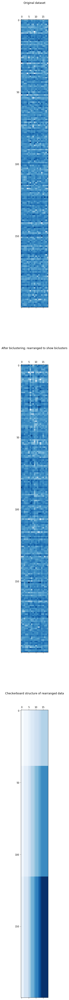

In [53]:
labels1 = spectral_bicluster(data_s9_1, n_clusters=(3,10)) # plot_title="cluster_log_s9"

In [29]:
row_labels1, col_labels1, rows1, cols1 = labels1

In [30]:
col_labels1

array([2, 9, 1, 1, 8, 6, 4, 9, 6, 3, 0, 9, 0, 9, 7, 1, 9, 5, 4])

In [31]:
row_counts = np.repeat(0, 200)  # row_counts[i] shows in how many biclusters row i is in
col_counts = np.repeat(0, 19)   # col_counts[j] shows in how many biclusters column j is in

for row in rows1:
    true_idx = np.argwhere(row).flatten()
    row_counts[true_idx] += 1
    
for col in cols1:
    true_idx = np.argwhere(col).flatten()
    col_counts[true_idx] += 1

print(row_counts)
print(col_counts)

[10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10
 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10
 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10
 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10
 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10
 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10
 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10
 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10
 10 10 10 10 10 10 10 10]
[3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3]


Each row is in 10 biclusters and each column is in 3 biclusters.

80% of values closest to the mean in (-5.015463352203369, 8.141800880432129)
Full range: (-35.727046966552734, 23.096914291381836)


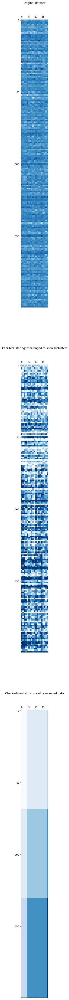

In [31]:
test = spectral_bicluster(data_s9_1, n_clusters=(3, 3), use_limits=True)

C:\Users\MariLiis\Anaconda3\lib\site-packages\sklearn\cluster\bicluster.py:480: FutureWarning: arrays to stack must be passed as a "sequence" type such as list or tuple. Support for non-sequence iterables such as generators is deprecated as of NumPy 1.16 and will raise an error in the future.
  for label in range(n_row_clusters)
C:\Users\MariLiis\Anaconda3\lib\site-packages\sklearn\cluster\bicluster.py:483: FutureWarning: arrays to stack must be passed as a "sequence" type such as list or tuple. Support for non-sequence iterables such as generators is deprecated as of NumPy 1.16 and will raise an error in the future.
  for _ in range(n_row_clusters)


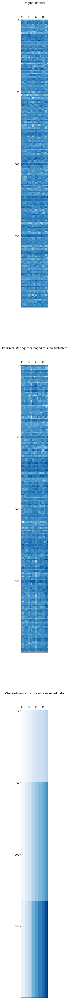

In [251]:
labels2 = spectral_bicluster(data_s9_1, n_clusters=(3,10), method='scale', plot_title="cluster_scale_s9")

C:\Users\MariLiis\Anaconda3\lib\site-packages\sklearn\cluster\bicluster.py:480: FutureWarning: arrays to stack must be passed as a "sequence" type such as list or tuple. Support for non-sequence iterables such as generators is deprecated as of NumPy 1.16 and will raise an error in the future.
  for label in range(n_row_clusters)
C:\Users\MariLiis\Anaconda3\lib\site-packages\sklearn\cluster\bicluster.py:483: FutureWarning: arrays to stack must be passed as a "sequence" type such as list or tuple. Support for non-sequence iterables such as generators is deprecated as of NumPy 1.16 and will raise an error in the future.
  for _ in range(n_row_clusters)


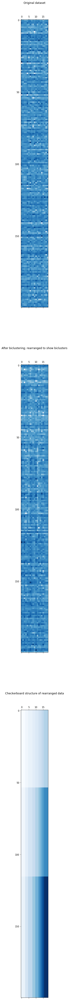

In [231]:
labels3 = spectral_bicluster(data_s9_1, n_clusters=(3,10), method='bistochastic', plot_title="cluster_bist_s9")

C:\Users\MariLiis\Anaconda3\lib\site-packages\sklearn\cluster\bicluster.py:480: FutureWarning: arrays to stack must be passed as a "sequence" type such as list or tuple. Support for non-sequence iterables such as generators is deprecated as of NumPy 1.16 and will raise an error in the future.
  for label in range(n_row_clusters)
C:\Users\MariLiis\Anaconda3\lib\site-packages\sklearn\cluster\bicluster.py:483: FutureWarning: arrays to stack must be passed as a "sequence" type such as list or tuple. Support for non-sequence iterables such as generators is deprecated as of NumPy 1.16 and will raise an error in the future.
  for _ in range(n_row_clusters)


(array([2, 0, 0, 1, 1, 2, 1, 1, 2, 2, 0, 0, 0, 1, 0, 2, 1, 2, 1, 0, 1, 0,
        1, 2, 0, 1, 2, 1, 1, 0, 2, 1, 1, 1, 0, 2, 1, 2, 0, 1, 1, 0, 0, 1,
        0, 1, 2, 1, 1, 0, 1, 0, 2, 1, 2, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1,
        1, 0, 1, 2, 0, 2, 0, 2, 1, 2, 0, 1, 0, 0, 0, 1, 1, 1, 1, 0, 1, 2,
        1, 0, 2, 1, 1, 2, 0, 1, 0, 0, 1, 2, 0, 1, 1, 1, 2, 1, 1, 2, 1, 1,
        1, 1, 1, 1, 0, 2, 0, 2, 1, 0, 1, 2, 1, 0, 0, 0, 1, 1, 0, 1, 0, 1,
        1, 1, 1, 0, 1, 0, 0, 1, 0, 2, 1, 0, 0, 1, 1, 1, 2, 0, 0, 2, 1, 1,
        0, 0, 1, 2, 1, 2, 1, 0, 0, 1, 1, 0, 2, 0, 2, 1, 1, 1, 1, 1, 0, 1,
        0, 0, 2, 1, 2, 0, 1, 1, 1, 0, 1, 0, 2, 1, 0, 2, 1, 0, 2, 1, 1, 0,
        1, 0]),
 array([4, 9, 3, 3, 4, 2, 5, 3, 3, 7, 5, 1, 0, 0, 8, 3, 3, 6, 1]))

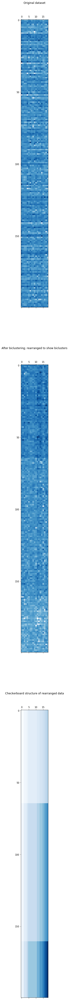

In [227]:
spectral_bicluster(data_s9_1, n_clusters=(3,10), method='bistochastic', svd_method="arpack", plot_title="cluster_bist_s9")

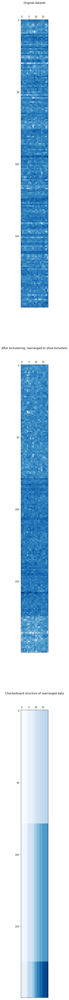

In [94]:
labels7 = spectral_bicluster(data_s9_7, n_clusters=(3,10), method='bistochastic', svd_method="arpack")

### 2. SpectralBiclustering, all subjects using one and three time windows per electrode

Firstly, the color map is in full range.

s1 0.057
[20.0 20.0]    [20.0 20.0]
[ 0.0  0.0]    [ 0.0  0.0]

s2 0.115
[11.0 11.0]    [ 8.0  8.0]
[ 9.0  9.0]    [12.0 12.0]

s3 0.157
[13.0 13.0]    [ 8.0  8.0]
[ 7.0  7.0]    [12.0 12.0]

s4 0.133
[12.0 12.0]    [13.0 13.0]
[ 8.0  8.0]    [ 7.0  7.0]

s5 0.275
[ 8.0  8.0]    [14.0 14.0]
[12.0 12.0]    [ 6.0  6.0]

s6 0.85
[17.0 17.0]    [15.0 15.0]
[ 3.0  3.0]    [ 5.0  5.0]

s7 0.432
[14.0 14.0]    [15.0 15.0]
[ 6.0  6.0]    [ 5.0  5.0]

s8 0.248
[11.0 11.0]    [11.0 11.0]
[ 9.0  9.0]    [ 9.0  9.0]

s9 0.578
[ 9.0  9.0]    [ 9.0  9.0]
[11.0 11.0]    [11.0 11.0]

s10 0.174
[11.0 11.0]    [15.0 15.0]
[ 9.0  9.0]    [ 5.0  5.0]



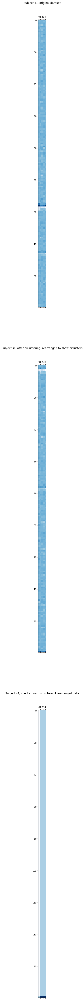

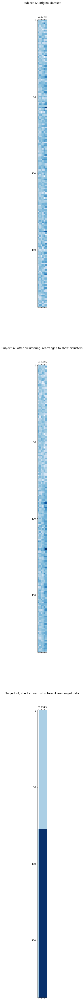

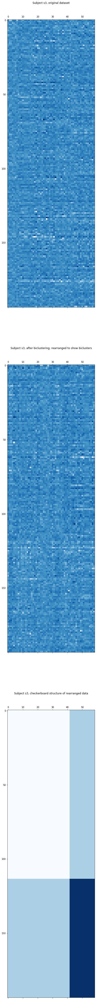

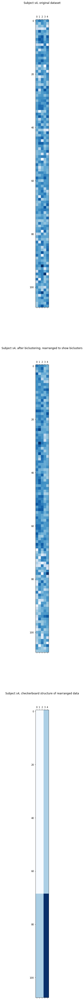

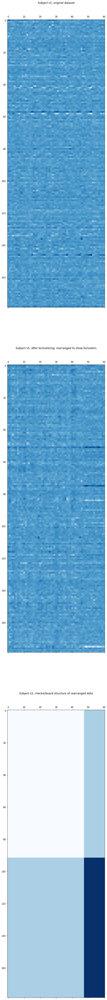

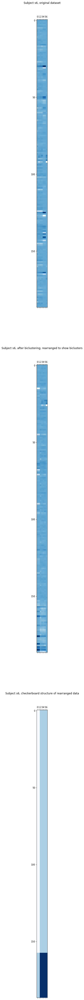

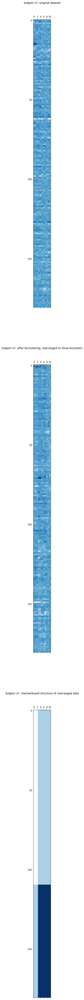

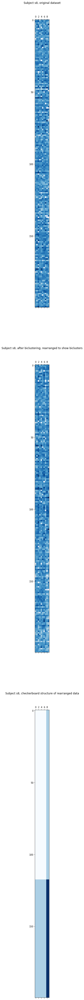

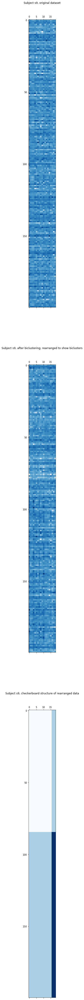

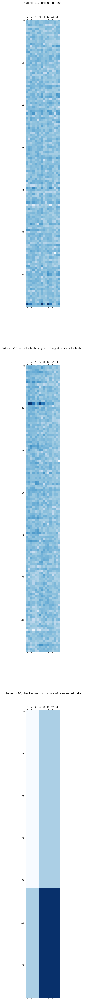

In [95]:
for s in SUBJECTS:
    data = all_datasets[(s, AFTER_OUTCOME, ALL, 1, True)]
    row_labels, col_labels, _, _ = spectral_bicluster(data, s_name=s)
    print(s, ASR(data, row_labels, col_labels))
    arr1, arr2 = compare_first_and_last_trials(row_labels, col_labels)
    pretty_print_arrays(arr1, arr2)

s1 0.479
[ 9.0  9.0]    [10.0 10.0]
[11.0 11.0]    [10.0 10.0]

s2 0.445
[12.0 12.0]    [10.0 10.0]
[ 8.0  8.0]    [10.0 10.0]

s3 0.137
[13.0 13.0]    [ 9.0  9.0]
[ 7.0  7.0]    [11.0 11.0]

s4 0.257
[14.0 14.0]    [14.0 14.0]
[ 6.0  6.0]    [ 6.0  6.0]

s5 0.217
[ 9.0  9.0]    [ 9.0  9.0]
[11.0 11.0]    [11.0 11.0]

s6 0.741
[20.0 20.0]    [19.0 19.0]
[ 0.0  0.0]    [ 1.0  1.0]

s7 0.427
[14.0 14.0]    [ 9.0  9.0]
[ 6.0  6.0]    [11.0 11.0]

s8 0.237
[ 8.0  8.0]    [11.0 11.0]
[12.0 12.0]    [ 9.0  9.0]

s9 0.411
[11.0 11.0]    [13.0 13.0]
[ 9.0  9.0]    [ 7.0  7.0]

s10 0.212
[ 9.0  9.0]    [14.0 14.0]
[11.0 11.0]    [ 6.0  6.0]



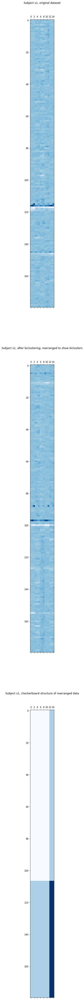

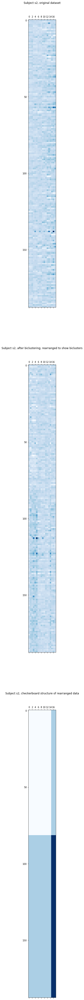

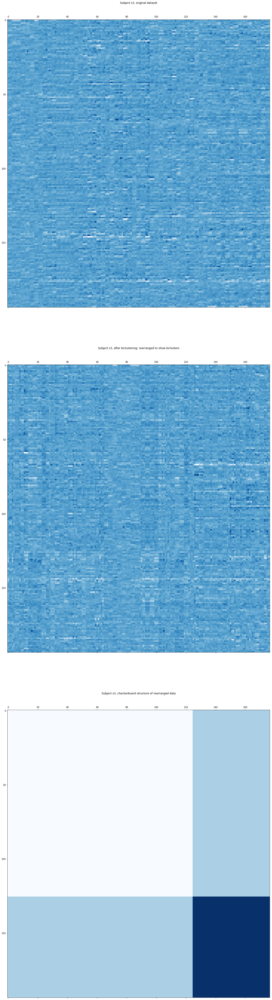

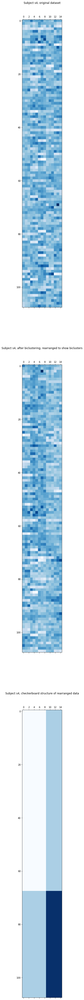

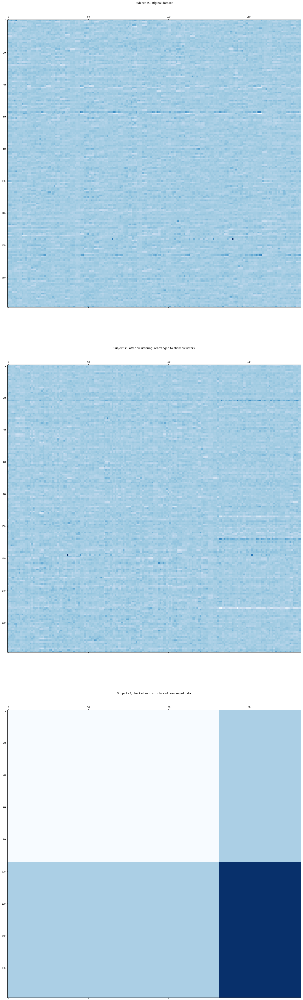

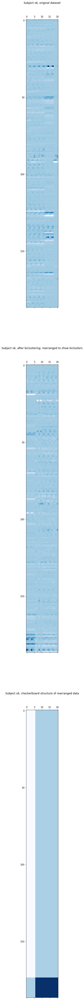

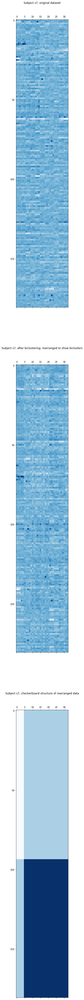

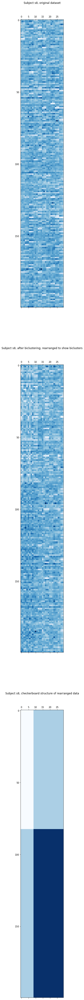

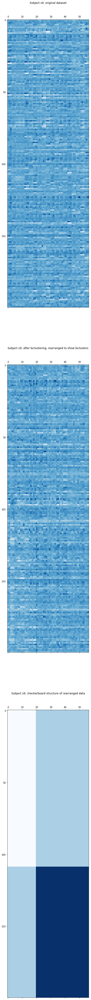

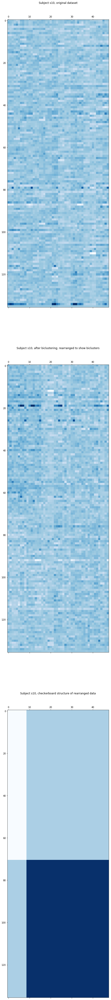

In [96]:
for s in SUBJECTS:
    data = all_datasets[(s, AFTER_OUTCOME, ALL, 3, True)]
    row_labels, col_labels, _, _ = spectral_bicluster(data, s_name=s)
    print(s, ASR(data, row_labels, col_labels))     
    arr1, arr2 = compare_first_and_last_trials(row_labels, col_labels)
    pretty_print_arrays(arr1, arr2)

s1 0.125
[20.0 20.0]    [20.0 20.0]
[ 0.0  0.0]    [ 0.0  0.0]

s2 0.071
[ 8.0  8.0]    [12.0 12.0]
[12.0 12.0]    [ 8.0  8.0]

s3 0.212
[12.0 12.0]    [15.0 15.0]
[ 8.0  8.0]    [ 5.0  5.0]

s4 0.122
[11.0 11.0]    [13.0 13.0]
[ 9.0  9.0]    [ 7.0  7.0]

s5 0.217
[ 8.0  8.0]    [ 7.0  7.0]
[12.0 12.0]    [13.0 13.0]

s6 0.422
[20.0 20.0]    [20.0 20.0]
[ 0.0  0.0]    [ 0.0  0.0]

s7 0.363
[12.0 12.0]    [15.0 15.0]
[ 8.0  8.0]    [ 5.0  5.0]

s8 0.152
[10.0 10.0]    [14.0 14.0]
[10.0 10.0]    [ 6.0  6.0]

s9 0.565
[17.0 17.0]    [12.0 12.0]
[ 3.0  3.0]    [ 8.0  8.0]

s10 0.097
[14.0 14.0]    [10.0 10.0]
[ 6.0  6.0]    [10.0 10.0]



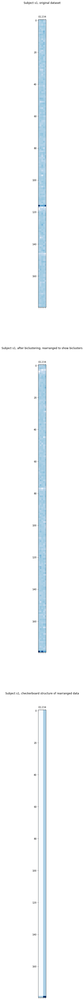

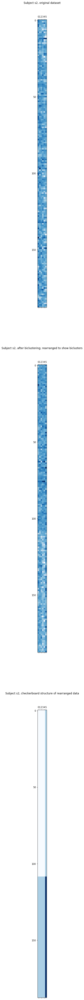

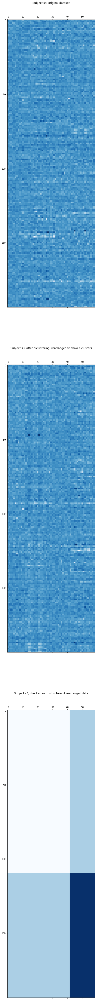

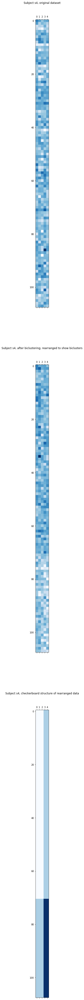

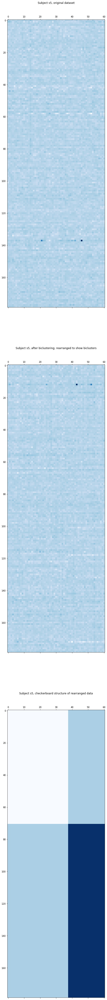

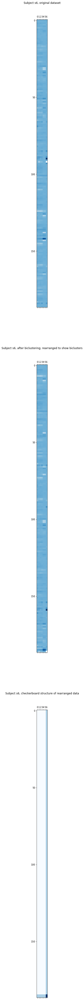

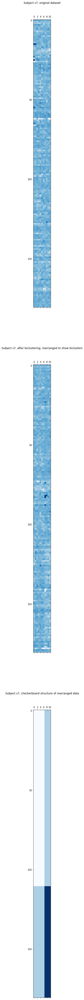

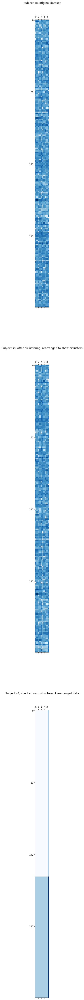

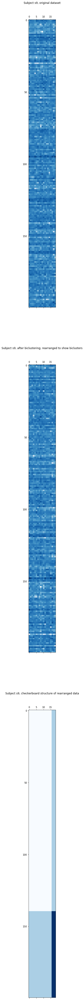

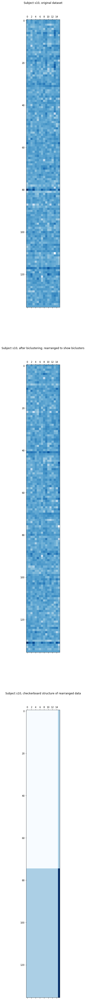

In [97]:
for s in SUBJECTS:
    data = all_datasets[(s, GAMEPRES_BUTTONPRESS, ALL, 1, True)]
    row_labels, col_labels, _, _ = spectral_bicluster(data, s_name=s)
    print(s, ASR(data, row_labels, col_labels)) 
    arr1, arr2 = compare_first_and_last_trials(row_labels, col_labels)
    pretty_print_arrays(arr1, arr2)

s1 0.23
[20.0 20.0]    [20.0 20.0]
[ 0.0  0.0]    [ 0.0  0.0]

s2 0.443
[10.0 10.0]    [11.0 11.0]
[10.0 10.0]    [ 9.0  9.0]

s3 0.15
[10.0 10.0]    [10.0 10.0]
[10.0 10.0]    [10.0 10.0]

s4 0.313
[ 9.0  9.0]    [ 8.0  8.0]
[11.0 11.0]    [12.0 12.0]

s5 0.085
[20.0 20.0]    [20.0 20.0]
[ 0.0  0.0]    [ 0.0  0.0]

s6 0.323
[20.0 20.0]    [20.0 20.0]
[ 0.0  0.0]    [ 0.0  0.0]

s7 0.272
[14.0 14.0]    [16.0 16.0]
[ 6.0  6.0]    [ 4.0  4.0]

s8 0.246
[11.0 11.0]    [11.0 11.0]
[ 9.0  9.0]    [ 9.0  9.0]

s9 0.421
[ 7.0  7.0]    [ 5.0  5.0]
[13.0 13.0]    [15.0 15.0]



C:\Users\MariLiis\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2530: RuntimeWarning: invalid value encountered in true_divide
  c /= stddev[:, None]
C:\Users\MariLiis\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2531: RuntimeWarning: invalid value encountered in true_divide
  c /= stddev[None, :]
C:\Users\MariLiis\Anaconda3\lib\site-packages\scipy\stats\_distn_infrastructure.py:877: RuntimeWarning: invalid value encountered in greater
  return (self.a < x) & (x < self.b)
C:\Users\MariLiis\Anaconda3\lib\site-packages\scipy\stats\_distn_infrastructure.py:877: RuntimeWarning: invalid value encountered in less
  return (self.a < x) & (x < self.b)
C:\Users\MariLiis\Anaconda3\lib\site-packages\scipy\stats\_distn_infrastructure.py:1831: RuntimeWarning: invalid value encountered in less_equal
  cond2 = cond0 & (x <= self.a)


s10 0.306
[ 9.0  9.0]    [ 6.0  6.0]
[11.0 11.0]    [14.0 14.0]



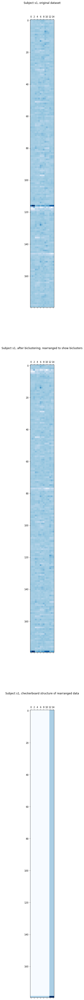

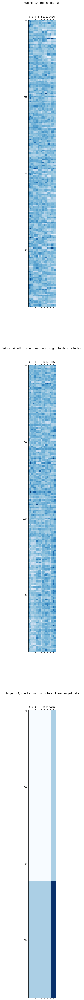

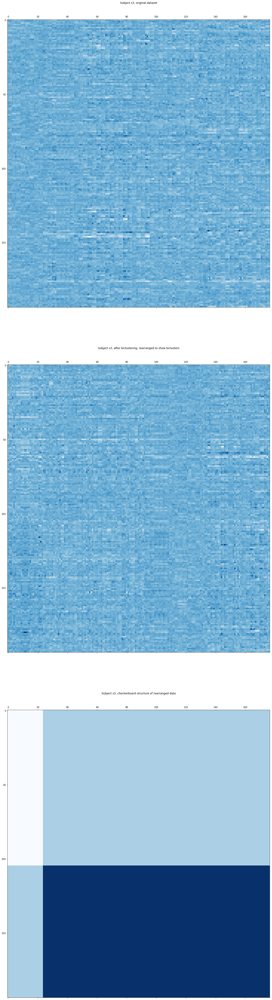

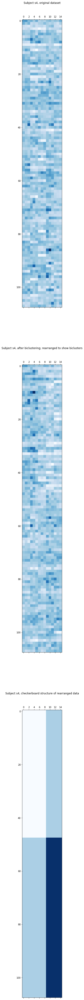

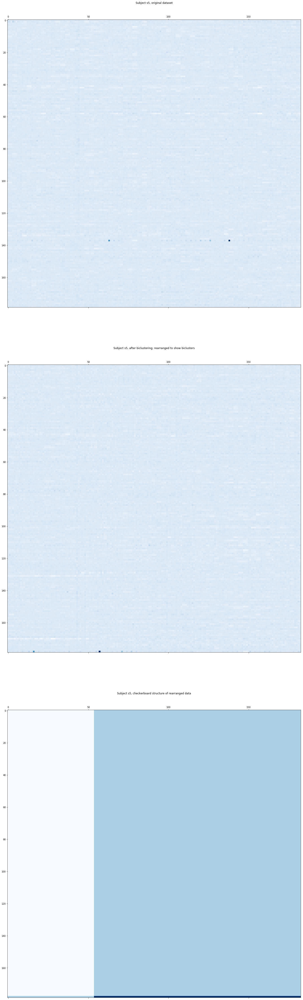

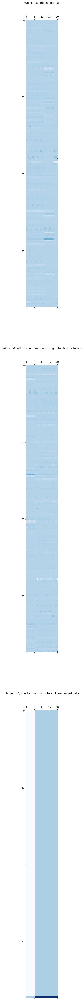

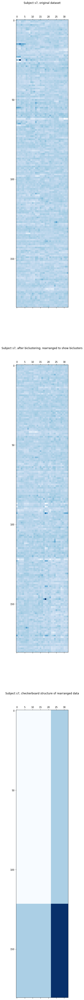

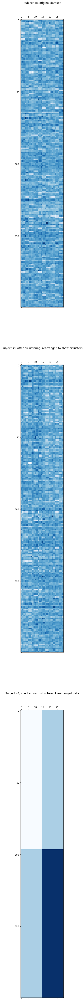

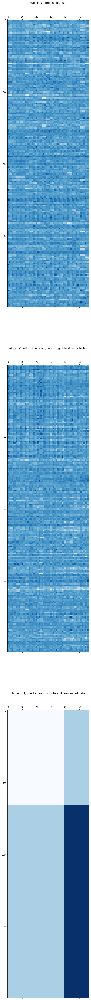

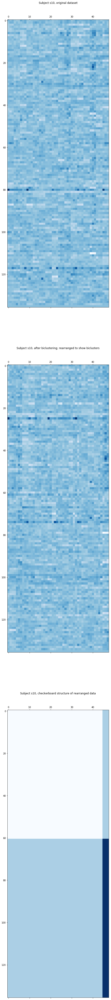

In [98]:
for s in SUBJECTS:
    data = all_datasets[(s, GAMEPRES_BUTTONPRESS, ALL, 3, True)]
    row_labels, col_labels, _, _ = spectral_bicluster(data, s_name=s)
    print(s, ASR(data, row_labels, col_labels)) 
    arr1, arr2 = compare_first_and_last_trials(row_labels, col_labels)
    pretty_print_arrays(arr1, arr2)

Same thing, but using limits for color map range:

80% of values closest to the mean in (-3.3678417205810547, 3.7711198329925537)
Full range: (-53.207027435302734, 60.32698059082031)
s1 0.057
80% of values closest to the mean in (-3.942643165588379, 5.357942581176758)
Full range: (-15.55233097076416, 26.013912200927734)
s2 0.115
80% of values closest to the mean in (-3.5491442680358887, 4.597352981567383)
Full range: (-30.831876754760742, 17.644731521606445)
s3 0.157
80% of values closest to the mean in (-3.2625322341918945, 3.8258352279663086)
Full range: (-9.85436725616455, 8.920710563659668)
s4 0.133
80% of values closest to the mean in (-4.043973445892334, 4.061544418334961)
Full range: (-38.83614730834961, 27.400196075439453)
s5 0.275
80% of values closest to the mean in (-3.8070576190948486, 4.0408430099487305)
Full range: (-50.58757400512695, 46.44874954223633)
s6 0.85
80% of values closest to the mean in (-3.9123382568359375, 5.055211067199707)
Full range: (-30.88140106201172, 26.025718688964844)
s7 0.432
80% of values closest 

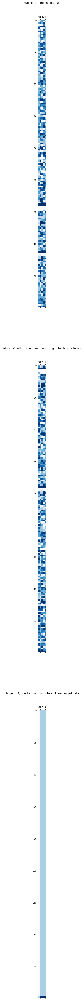

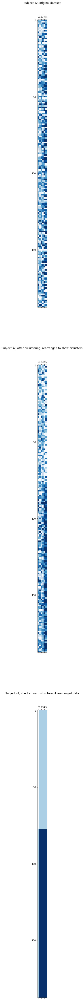

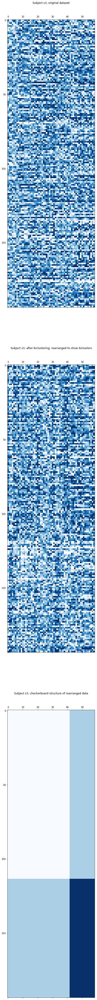

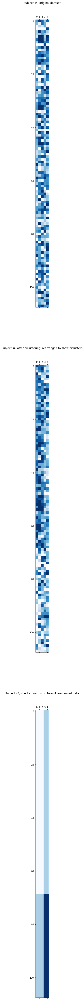

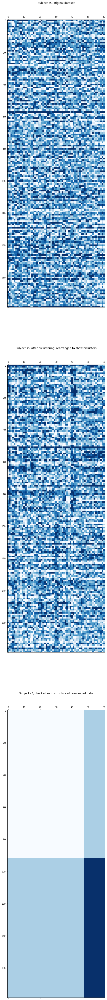

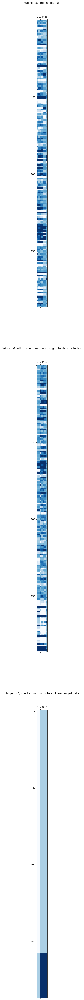

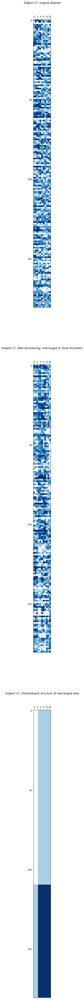

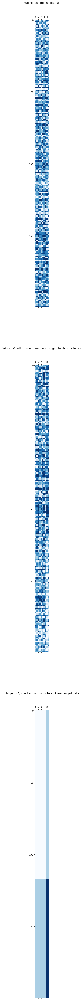

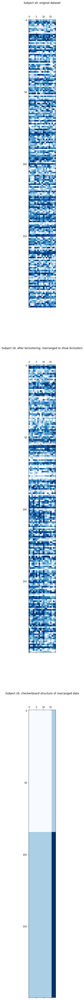

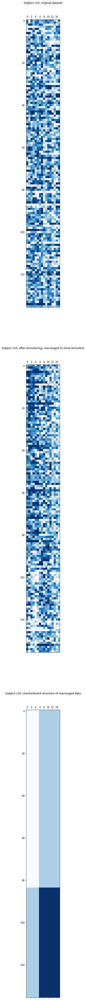

In [113]:
for s in SUBJECTS:
    data = all_datasets[(s, AFTER_OUTCOME, ALL, 1, True)]
    row_labels, col_labels, _, _ = spectral_bicluster(data, s_name=s, use_limits=True)
    print(s, ASR(data, row_labels, col_labels))

80% of values closest to the mean in (-3.843449354171753, 4.263352394104004)
Full range: (-56.54338455200195, 79.61263275146484)
s1 0.479
80% of values closest to the mean in (-4.5164384841918945, 5.915828704833984)
Full range: (-18.069202423095703, 56.70408630371094)
s2 0.445
80% of values closest to the mean in (-4.066187858581543, 5.115024089813232)
Full range: (-33.24812316894531, 27.53783416748047)
s3 0.137
80% of values closest to the mean in (-3.7401843070983887, 4.307929515838623)
Full range: (-11.514327049255371, 14.571548461914062)
s4 0.257
80% of values closest to the mean in (-4.576441287994385, 4.59435510635376)
Full range: (-40.14731216430664, 73.41022491455078)
s5 0.217
80% of values closest to the mean in (-4.1419806480407715, 4.3707594871521)
Full range: (-58.573814392089844, 101.8519515991211)
s6 0.741
80% of values closest to the mean in (-4.450671672821045, 5.5830535888671875)
Full range: (-32.01612854003906, 35.77920913696289)
s7 0.427
80% of values closest to the 

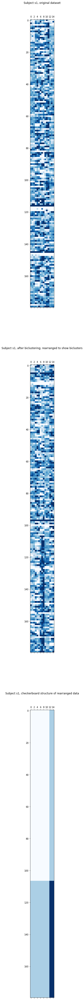

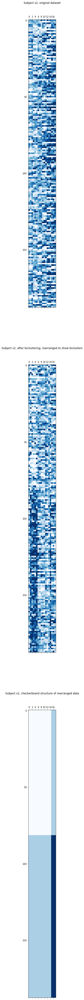

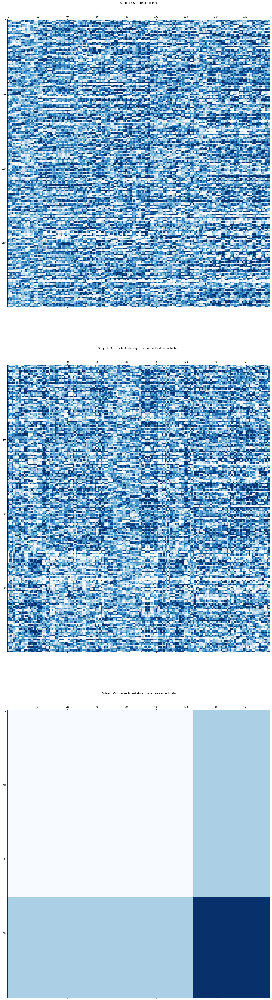

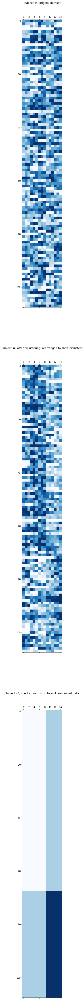

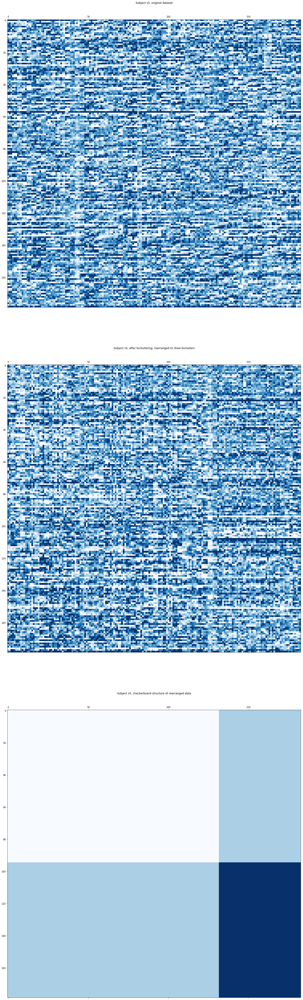

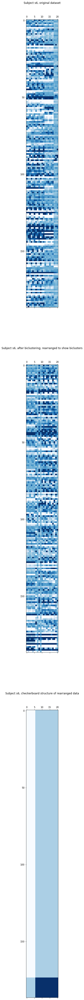

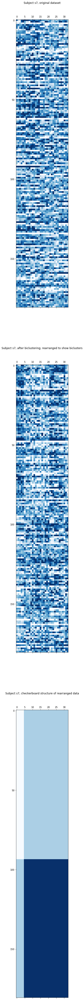

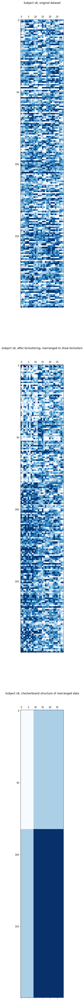

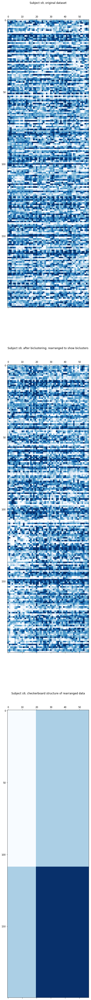

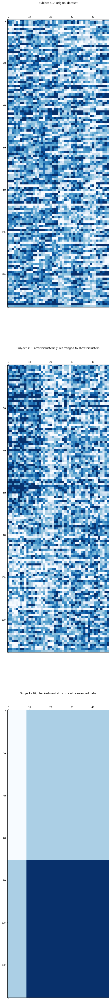

In [114]:
for s in SUBJECTS:
    data = all_datasets[(s, AFTER_OUTCOME, ALL, 3, True)]
    row_labels, col_labels, _, _ = spectral_bicluster(data, s_name=s, use_limits=True)
    print(s, ASR(data, row_labels, col_labels))     

80% of values closest to the mean in (-3.8805739879608154, 3.4754738807678223)
Full range: (-32.909122467041016, 62.567893981933594)
s1 0.125
80% of values closest to the mean in (-5.425436973571777, 4.696681499481201)
Full range: (-20.563602447509766, 15.653754234313965)
s2 0.071
80% of values closest to the mean in (-4.941554546356201, 3.865443468093872)
Full range: (-36.2177619934082, 22.06747817993164)
s3 0.212
80% of values closest to the mean in (-4.171037197113037, 3.788609504699707)
Full range: (-11.004410743713379, 13.611538887023926)
s4 0.122
80% of values closest to the mean in (-4.346320152282715, 4.387862205505371)
Full range: (-35.802330017089844, 83.57894897460938)
s5 0.217
80% of values closest to the mean in (-4.02622127532959, 3.7977302074432373)
Full range: (-76.0614013671875, 78.41828918457031)
s6 0.422
80% of values closest to the mean in (-4.825484752655029, 3.8080146312713623)
Full range: (-26.900310516357422, 29.167009353637695)
s7 0.363
80% of values closest to

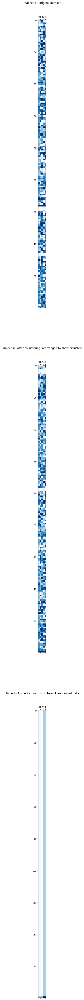

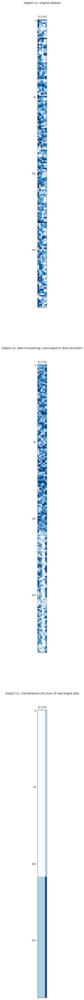

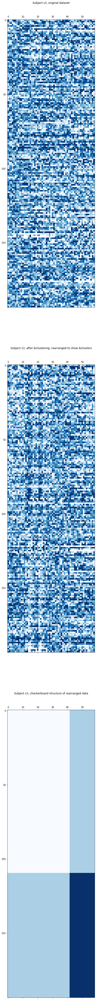

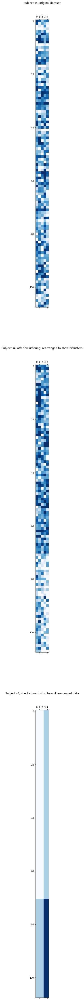

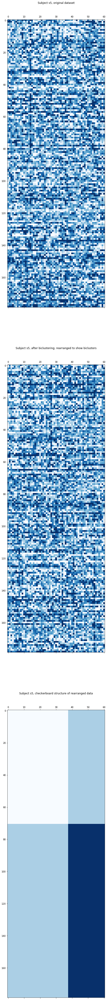

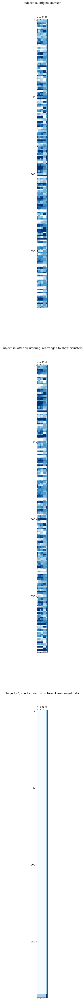

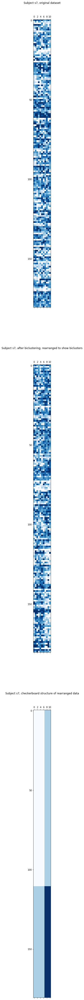

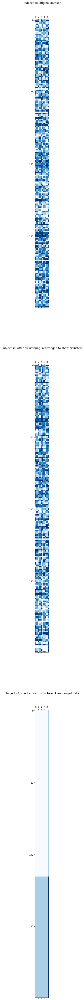

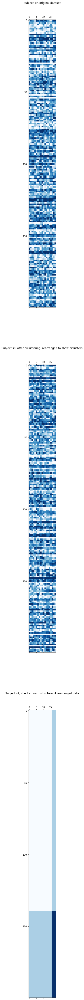

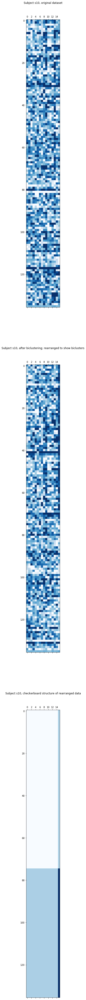

In [115]:
for s in SUBJECTS:
    data = all_datasets[(s, GAMEPRES_BUTTONPRESS, ALL, 1, True)]
    row_labels, col_labels, _, _ = spectral_bicluster(data, s_name=s, use_limits=True)
    print(s, ASR(data, row_labels, col_labels)) 

80% of values closest to the mean in (-4.281752586364746, 3.8459854125976562)
Full range: (-42.50403594970703, 73.88970947265625)
s1 0.23
80% of values closest to the mean in (-6.038040637969971, 5.360703945159912)
Full range: (-22.54741859436035, 27.882043838500977)
s2 0.443
80% of values closest to the mean in (-5.736398220062256, 4.663783073425293)
Full range: (-38.321258544921875, 38.6551628112793)
s3 0.15
80% of values closest to the mean in (-4.692008018493652, 4.382691860198975)
Full range: (-12.61581039428711, 22.352781295776367)
s4 0.313
80% of values closest to the mean in (-5.114738464355469, 5.158316612243652)
Full range: (-38.433475494384766, 249.1636505126953)
s5 0.085
80% of values closest to the mean in (-4.446321487426758, 4.224156856536865)
Full range: (-95.62056732177734, 215.354736328125)
s6 0.323
80% of values closest to the mean in (-5.40901517868042, 4.388306140899658)
Full range: (-29.21978759765625, 68.84880065917969)
s7 0.272
80% of values closest to the mean 

C:\Users\MariLiis\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2530: RuntimeWarning: invalid value encountered in true_divide
  c /= stddev[:, None]
C:\Users\MariLiis\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2531: RuntimeWarning: invalid value encountered in true_divide
  c /= stddev[None, :]
C:\Users\MariLiis\Anaconda3\lib\site-packages\scipy\stats\_distn_infrastructure.py:877: RuntimeWarning: invalid value encountered in greater
  return (self.a < x) & (x < self.b)
C:\Users\MariLiis\Anaconda3\lib\site-packages\scipy\stats\_distn_infrastructure.py:877: RuntimeWarning: invalid value encountered in less
  return (self.a < x) & (x < self.b)
C:\Users\MariLiis\Anaconda3\lib\site-packages\scipy\stats\_distn_infrastructure.py:1831: RuntimeWarning: invalid value encountered in less_equal
  cond2 = cond0 & (x <= self.a)


s10 0.306


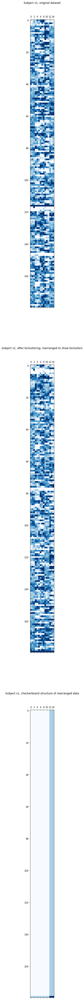

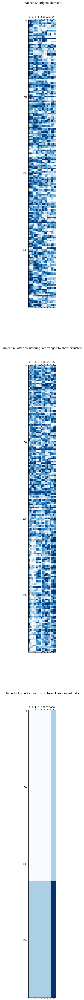

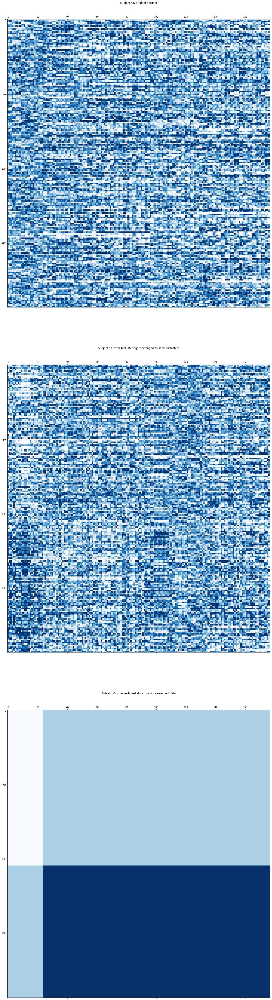

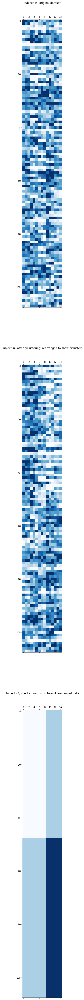

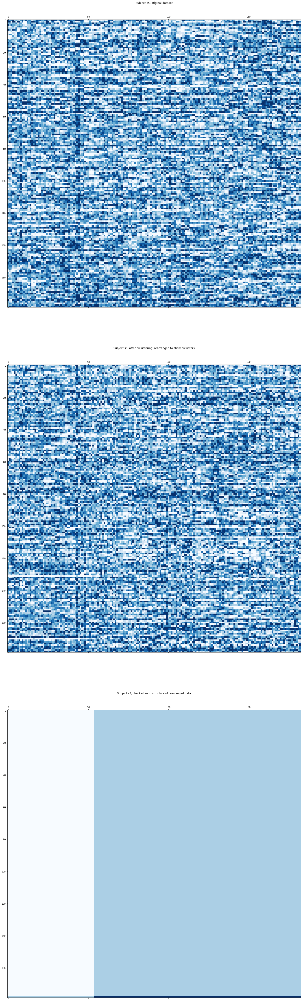

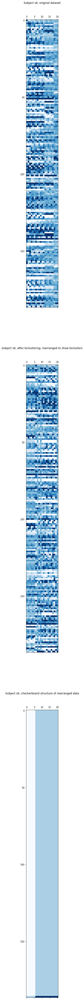

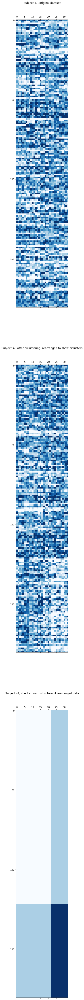

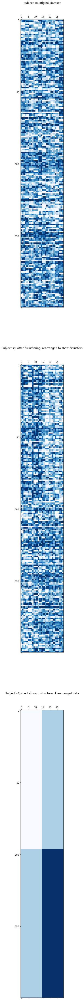

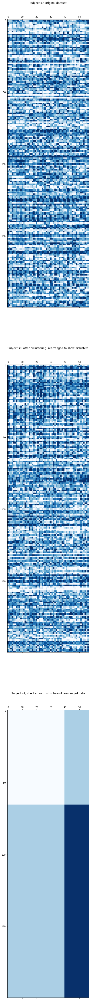

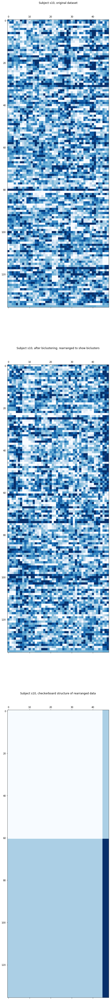

In [116]:
for s in SUBJECTS:
    data = all_datasets[(s, GAMEPRES_BUTTONPRESS, ALL, 3, True)]
    row_labels, col_labels, _, _ = spectral_bicluster(data, s_name=s, use_limits=True)
    print(s, ASR(data, row_labels, col_labels)) 

### 3. Testing Coclustering

C:\Users\MariLiis\Anaconda3\lib\site-packages\sklearn\cluster\bicluster.py:296: FutureWarning: arrays to stack must be passed as a "sequence" type such as list or tuple. Support for non-sequence iterables such as generators is deprecated as of NumPy 1.16 and will raise an error in the future.
  for c in range(self.n_clusters))
C:\Users\MariLiis\Anaconda3\lib\site-packages\sklearn\cluster\bicluster.py:298: FutureWarning: arrays to stack must be passed as a "sequence" type such as list or tuple. Support for non-sequence iterables such as generators is deprecated as of NumPy 1.16 and will raise an error in the future.
  for c in range(self.n_clusters))


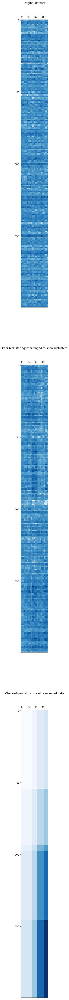

In [143]:
labels4 = bicocluster(data_s9_1, plot_title="cluster_cocluster_s9")

s1 0.093
s2 0.191
s3 0.169
s4 0.278
s5 0.274
s6 0.196
s7 0.355
s8 0.247
s9 0.474
s10 0.284


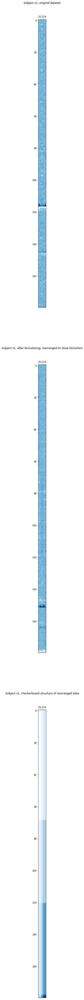

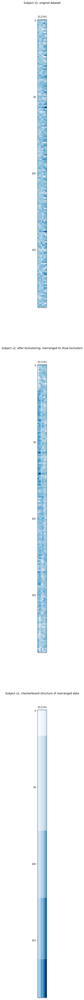

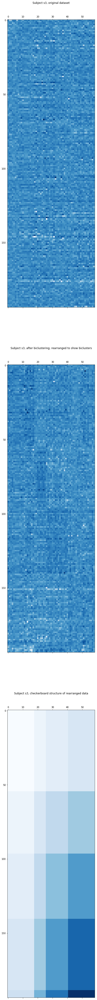

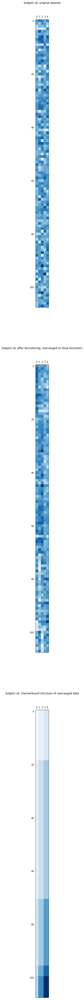

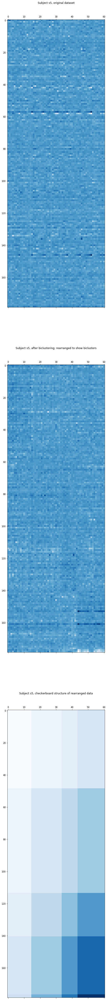

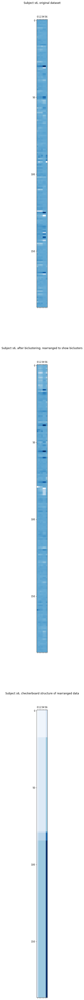

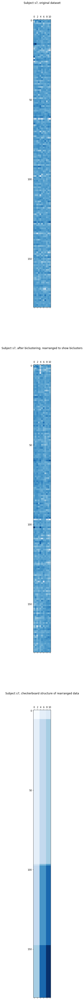

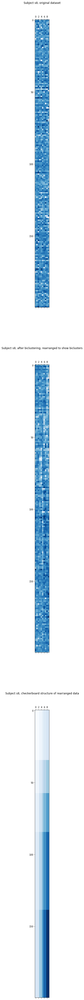

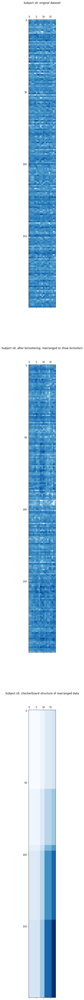

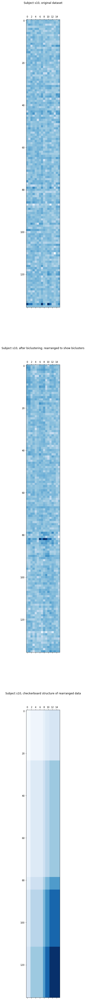

In [66]:
for s in SUBJECTS:
    data = all_datasets[(s, AFTER_OUTCOME, ALL, 1, True)]
    row_labels, col_labels, _, _ = bicocluster(data, s_name=s)
    print(s, ASR(data, row_labels, col_labels))

s1 0.205
s2 0.357
s3 0.175
s4 0.521
s5 0.226
s6 0.588
s7 0.295
s8 0.306
s9 0.446


C:\Users\MariLiis\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2530: RuntimeWarning: invalid value encountered in true_divide
  c /= stddev[:, None]
C:\Users\MariLiis\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2531: RuntimeWarning: invalid value encountered in true_divide
  c /= stddev[None, :]
C:\Users\MariLiis\Anaconda3\lib\site-packages\scipy\stats\_distn_infrastructure.py:877: RuntimeWarning: invalid value encountered in greater
  return (self.a < x) & (x < self.b)
C:\Users\MariLiis\Anaconda3\lib\site-packages\scipy\stats\_distn_infrastructure.py:877: RuntimeWarning: invalid value encountered in less
  return (self.a < x) & (x < self.b)
C:\Users\MariLiis\Anaconda3\lib\site-packages\scipy\stats\_distn_infrastructure.py:1831: RuntimeWarning: invalid value encountered in less_equal
  cond2 = cond0 & (x <= self.a)


s10 0.383


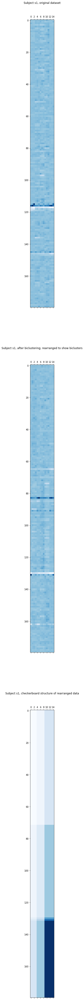

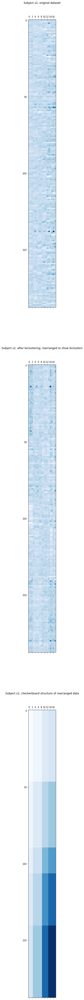

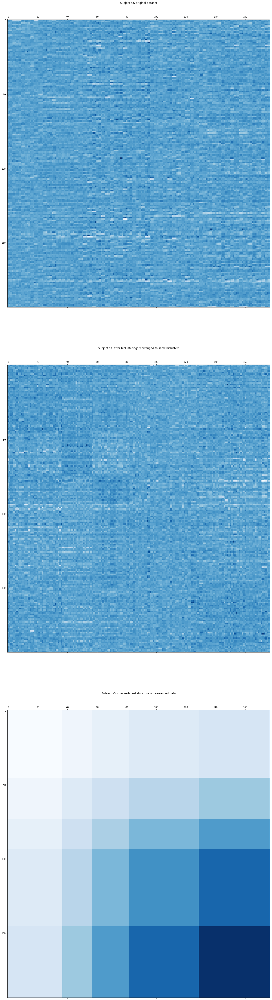

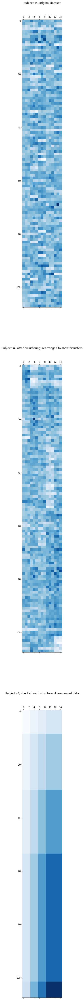

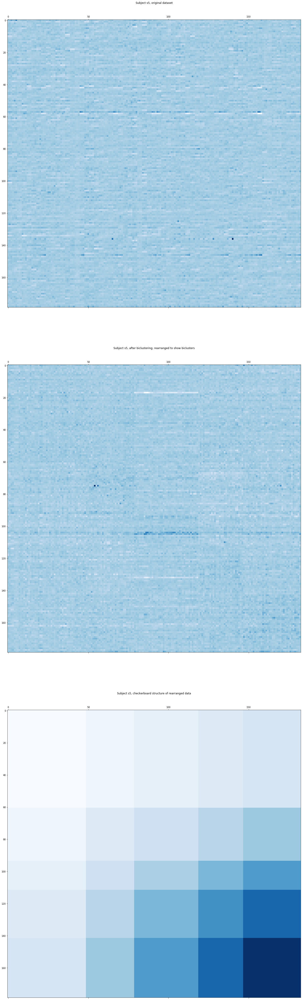

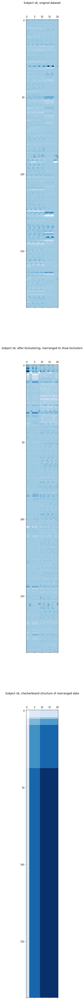

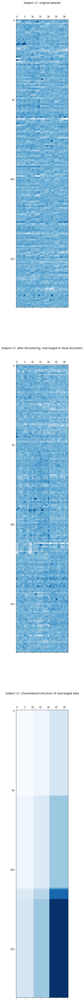

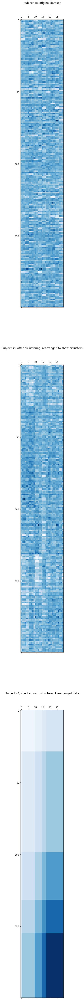

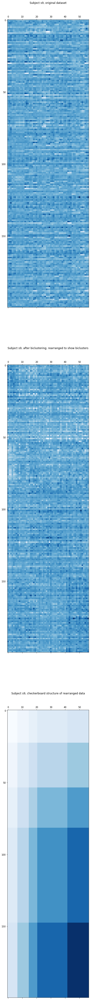

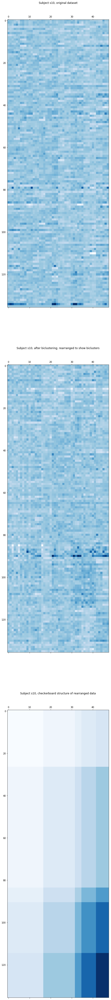

In [65]:
for s in SUBJECTS:
    data = all_datasets[(s, AFTER_OUTCOME, ALL, 3, True)] 
    row_labels, col_labels, _, _ = bicocluster(data, s_name=s)
    print(s, ASR(data, row_labels, col_labels))    

s1 0.025
s2 0.219
s3 0.204
s4 0.108
s5 0.134
s6 0.395
s7 0.255
s8 0.328
s9 0.48
s10 0.21


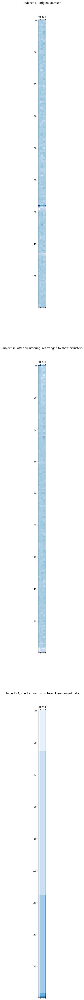

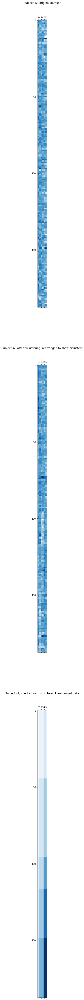

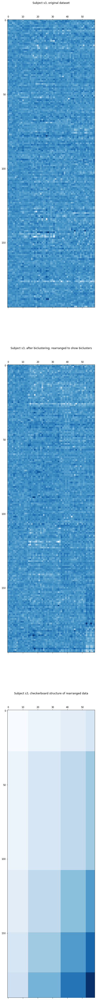

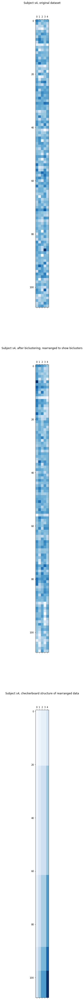

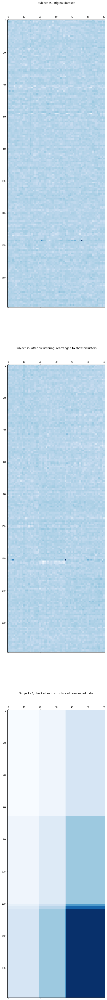

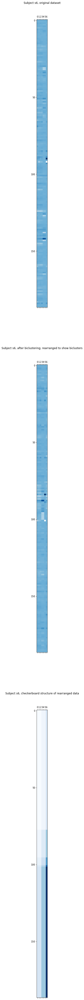

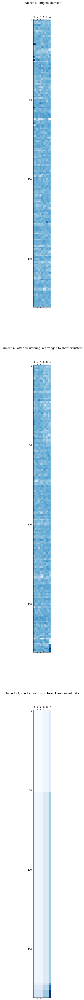

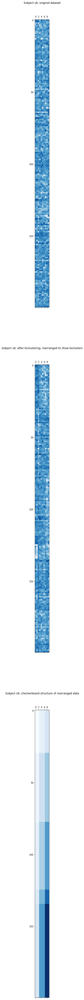

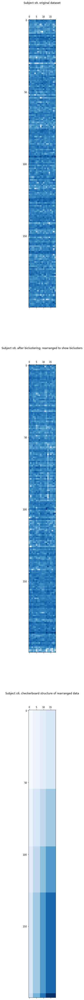

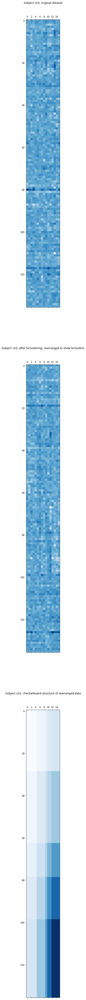

In [64]:
for s in SUBJECTS:
    data = all_datasets[(s, GAMEPRES_BUTTONPRESS, ALL, 1, True)] 
    row_labels, col_labels, _, _ = bicocluster(data, s_name=s)
    print(s, ASR(data, row_labels, col_labels))    

s1 0.222
s2 0.408
s3 0.177
s4 0.469
s5 0.094
s6 0.32
s7 0.25
s8 0.32
s9 0.421


C:\Users\MariLiis\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2530: RuntimeWarning: invalid value encountered in true_divide
  c /= stddev[:, None]
C:\Users\MariLiis\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2531: RuntimeWarning: invalid value encountered in true_divide
  c /= stddev[None, :]
C:\Users\MariLiis\Anaconda3\lib\site-packages\scipy\stats\_distn_infrastructure.py:877: RuntimeWarning: invalid value encountered in greater
  return (self.a < x) & (x < self.b)
C:\Users\MariLiis\Anaconda3\lib\site-packages\scipy\stats\_distn_infrastructure.py:877: RuntimeWarning: invalid value encountered in less
  return (self.a < x) & (x < self.b)
C:\Users\MariLiis\Anaconda3\lib\site-packages\scipy\stats\_distn_infrastructure.py:1831: RuntimeWarning: invalid value encountered in less_equal
  cond2 = cond0 & (x <= self.a)


s10 0.299


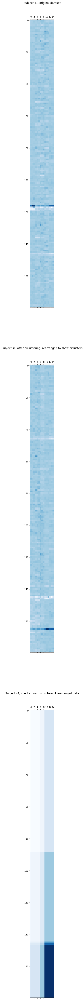

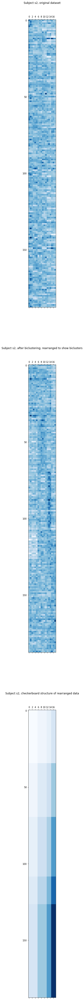

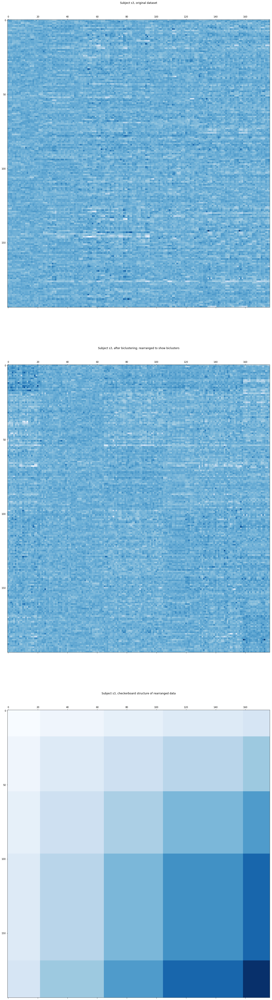

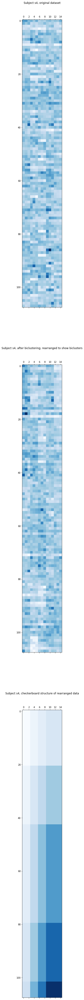

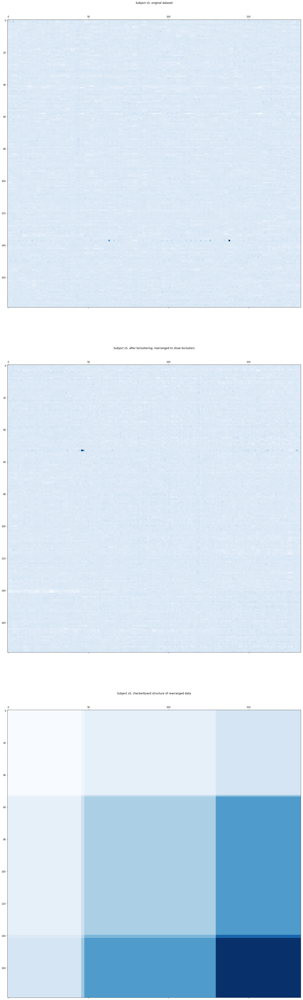

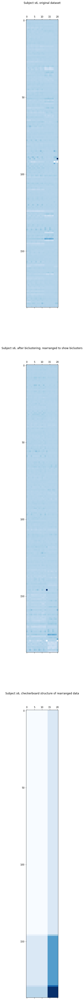

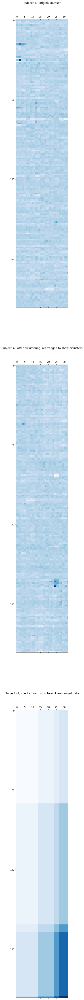

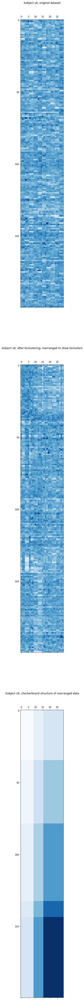

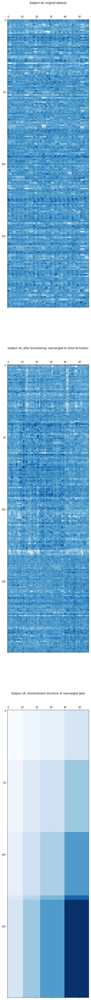

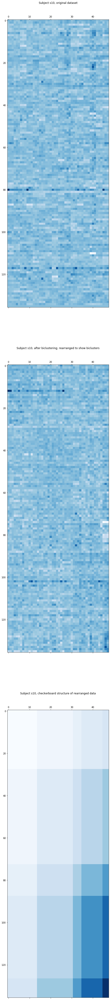

In [67]:
for s in SUBJECTS:
    data = all_datasets[(s, GAMEPRES_BUTTONPRESS, ALL, 3, True)] 
    row_labels, col_labels, _, _ = bicocluster(data, s_name=s)
    print(s, ASR(data, row_labels, col_labels))    

80% of values closest to the mean in (-3.3678417205810547, 3.7711198329925537)
Full range: (-53.207027435302734, 60.32698059082031)
s1 0.093
[ 8.0  8.0  8.0]    [ 5.0  5.0  5.0]
[ 8.0  8.0  8.0]    [ 9.0  9.0  9.0]
[ 4.0  4.0  4.0]    [ 6.0  6.0  6.0]
[ 0.0  0.0  0.0]    [ 0.0  0.0  0.0]
[ 0.0  0.0  0.0]    [ 0.0  0.0  0.0]

80% of values closest to the mean in (-3.942643165588379, 5.357942581176758)
Full range: (-15.55233097076416, 26.013912200927734)
s2 0.191
[ 2.0  2.0  2.0  2.0]    [ 2.0  2.0  2.0  2.0]
[ 7.0  7.0  7.0  7.0]    [ 6.0  6.0  6.0  6.0]
[ 5.0  5.0  5.0  5.0]    [ 5.0  5.0  5.0  5.0]
[ 3.0  3.0  3.0  3.0]    [ 4.0  4.0  4.0  4.0]
[ 3.0  3.0  3.0  3.0]    [ 3.0  3.0  3.0  3.0]

80% of values closest to the mean in (-3.5491442680358887, 4.597352981567383)
Full range: (-30.831876754760742, 17.644731521606445)
s3 0.169
[ 7.0  7.0  7.0  7.0]    [ 6.0  6.0  6.0  6.0]
[ 5.0  5.0  5.0  5.0]    [ 7.0  7.0  7.0  7.0]
[ 6.0  6.0  6.0  6.0]    [ 4.0  4.0  4.0  4.0]
[ 1.0  1.0  1.0 

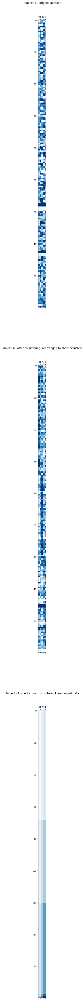

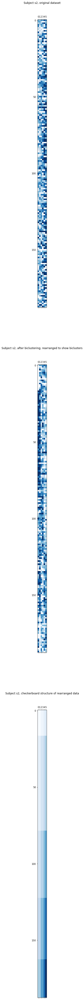

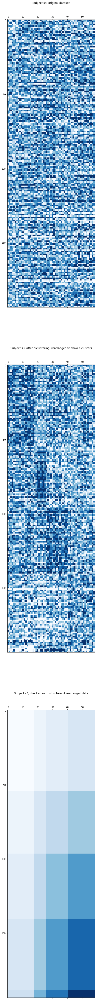

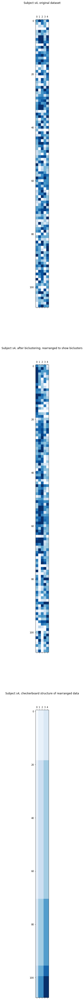

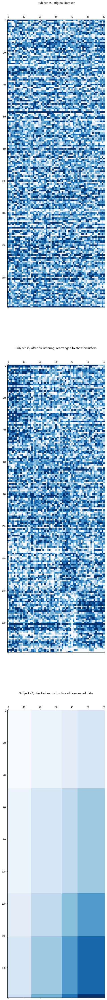

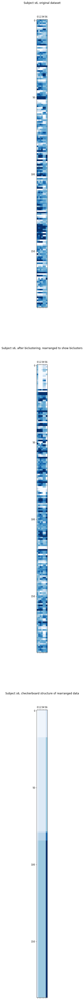

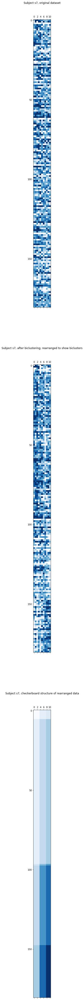

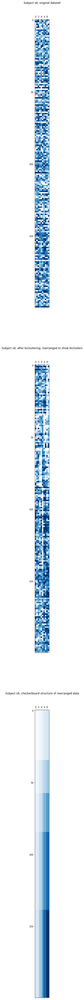

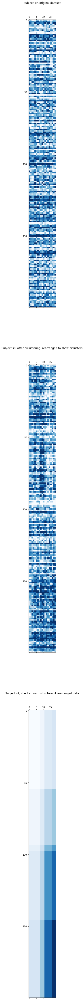

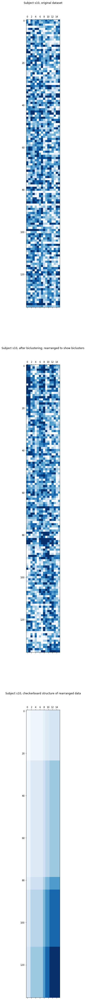

In [117]:
for s in SUBJECTS:
    data = all_datasets[(s, AFTER_OUTCOME, ALL, 1, True)]
    row_labels, col_labels, _, _ = bicocluster(data, s_name=s, use_limits=True)
    print(s, ASR(data, row_labels, col_labels))
    arr1, arr2 = compare_first_and_last_trials(row_labels, col_labels)
    pretty_print_arrays(arr1, arr2)

80% of values closest to the mean in (-3.843449354171753, 4.263352394104004)
Full range: (-56.54338455200195, 79.61263275146484)
s1 0.205
[ 6.0  6.0  6.0]    [ 7.0  7.0  7.0]
[10.0 10.0 10.0]    [ 9.0  9.0  9.0]
[ 0.0  0.0  0.0]    [ 0.0  0.0  0.0]
[ 0.0  0.0  0.0]    [ 0.0  0.0  0.0]
[ 4.0  4.0  4.0]    [ 4.0  4.0  4.0]

80% of values closest to the mean in (-4.5164384841918945, 5.915828704833984)
Full range: (-18.069202423095703, 56.70408630371094)
s2 0.357
[ 4.0  4.0  4.0  4.0]    [ 5.0  5.0  5.0  5.0]
[ 5.0  5.0  5.0  5.0]    [ 3.0  3.0  3.0  3.0]
[ 2.0  2.0  2.0  2.0]    [ 1.0  1.0  1.0  1.0]
[ 2.0  2.0  2.0  2.0]    [ 7.0  7.0  7.0  7.0]
[ 7.0  7.0  7.0  7.0]    [ 4.0  4.0  4.0  4.0]

80% of values closest to the mean in (-4.066187858581543, 5.115024089813232)
Full range: (-33.24812316894531, 27.53783416748047)
s3 0.175
[ 4.0  4.0  4.0  4.0  4.0]    [ 5.0  5.0  5.0  5.0  5.0]
[ 6.0  6.0  6.0  6.0  6.0]    [ 4.0  4.0  4.0  4.0  4.0]
[ 1.0  1.0  1.0  1.0  1.0]    [ 1.0  1.0  1.0  1

C:\Users\MariLiis\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2530: RuntimeWarning: invalid value encountered in true_divide
  c /= stddev[:, None]
C:\Users\MariLiis\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2531: RuntimeWarning: invalid value encountered in true_divide
  c /= stddev[None, :]
C:\Users\MariLiis\Anaconda3\lib\site-packages\scipy\stats\_distn_infrastructure.py:877: RuntimeWarning: invalid value encountered in greater
  return (self.a < x) & (x < self.b)
C:\Users\MariLiis\Anaconda3\lib\site-packages\scipy\stats\_distn_infrastructure.py:877: RuntimeWarning: invalid value encountered in less
  return (self.a < x) & (x < self.b)
C:\Users\MariLiis\Anaconda3\lib\site-packages\scipy\stats\_distn_infrastructure.py:1831: RuntimeWarning: invalid value encountered in less_equal
  cond2 = cond0 & (x <= self.a)


s10 0.383
[ 5.0  5.0  5.0  5.0  5.0]    [ 4.0  4.0  4.0  4.0  4.0]
[ 9.0  9.0  9.0  9.0  9.0]    [10.0 10.0 10.0 10.0 10.0]
[ 0.0  0.0  0.0  0.0  0.0]    [ 2.0  2.0  2.0  2.0  2.0]
[ 4.0  4.0  4.0  4.0  4.0]    [ 3.0  3.0  3.0  3.0  3.0]
[ 2.0  2.0  2.0  2.0  2.0]    [ 1.0  1.0  1.0  1.0  1.0]



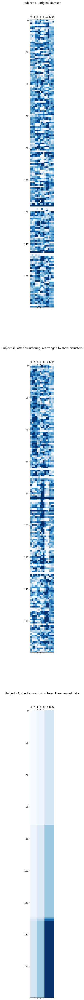

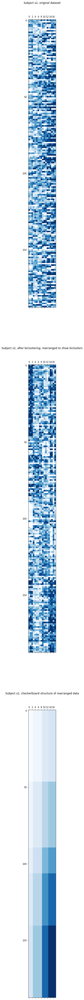

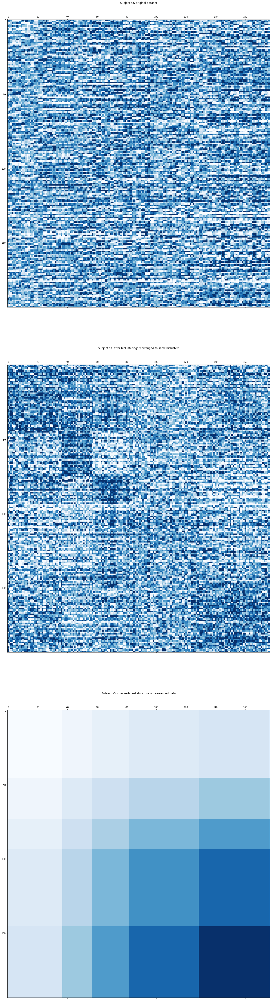

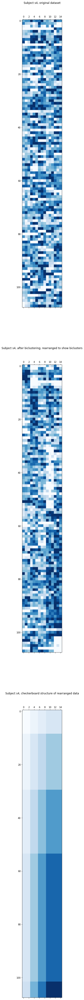

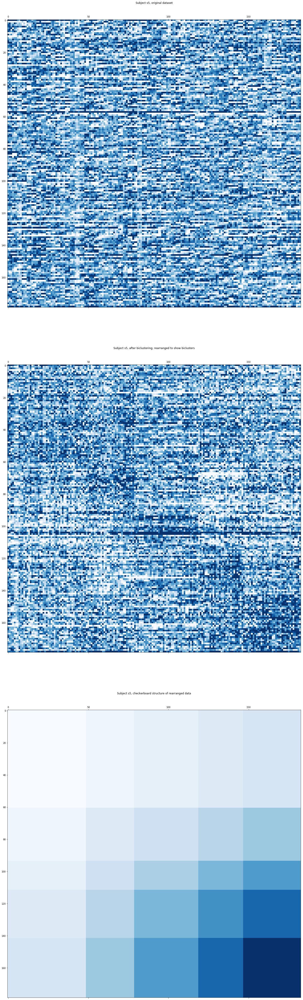

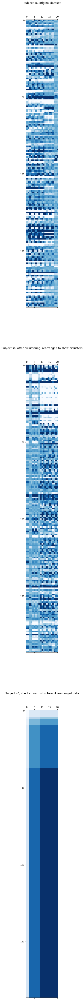

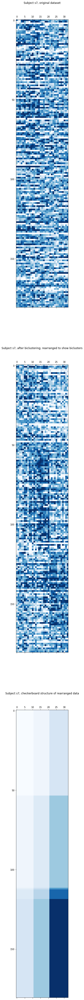

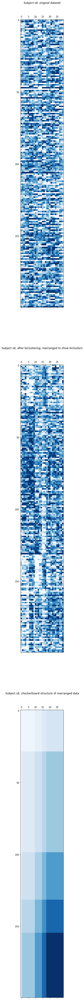

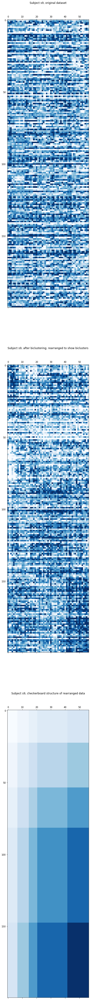

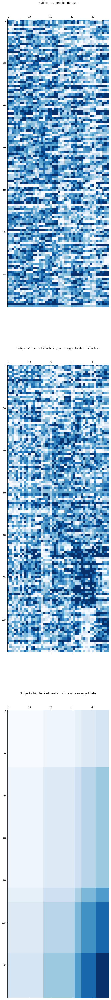

In [118]:
for s in SUBJECTS:
    data = all_datasets[(s, AFTER_OUTCOME, ALL, 3, True)] 
    row_labels, col_labels, _, _ = bicocluster(data, s_name=s, use_limits=True)
    print(s, ASR(data, row_labels, col_labels))
    arr1, arr2 = compare_first_and_last_trials(row_labels, col_labels)
    pretty_print_arrays(arr1, arr2)

80% of values closest to the mean in (-3.8805739879608154, 3.4754738807678223)
Full range: (-32.909122467041016, 62.567893981933594)
s1 0.025
[ 2.0  2.0  2.0]    [ 4.0  4.0  4.0]
[ 5.0  5.0  5.0]    [ 8.0  8.0  8.0]
[13.0 13.0 13.0]    [ 8.0  8.0  8.0]
[ 0.0  0.0  0.0]    [ 0.0  0.0  0.0]
[ 0.0  0.0  0.0]    [ 0.0  0.0  0.0]

80% of values closest to the mean in (-5.425436973571777, 4.696681499481201)
Full range: (-20.563602447509766, 15.653754234313965)
s2 0.219
[ 7.0  7.0  7.0]    [ 6.0  6.0  6.0]
[ 3.0  3.0  3.0]    [ 4.0  4.0  4.0]
[ 4.0  4.0  4.0]    [ 4.0  4.0  4.0]
[ 0.0  0.0  0.0]    [ 1.0  1.0  1.0]
[ 6.0  6.0  6.0]    [ 5.0  5.0  5.0]

80% of values closest to the mean in (-4.941554546356201, 3.865443468093872)
Full range: (-36.2177619934082, 22.06747817993164)
s3 0.204
[ 4.0  4.0  4.0  4.0]    [ 3.0  3.0  3.0  3.0]
[ 6.0  6.0  6.0  6.0]    [ 9.0  9.0  9.0  9.0]
[ 5.0  5.0  5.0  5.0]    [ 3.0  3.0  3.0  3.0]
[ 2.0  2.0  2.0  2.0]    [ 4.0  4.0  4.0  4.0]
[ 3.0  3.0  3.0  3.0]

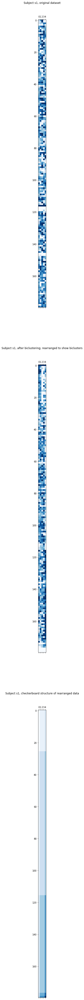

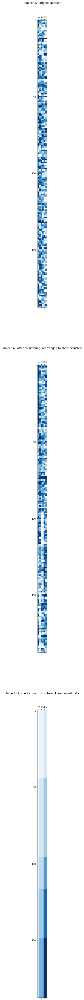

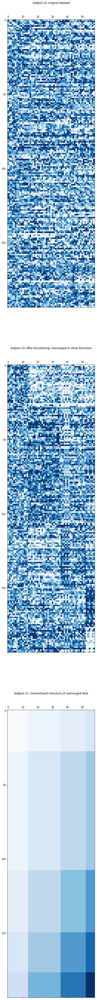

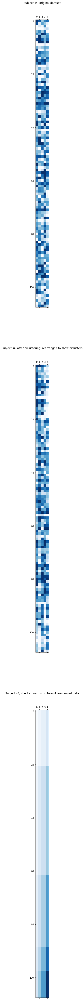

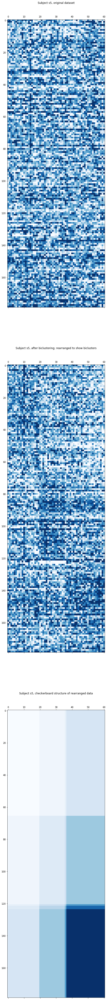

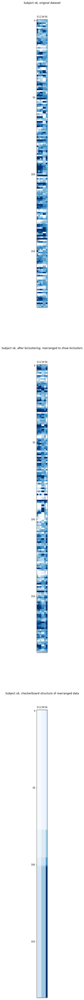

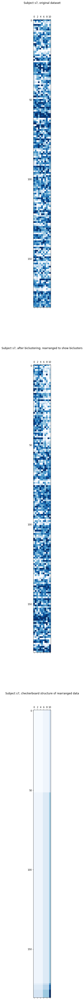

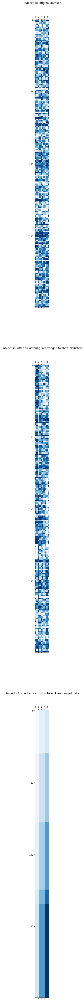

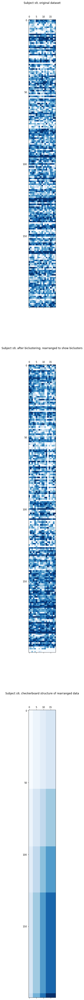

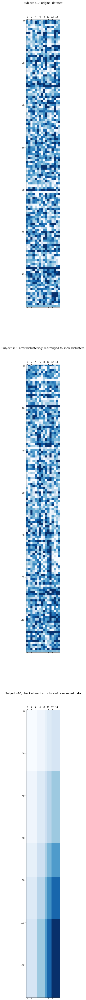

In [119]:
for s in SUBJECTS:
    data = all_datasets[(s, GAMEPRES_BUTTONPRESS, ALL, 1, True)] 
    row_labels, col_labels, _, _ = bicocluster(data, s_name=s, use_limits=True)
    print(s, ASR(data, row_labels, col_labels))    
    arr1, arr2 = compare_first_and_last_trials(row_labels, col_labels)
    pretty_print_arrays(arr1, arr2)

80% of values closest to the mean in (-4.281752586364746, 3.8459854125976562)
Full range: (-42.50403594970703, 73.88970947265625)
s1 0.222
[ 6.0  6.0  6.0]    [ 8.0  8.0  8.0]
[12.0 12.0 12.0]    [ 9.0  9.0  9.0]
[ 0.0  0.0  0.0]    [ 0.0  0.0  0.0]
[ 0.0  0.0  0.0]    [ 0.0  0.0  0.0]
[ 2.0  2.0  2.0]    [ 3.0  3.0  3.0]

80% of values closest to the mean in (-6.038040637969971, 5.360703945159912)
Full range: (-22.54741859436035, 27.882043838500977)
s2 0.408
[ 6.0  6.0  6.0  6.0]    [ 3.0  3.0  3.0  3.0]
[ 0.0  0.0  0.0  0.0]    [ 3.0  3.0  3.0  3.0]
[ 7.0  7.0  7.0  7.0]    [ 6.0  6.0  6.0  6.0]
[ 4.0  4.0  4.0  4.0]    [ 4.0  4.0  4.0  4.0]
[ 3.0  3.0  3.0  3.0]    [ 4.0  4.0  4.0  4.0]

80% of values closest to the mean in (-5.736398220062256, 4.663783073425293)
Full range: (-38.321258544921875, 38.6551628112793)
s3 0.177
[ 4.0  4.0  4.0  4.0  4.0]    [ 1.0  1.0  1.0  1.0  1.0]
[ 4.0  4.0  4.0  4.0  4.0]    [ 4.0  4.0  4.0  4.0  4.0]
[ 3.0  3.0  3.0  3.0  3.0]    [ 2.0  2.0  2.0  2

C:\Users\MariLiis\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2530: RuntimeWarning: invalid value encountered in true_divide
  c /= stddev[:, None]
C:\Users\MariLiis\Anaconda3\lib\site-packages\numpy\lib\function_base.py:2531: RuntimeWarning: invalid value encountered in true_divide
  c /= stddev[None, :]
C:\Users\MariLiis\Anaconda3\lib\site-packages\scipy\stats\_distn_infrastructure.py:877: RuntimeWarning: invalid value encountered in greater
  return (self.a < x) & (x < self.b)
C:\Users\MariLiis\Anaconda3\lib\site-packages\scipy\stats\_distn_infrastructure.py:877: RuntimeWarning: invalid value encountered in less
  return (self.a < x) & (x < self.b)
C:\Users\MariLiis\Anaconda3\lib\site-packages\scipy\stats\_distn_infrastructure.py:1831: RuntimeWarning: invalid value encountered in less_equal
  cond2 = cond0 & (x <= self.a)


s10 0.299
[ 4.0  4.0  4.0  4.0  4.0]    [ 3.0  3.0  3.0  3.0  3.0]
[ 4.0  4.0  4.0  4.0  4.0]    [ 8.0  8.0  8.0  8.0  8.0]
[ 1.0  1.0  1.0  1.0  1.0]    [ 3.0  3.0  3.0  3.0  3.0]
[ 7.0  7.0  7.0  7.0  7.0]    [ 5.0  5.0  5.0  5.0  5.0]
[ 4.0  4.0  4.0  4.0  4.0]    [ 1.0  1.0  1.0  1.0  1.0]



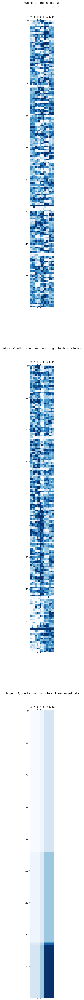

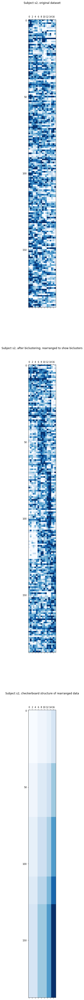

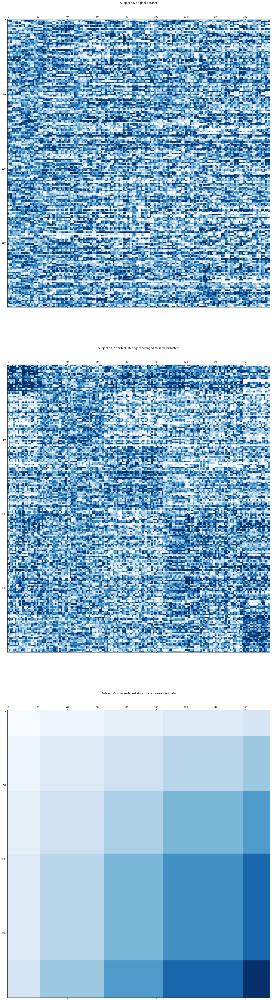

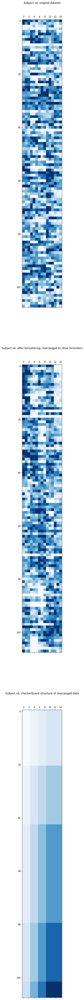

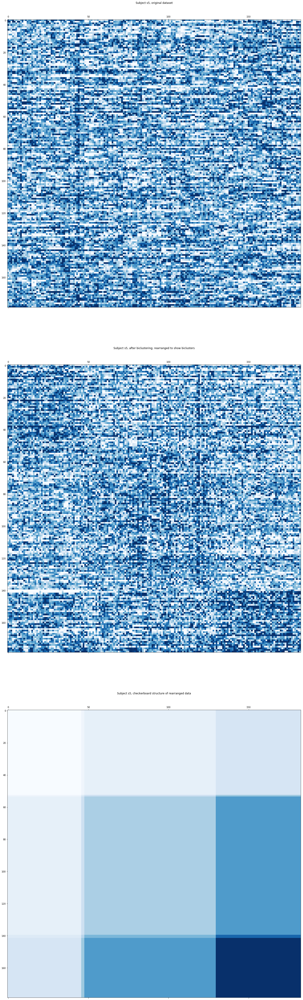

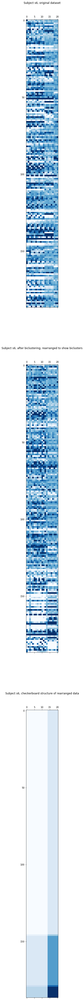

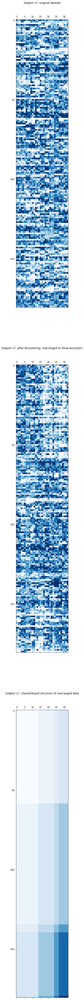

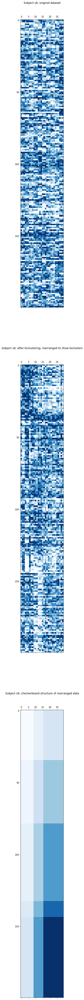

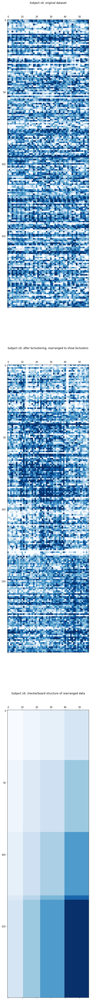

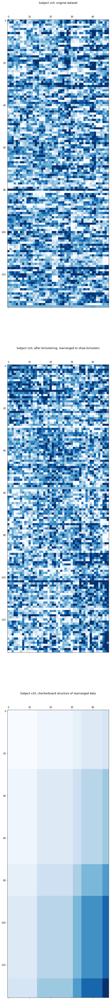

In [120]:
for s in SUBJECTS:
    data = all_datasets[(s, GAMEPRES_BUTTONPRESS, ALL, 3, True)] 
    row_labels, col_labels, _, _ = bicocluster(data, s_name=s, use_limits=True)
    print(s, ASR(data, row_labels, col_labels)) 
    arr1, arr2 = compare_first_and_last_trials(row_labels, col_labels)
    pretty_print_arrays(arr1, arr2)

### 4. Specific tests with subject 9

C:\Users\MariLiis\Anaconda3\lib\site-packages\sklearn\cluster\bicluster.py:480: FutureWarning: arrays to stack must be passed as a "sequence" type such as list or tuple. Support for non-sequence iterables such as generators is deprecated as of NumPy 1.16 and will raise an error in the future.
  for label in range(n_row_clusters)
C:\Users\MariLiis\Anaconda3\lib\site-packages\sklearn\cluster\bicluster.py:483: FutureWarning: arrays to stack must be passed as a "sequence" type such as list or tuple. Support for non-sequence iterables such as generators is deprecated as of NumPy 1.16 and will raise an error in the future.
  for _ in range(n_row_clusters)


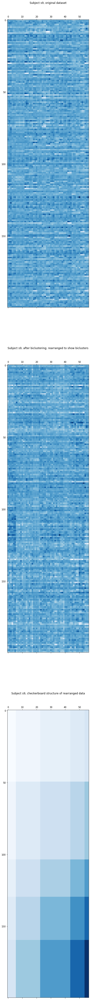

In [220]:
row_labels1, col_labels1, rows1, cols1 = spectral_bicluster(data_s9_2, n_clusters=(5,5), s_name='s9')

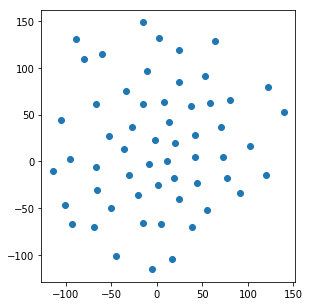

In [106]:
show_tsne_plot(data_s9_2.T, plot_trials=False)

In [223]:
behavior_data['s9'].iloc[np.argsort(row_labels1)[100:125]]

,round,newround.time,choice.time,buttonpress.time,conf.time,reveal.time,choice.class,choice.location,outcome,trial.included
78,79,916.025,916.718,917.806,917.827,917.849,Gamble,Right,Win,1
79,80,918.867,919.561,921.453,921.475,921.497,Safebet,Right,WouldHaveLost,1
0,1,674.234,674.928,675.900,675.921,675.942,Gamble,Left,Win,1
86,87,940.635,941.329,942.496,942.518,942.540,Gamble,Right,Win,1
136,137,1098.325,1099.018,1099.940,1099.961,1099.984,Safebet,Left,WouldHaveLost,1
124,125,1061.777,1062.470,1063.708,1063.729,1063.752,Safebet,Left,WouldHaveLost,1
58,59,854.419,855.114,856.578,856.599,856.621,Gamble,Left,Win,1
127,128,1071.790,1072.484,1074.426,1074.447,1074.470,Safebet,Left,WouldHaveWon,1
128,129,1075.488,1076.182,1077.338,1077.360,1077.383,Safebet,Right,WouldHaveLost,1
42,43,806.281,806.975,807.961,807.982,808.005,Safebet,Left,WouldHaveLost,1


In [225]:
elecs = np.array([["tw1_elec" + str(i), "tw2_elec" + str(i), "tw3_elec" + str(i)] for i in range(1, fr.N_ELEC['s9'] + 1)]).flatten()
elecs

array(['tw1_elec1', 'tw2_elec1', 'tw3_elec1', 'tw1_elec2', 'tw2_elec2',
       'tw3_elec2', 'tw1_elec3', 'tw2_elec3', 'tw3_elec3', 'tw1_elec4',
       'tw2_elec4', 'tw3_elec4', 'tw1_elec5', 'tw2_elec5', 'tw3_elec5',
       'tw1_elec6', 'tw2_elec6', 'tw3_elec6', 'tw1_elec7', 'tw2_elec7',
       'tw3_elec7', 'tw1_elec8', 'tw2_elec8', 'tw3_elec8', 'tw1_elec9',
       'tw2_elec9', 'tw3_elec9', 'tw1_elec10', 'tw2_elec10', 'tw3_elec10',
       'tw1_elec11', 'tw2_elec11', 'tw3_elec11', 'tw1_elec12',
       'tw2_elec12', 'tw3_elec12', 'tw1_elec13', 'tw2_elec13',
       'tw3_elec13', 'tw1_elec14', 'tw2_elec14', 'tw3_elec14',
       'tw1_elec15', 'tw2_elec15', 'tw3_elec15', 'tw1_elec16',
       'tw2_elec16', 'tw3_elec16', 'tw1_elec17', 'tw2_elec17',
       'tw3_elec17', 'tw1_elec18', 'tw2_elec18', 'tw3_elec18',
       'tw1_elec19', 'tw2_elec19', 'tw3_elec19'], dtype='<U10')

In [226]:
elecs[np.argsort(col_labels1)[0:6]]

array(['tw3_elec19', 'tw3_elec11', 'tw3_elec7', 'tw3_elec5', 'tw3_elec15',
       'tw3_elec1'], dtype='<U10')

C:\Users\MariLiis\Anaconda3\lib\site-packages\sklearn\cluster\bicluster.py:296: FutureWarning: arrays to stack must be passed as a "sequence" type such as list or tuple. Support for non-sequence iterables such as generators is deprecated as of NumPy 1.16 and will raise an error in the future.
  for c in range(self.n_clusters))
C:\Users\MariLiis\Anaconda3\lib\site-packages\sklearn\cluster\bicluster.py:298: FutureWarning: arrays to stack must be passed as a "sequence" type such as list or tuple. Support for non-sequence iterables such as generators is deprecated as of NumPy 1.16 and will raise an error in the future.
  for c in range(self.n_clusters))


(array([3, 3, 0, 2, 3, 3, 3, 2, 0, 1, 0, 4, 4, 4, 4, 1, 3, 1, 3, 3, 1, 3,
        0, 2, 3, 3, 2, 4, 4, 3, 1, 2, 0, 2, 3, 1, 3, 1, 2, 0, 2, 2, 4, 2,
        4, 3, 1, 3, 3, 3, 4, 3, 1, 3, 3, 3, 3, 0, 4, 1, 3, 3, 1, 2, 2, 3,
        4, 3, 0, 3, 3, 0, 3, 0, 2, 4, 4, 3, 4, 1, 3, 2, 3, 3, 1, 2, 1, 0,
        4, 3, 3, 4, 2, 4, 4, 3, 4, 4, 0, 3, 3, 0, 1, 2, 1, 3, 1, 2, 4, 4,
        0, 3, 3, 1, 0, 2, 3, 2, 3, 3, 0, 4, 3, 4, 4, 4, 3, 4, 4, 4, 0, 2,
        1, 3, 1, 4, 4, 4, 1, 2, 3, 1, 3, 3, 4, 3, 3, 2, 4, 4, 3, 1, 4, 1,
        4, 4, 0, 2, 0, 3, 4, 4, 0, 2, 1, 3, 3, 3, 1, 4, 4, 2, 0, 4, 4, 4,
        4, 3, 3, 3, 1, 4, 2, 4, 4, 3, 3, 3, 1, 0, 3, 2, 4, 3, 0, 1, 1, 4,
        4, 1]),
 array([3, 3, 4, 3, 0, 4, 3, 3, 1, 3, 3, 1, 3, 0, 4, 3, 0, 1, 3, 3, 4, 3,
        3, 4, 3, 1, 1, 2, 2, 2, 3, 4, 4, 3, 0, 4, 2, 2, 2, 3, 1, 1, 3, 4,
        4, 3, 4, 1, 3, 4, 4, 0, 0, 0, 3, 4, 4]))

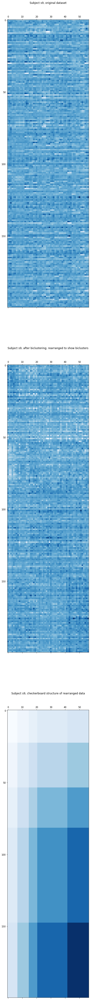

In [219]:
bicocluster(data_s9_2, n_clusters=5, s_name='s9')

C:\Users\MariLiis\Anaconda3\lib\site-packages\sklearn\cluster\bicluster.py:480: FutureWarning: arrays to stack must be passed as a "sequence" type such as list or tuple. Support for non-sequence iterables such as generators is deprecated as of NumPy 1.16 and will raise an error in the future.
  for label in range(n_row_clusters)
C:\Users\MariLiis\Anaconda3\lib\site-packages\sklearn\cluster\bicluster.py:483: FutureWarning: arrays to stack must be passed as a "sequence" type such as list or tuple. Support for non-sequence iterables such as generators is deprecated as of NumPy 1.16 and will raise an error in the future.
  for _ in range(n_row_clusters)


(array([ 7,  7, 13,  8,  7,  3,  7,  8, 12,  0,  5,  8,  7,  3,  8,  3,  7,
         0,  7,  6,  5,  1,  2,  7,  4, 13,  0,  7,  0,  2, 10,  6,  4,  6,
         1,  5,  7, 12,  9,  5, 14,  9,  3,  8, 13,  1,  0,  7, 13,  3,  7,
         2, 11, 13,  6,  7,  3,  5,  1,  0, 13,  3,  4, 14,  6,  7,  7,  3,
         7,  3, 13,  3,  1,  5, 14, 14,  9,  6, 13,  0,  6,  8,  7,  1,  5,
         8,  9,  4,  6,  7,  6, 13, 14,  6,  0,  7, 14,  9,  4,  7,  3, 13,
         0,  6,  0,  6,  0,  0,  7, 13,  4, 13,  6,  0,  2,  3,  7, 11,  7,
         7,  4,  7,  7,  9,  7,  7,  3,  9, 14, 14,  5,  8,  5,  6,  7,  9,
         7,  7,  0, 14,  2,  0,  7,  7,  9,  3,  7, 14,  7,  7,  7,  0,  1,
         5, 14,  0,  4,  3,  5,  3, 14,  0,  5, 14,  0,  6,  7, 13,  0,  1,
         7,  9,  5,  8,  7,  7,  0,  1,  7,  7,  0,  3,  6,  6,  7,  9,  1,
         0,  4,  4,  1, 14,  0,  7,  2,  0,  0, 13,  3,  0]),
 array([13,  2, 12,  6,  1,  9,  6,  6,  9,  6,  6,  9,  5,  2,  3,  4,  1,
        11,  5,  5,  3,  4

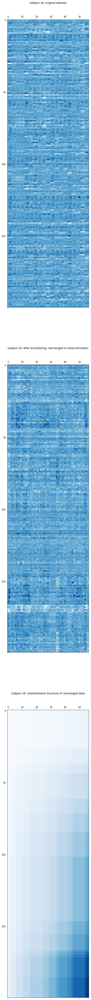

In [153]:
spectral_bicluster(data_s9_2, n_clusters=(15,15), s_name='s9', n_components=8, n_best=4)

C:\Users\MariLiis\Anaconda3\lib\site-packages\sklearn\cluster\bicluster.py:480: FutureWarning: arrays to stack must be passed as a "sequence" type such as list or tuple. Support for non-sequence iterables such as generators is deprecated as of NumPy 1.16 and will raise an error in the future.
  for label in range(n_row_clusters)
C:\Users\MariLiis\Anaconda3\lib\site-packages\sklearn\cluster\bicluster.py:483: FutureWarning: arrays to stack must be passed as a "sequence" type such as list or tuple. Support for non-sequence iterables such as generators is deprecated as of NumPy 1.16 and will raise an error in the future.
  for _ in range(n_row_clusters)


(array([2, 1, 2, 1, 1, 1, 2, 1, 0, 2, 2, 0, 0, 2, 0, 2, 1, 2, 2, 1, 2, 1,
        2, 1, 2, 2, 2, 2, 0, 2, 2, 1, 2, 1, 1, 2, 2, 1, 2, 2, 1, 2, 0, 1,
        2, 1, 2, 2, 2, 1, 0, 1, 1, 2, 1, 2, 1, 2, 0, 2, 2, 1, 2, 1, 1, 1,
        2, 1, 2, 1, 2, 2, 1, 2, 1, 0, 0, 1, 2, 0, 1, 1, 2, 1, 2, 1, 2, 0,
        0, 2, 1, 2, 1, 0, 0, 2, 0, 2, 2, 1, 1, 2, 0, 1, 2, 1, 2, 1, 2, 2,
        2, 2, 1, 2, 0, 1, 2, 1, 2, 2, 2, 2, 1, 0, 0, 2, 1, 0, 0, 1, 2, 1,
        2, 1, 2, 2, 0, 1, 2, 1, 1, 2, 2, 1, 2, 1, 1, 1, 0, 2, 2, 2, 0, 2,
        0, 2, 1, 1, 2, 1, 0, 0, 2, 1, 2, 0, 1, 2, 1, 0, 2, 2, 2, 0, 2, 2,
        0, 1, 2, 1, 2, 2, 1, 0, 0, 2, 1, 2, 2, 2, 1, 1, 0, 1, 2, 2, 2, 2,
        0, 2]),
 array([2, 2, 2, 1, 1, 0, 1, 1, 1, 1, 1, 1, 2, 2, 0, 4, 0, 0, 4, 4, 0, 1,
        3, 0, 4, 0, 0, 4, 4, 1, 4, 3, 0, 3, 3, 3, 4, 3, 0, 1, 3, 0, 3, 3,
        0, 1, 3, 1, 3, 3, 0, 0, 0, 0, 4, 3, 0]))

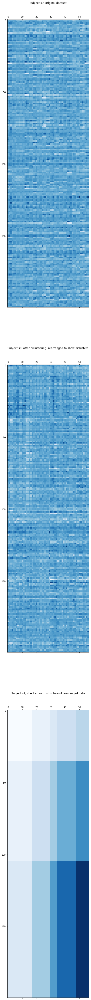

In [154]:
spectral_bicluster(data_s9_2, n_clusters=(3,5), s_name='s9', n_components=8, n_best=4)

C:\Users\MariLiis\Anaconda3\lib\site-packages\sklearn\cluster\bicluster.py:480: FutureWarning: arrays to stack must be passed as a "sequence" type such as list or tuple. Support for non-sequence iterables such as generators is deprecated as of NumPy 1.16 and will raise an error in the future.
  for label in range(n_row_clusters)
C:\Users\MariLiis\Anaconda3\lib\site-packages\sklearn\cluster\bicluster.py:483: FutureWarning: arrays to stack must be passed as a "sequence" type such as list or tuple. Support for non-sequence iterables such as generators is deprecated as of NumPy 1.16 and will raise an error in the future.
  for _ in range(n_row_clusters)


(array([0, 0, 3, 4, 0, 3, 2, 0, 4, 2, 0, 0, 0, 0, 0, 2, 0, 2, 0, 4, 2, 4,
        3, 0, 0, 3, 0, 0, 2, 3, 1, 4, 0, 4, 4, 2, 0, 1, 0, 2, 4, 2, 0, 0,
        3, 4, 2, 3, 3, 0, 0, 3, 1, 3, 4, 2, 0, 3, 4, 2, 3, 3, 2, 3, 4, 0,
        0, 4, 0, 4, 3, 3, 4, 3, 4, 4, 2, 4, 3, 2, 4, 4, 0, 4, 2, 4, 2, 2,
        4, 0, 4, 3, 4, 0, 2, 0, 3, 0, 2, 0, 0, 3, 0, 4, 0, 4, 2, 0, 0, 3,
        3, 3, 4, 2, 4, 4, 0, 1, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 4, 3, 4,
        2, 4, 0, 2, 0, 0, 2, 4, 4, 2, 0, 0, 2, 0, 0, 4, 0, 0, 3, 2, 4, 2,
        4, 2, 0, 0, 3, 3, 4, 2, 3, 4, 2, 4, 0, 3, 1, 4, 0, 0, 3, 4, 0, 0,
        0, 4, 0, 0, 0, 3, 0, 0, 0, 0, 4, 0, 2, 0, 4, 4, 2, 4, 0, 2, 2, 3,
        3, 2]),
 array([1, 1, 1, 2, 2, 0, 2, 2, 0, 2, 2, 0, 1, 1, 0, 2, 2, 0, 1, 1, 0, 2,
        2, 0, 2, 2, 0, 2, 0, 0, 2, 1, 0, 2, 2, 0, 2, 2, 0, 2, 2, 0, 1, 1,
        0, 2, 2, 0, 2, 2, 0, 2, 2, 0, 1, 1, 0]))

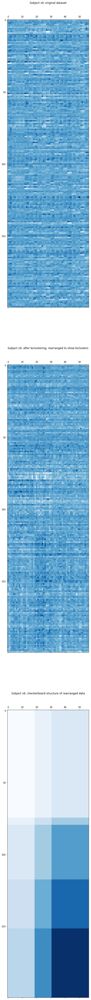

In [155]:
spectral_bicluster(data_s9_2, n_clusters=(5,3), s_name='s9', n_components=8, n_best=4)

C:\Users\MariLiis\Anaconda3\lib\site-packages\sklearn\cluster\bicluster.py:480: FutureWarning: arrays to stack must be passed as a "sequence" type such as list or tuple. Support for non-sequence iterables such as generators is deprecated as of NumPy 1.16 and will raise an error in the future.
  for label in range(n_row_clusters)
C:\Users\MariLiis\Anaconda3\lib\site-packages\sklearn\cluster\bicluster.py:483: FutureWarning: arrays to stack must be passed as a "sequence" type such as list or tuple. Support for non-sequence iterables such as generators is deprecated as of NumPy 1.16 and will raise an error in the future.
  for _ in range(n_row_clusters)


(array([0, 0, 1, 1, 0, 0, 1, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1,
        1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1,
        0, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 1,
        0, 0, 1, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 1, 0, 1, 1, 0, 0, 1, 0,
        0, 1, 0, 1, 1, 0, 0]),
 array([3, 1, 4, 3, 1, 0, 3, 3, 3, 3, 3, 3, 2, 2, 2, 1, 0, 0, 3, 4, 4, 3,
        1, 0, 3, 0, 4, 5, 5, 5, 3, 3, 4, 1, 1, 0, 3, 1, 1, 3, 1, 1, 1, 0,
        0, 3, 3, 3, 3, 1, 0, 1, 0, 0, 3, 4, 4]))

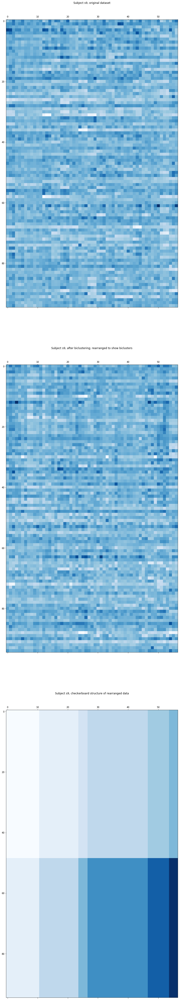

In [185]:
spectral_bicluster(data_s9_wins_losses, n_clusters=(2,6), s_name='s9')

C:\Users\MariLiis\Anaconda3\lib\site-packages\sklearn\cluster\bicluster.py:480: FutureWarning: arrays to stack must be passed as a "sequence" type such as list or tuple. Support for non-sequence iterables such as generators is deprecated as of NumPy 1.16 and will raise an error in the future.
  for label in range(n_row_clusters)
C:\Users\MariLiis\Anaconda3\lib\site-packages\sklearn\cluster\bicluster.py:483: FutureWarning: arrays to stack must be passed as a "sequence" type such as list or tuple. Support for non-sequence iterables such as generators is deprecated as of NumPy 1.16 and will raise an error in the future.
  for _ in range(n_row_clusters)


(array([1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0,
        0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 0,
        1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 0, 0,
        1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1,
        1, 0, 1, 0, 0, 1, 1]),
 array([1, 1, 5, 1, 1, 5, 1, 1, 5, 1, 1, 5, 4, 4, 4, 3, 3, 3, 3, 3, 2, 1,
        1, 5, 0, 0, 0, 3, 3, 2, 1, 1, 5, 1, 1, 5, 1, 1, 5, 1, 3, 3]))

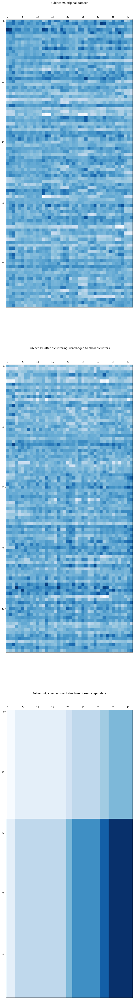

In [199]:
spectral_bicluster(data_s9_wins_losses_2, n_clusters=(2,6), s_name='s9')

C:\Users\MariLiis\Anaconda3\lib\site-packages\sklearn\cluster\bicluster.py:480: FutureWarning: arrays to stack must be passed as a "sequence" type such as list or tuple. Support for non-sequence iterables such as generators is deprecated as of NumPy 1.16 and will raise an error in the future.
  for label in range(n_row_clusters)
C:\Users\MariLiis\Anaconda3\lib\site-packages\sklearn\cluster\bicluster.py:483: FutureWarning: arrays to stack must be passed as a "sequence" type such as list or tuple. Support for non-sequence iterables such as generators is deprecated as of NumPy 1.16 and will raise an error in the future.
  for _ in range(n_row_clusters)


(array([2, 2, 0, 1, 2, 2, 1, 1, 1, 1, 2, 0, 1, 2, 0, 1, 1, 2, 1, 0, 2, 1,
        1, 1, 2, 0, 0, 0, 1, 0, 0, 3, 1, 1, 0, 1, 1, 1, 2, 0, 2, 1, 1, 0,
        2, 1, 2, 2, 0, 0, 2, 2, 0, 0, 1, 0, 2, 1, 3, 0, 1, 2, 2, 2, 0, 1,
        1, 2, 0, 2, 2, 2, 0, 2, 1, 2, 0, 2, 2, 1, 0, 1, 0, 0, 1, 2, 1, 2,
        1, 0, 2, 1, 0, 1, 2]),
 array([ 9,  9,  0,  6,  9,  0,  6,  6,  0,  6,  6,  0,  4,  4,  5,  8,  8,
         3, 11, 11, 10,  9,  9,  0,  7,  7,  2,  3,  3, 10,  8,  9,  0,  9,
         9,  0,  1,  1,  3,  8,  8,  3]))

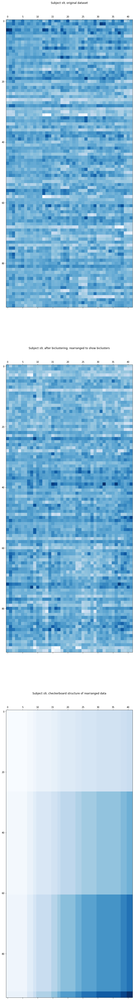

In [207]:
spectral_bicluster(data_s9_wins_losses_2, n_clusters=(4,12), s_name='s9')

C:\Users\MariLiis\Anaconda3\lib\site-packages\sklearn\cluster\bicluster.py:296: FutureWarning: arrays to stack must be passed as a "sequence" type such as list or tuple. Support for non-sequence iterables such as generators is deprecated as of NumPy 1.16 and will raise an error in the future.
  for c in range(self.n_clusters))
C:\Users\MariLiis\Anaconda3\lib\site-packages\sklearn\cluster\bicluster.py:298: FutureWarning: arrays to stack must be passed as a "sequence" type such as list or tuple. Support for non-sequence iterables such as generators is deprecated as of NumPy 1.16 and will raise an error in the future.
  for c in range(self.n_clusters))


(array([0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1,
        1, 0, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 1, 0, 0, 0, 1,
        0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 0, 0, 0, 0, 1, 1,
        1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0,
        0, 1, 0, 0, 1, 0, 0]),
 array([0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1,
        0, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1]))

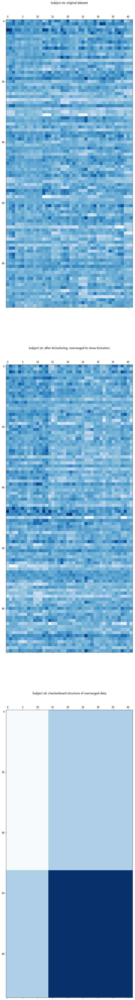

In [213]:
bicocluster(data_s9_wins_losses_2, n_clusters=2, s_name='s9')

C:\Users\MariLiis\Anaconda3\lib\site-packages\sklearn\cluster\bicluster.py:296: FutureWarning: arrays to stack must be passed as a "sequence" type such as list or tuple. Support for non-sequence iterables such as generators is deprecated as of NumPy 1.16 and will raise an error in the future.
  for c in range(self.n_clusters))
C:\Users\MariLiis\Anaconda3\lib\site-packages\sklearn\cluster\bicluster.py:298: FutureWarning: arrays to stack must be passed as a "sequence" type such as list or tuple. Support for non-sequence iterables such as generators is deprecated as of NumPy 1.16 and will raise an error in the future.
  for c in range(self.n_clusters))


(array([0, 0, 2, 2, 0, 0, 2, 0, 2, 2, 0, 2, 0, 0, 1, 0, 0, 0, 2, 1, 1, 2,
        2, 0, 0, 2, 1, 1, 0, 2, 1, 2, 0, 1, 1, 2, 2, 0, 0, 1, 0, 2, 2, 2,
        0, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 1, 2, 2, 0, 2, 0, 0, 0, 0, 1, 1,
        0, 0, 1, 2, 0, 0, 1, 0, 2, 0, 1, 0, 0, 0, 1, 0, 2, 2, 0, 0, 2, 0,
        2, 2, 0, 2, 1, 0, 0]),
 array([2, 0, 0, 2, 2, 0, 2, 2, 2, 2, 2, 0, 2, 0, 1, 2, 2, 1, 2, 0, 0, 2,
        0, 0, 1, 1, 1, 2, 0, 0, 2, 0, 0, 2, 1, 1, 2, 0, 0, 2, 2, 1]))

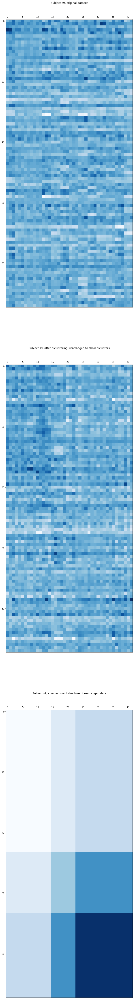

In [214]:
bicocluster(data_s9_wins_losses_2, n_clusters=3, s_name='s9')

C:\Users\MariLiis\Anaconda3\lib\site-packages\sklearn\cluster\bicluster.py:296: FutureWarning: arrays to stack must be passed as a "sequence" type such as list or tuple. Support for non-sequence iterables such as generators is deprecated as of NumPy 1.16 and will raise an error in the future.
  for c in range(self.n_clusters))
C:\Users\MariLiis\Anaconda3\lib\site-packages\sklearn\cluster\bicluster.py:298: FutureWarning: arrays to stack must be passed as a "sequence" type such as list or tuple. Support for non-sequence iterables such as generators is deprecated as of NumPy 1.16 and will raise an error in the future.
  for c in range(self.n_clusters))


(array([1, 1, 0, 0, 2, 2, 0, 1, 0, 0, 2, 0, 2, 2, 1, 2, 1, 1, 1, 1, 1, 0,
        0, 1, 1, 0, 3, 3, 2, 0, 3, 0, 1, 1, 3, 0, 0, 1, 2, 3, 2, 0, 0, 0,
        2, 2, 2, 2, 3, 3, 2, 1, 1, 1, 1, 3, 0, 0, 1, 0, 1, 1, 1, 2, 3, 1,
        1, 1, 3, 0, 2, 1, 3, 2, 0, 2, 3, 2, 2, 1, 1, 1, 0, 0, 2, 2, 0, 2,
        0, 0, 2, 0, 1, 1, 2]),
 array([0, 2, 2, 0, 1, 1, 0, 0, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1, 2, 2, 2, 0,
        1, 1, 3, 3, 3, 0, 2, 2, 1, 1, 1, 0, 1, 1, 2, 2, 2, 0, 0, 3]))

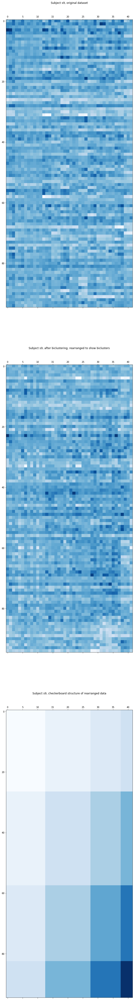

In [215]:
bicocluster(data_s9_wins_losses_2, n_clusters=4, s_name='s9')

C:\Users\MariLiis\Anaconda3\lib\site-packages\sklearn\cluster\bicluster.py:296: FutureWarning: arrays to stack must be passed as a "sequence" type such as list or tuple. Support for non-sequence iterables such as generators is deprecated as of NumPy 1.16 and will raise an error in the future.
  for c in range(self.n_clusters))
C:\Users\MariLiis\Anaconda3\lib\site-packages\sklearn\cluster\bicluster.py:298: FutureWarning: arrays to stack must be passed as a "sequence" type such as list or tuple. Support for non-sequence iterables such as generators is deprecated as of NumPy 1.16 and will raise an error in the future.
  for c in range(self.n_clusters))


(array([2, 4, 1, 1, 0, 0, 1, 3, 0, 3, 0, 1, 0, 0, 3, 0, 4, 2, 3, 4, 4, 3,
        1, 4, 4, 1, 3, 3, 0, 1, 3, 1, 4, 3, 3, 1, 1, 4, 2, 3, 0, 2, 0, 3,
        0, 2, 0, 0, 3, 3, 4, 2, 0, 4, 2, 3, 1, 1, 4, 3, 0, 2, 4, 0, 3, 3,
        4, 4, 4, 1, 4, 2, 3, 0, 0, 2, 3, 2, 2, 2, 3, 0, 3, 1, 0, 2, 2, 0,
        0, 3, 2, 1, 3, 0, 2]),
 array([0, 0, 2, 1, 3, 3, 1, 4, 4, 1, 4, 4, 3, 2, 2, 1, 3, 3, 0, 0, 2, 1,
        0, 2, 4, 4, 4, 0, 0, 2, 4, 4, 4, 4, 4, 4, 0, 2, 2, 1, 3, 3]))

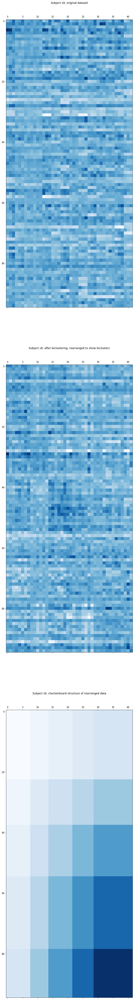

In [216]:
bicocluster(data_s9_wins_losses_2, n_clusters=5, s_name='s9')

C:\Users\MariLiis\Anaconda3\lib\site-packages\sklearn\cluster\bicluster.py:296: FutureWarning: arrays to stack must be passed as a "sequence" type such as list or tuple. Support for non-sequence iterables such as generators is deprecated as of NumPy 1.16 and will raise an error in the future.
  for c in range(self.n_clusters))
C:\Users\MariLiis\Anaconda3\lib\site-packages\sklearn\cluster\bicluster.py:298: FutureWarning: arrays to stack must be passed as a "sequence" type such as list or tuple. Support for non-sequence iterables such as generators is deprecated as of NumPy 1.16 and will raise an error in the future.
  for c in range(self.n_clusters))


(array([7, 1, 3, 0, 6, 1, 3, 4, 3, 4, 1, 3, 1, 8, 7, 6, 1, 7, 4, 4, 1, 3,
        3, 1, 4, 3, 7, 2, 1, 8, 2, 5, 4, 4, 2, 0, 3, 1, 6, 7, 1, 7, 1, 3,
        6, 6, 1, 1, 2, 4, 1, 4, 1, 8, 4, 2, 3, 3, 8, 3, 1, 7, 1, 6, 2, 4,
        1, 1, 2, 3, 1, 7, 2, 6, 0, 6, 2, 6, 6, 1, 7, 1, 4, 3, 1, 7, 7, 6,
        3, 3, 7, 3, 2, 4, 6]),
 array([0, 0, 6, 3, 7, 7, 8, 8, 8, 8, 8, 8, 4, 4, 4, 3, 7, 7, 0, 6, 6, 3,
        1, 7, 4, 4, 4, 0, 6, 6, 1, 1, 1, 1, 1, 8, 0, 6, 6, 3, 7, 7]))

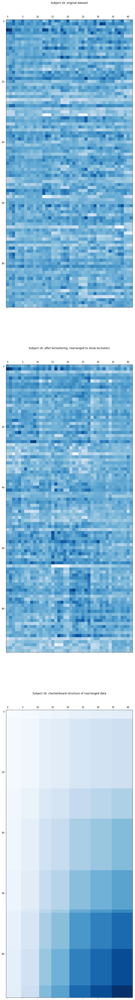

In [217]:
bicocluster(data_s9_wins_losses_2, n_clusters=9, s_name='s9')

### 5. Coclustering results when testing different parameters and datasets

These results were obtained by running coclustering.ipynb.

In [4]:
cocluster_results = load_var("cocluster_results_2")

In [367]:
sorted_results_cocl = sorted(cocluster_results.items(), key=lambda x: x[1][0], reverse=True)
sorted_list = list(map(lambda x: (x[0], x[1][0]), sorted_results_cocl))
list(filter(lambda x: x[0][4], sorted_list))[:10]  # filter: use_all_electodes = True

[(('s6', '1.5s after outcome reveal', 'all', 1, True, 3, 'arpack'), 0.915),
 (('s6',
   'between game presentation and buttonpress',
   'win',
   1,
   True,
   3,
   'arpack'),
  0.89),
 (('s6',
   'between game presentation and buttonpress',
   'win',
   1,
   True,
   4,
   'arpack'),
  0.87),
 (('s6', '1.5s after outcome reveal', 'all', 2, True, 2, 'randomized'), 0.841),
 (('s6', '1.5s after outcome reveal', 'all', 3, True, 6, 'arpack'), 0.824),
 (('s6',
   'between game presentation and buttonpress',
   'all',
   1,
   True,
   2,
   'randomized'),
  0.813),
 (('s6', '1.5s after outcome reveal', 'all', 2, True, 3, 'arpack'), 0.802),
 (('s6', '1.5s after outcome reveal', 'all', 3, True, 3, 'randomized'), 0.766),
 (('s6',
   'between game presentation and buttonpress',
   'win',
   2,
   True,
   3,
   'arpack'),
  0.765),
 (('s6', '1.5s after outcome reveal', 'gamble', 2, True, 3, 'arpack'), 0.758)]

In [161]:
result_statistics_cocl = defaultdict(lambda: defaultdict(float))
counts_cocl = defaultdict(lambda: defaultdict(int))  # we need to count occurrences bc some results were nan

for item in sorted_results_2:
    params, res = item
    asr, _, _, _, _ = res
    s, tw_type, trial_type, tw_per_el, use_all_els, n_clusters, svd_method = params
    
    result_statistics_cocl['subjects'][s] += asr
    counts_cocl['subjects'][s] += 1 
    result_statistics_cocl['tw_type'][tw_type] += asr
    counts_cocl['tw_type'][tw_type] += 1
    result_statistics_cocl['trial_type'][trial_type] += asr
    counts_cocl['trial_type'][trial_type] += 1
    result_statistics_cocl['tw_per_el'][tw_per_el] += asr
    counts_cocl['tw_per_el'][tw_per_el] += 1
    result_statistics_cocl['use_all_els'][use_all_els] += asr
    counts_cocl['use_all_els'][use_all_els] += 1
    result_statistics_cocl['n_clusters'][n_clusters] += asr 
    counts_cocl['n_clusters'][n_clusters] += 1
    result_statistics_cocl['svd_method'][svd_method] += asr 
    counts_cocl['svd_method'][svd_method] += 1
    result_statistics_cocl['combo'][(tw_type, trial_type, tw_per_el, use_all_els, n_clusters, svd_method)] += asr
    counts_cocl['combo'][(tw_type, trial_type, tw_per_el, use_all_els, n_clusters, svd_method)] += 1

for key1 in result_statistics_cocl:
    for key2 in result_statistics_cocl[key1]:
        result_statistics_cocl[key1][key2] /= counts_cocl[key1][key2]

In [162]:
sorted(result_statistics_cocl['subjects'].items(), key=lambda x: x[1], reverse=True)

[('s6', 0.4620357142857144),
 ('s9', 0.4409490131578944),
 ('s4', 0.38976442307692327),
 ('s7', 0.3500324074074076),
 ('s2', 0.33797596153846166),
 ('s8', 0.3213802083333332),
 ('s1', 0.28522115384615376),
 ('s10', 0.27778448275862094),
 ('s5', 0.27496607142857127),
 ('s3', 0.1891185897435902)]

In [163]:
sorted(result_statistics_cocl['n_clusters'].items(), key=lambda x: x[1], reverse=True)

[(5, 0.3534712837837842),
 (3, 0.3332127403846154),
 (4, 0.3304912790697676),
 (7, 0.31931249999999994),
 (6, 0.3181874999999998),
 (2, 0.3053749999999998),
 (8, 0.3052434210526315)]

In [164]:
sorted(result_statistics_cocl['combo'].items(), key=lambda x: x[1], reverse=True)[:5]

[(('between game presentation and buttonpress',
   'win',
   3,
   False,
   5,
   'randomized'),
  0.5235),
 (('between game presentation and buttonpress',
   'win',
   2,
   False,
   2,
   'randomized'),
  0.5074000000000001),
 (('between game presentation and buttonpress',
   'win',
   2,
   False,
   4,
   'randomized'),
  0.4911666666666667),
 (('between game presentation and buttonpress',
   'win',
   3,
   False,
   4,
   'randomized'),
  0.48714285714285716),
 (('between game presentation and buttonpress',
   'gamble',
   2,
   False,
   4,
   'randomized'),
  0.4818333333333333)]

In [165]:
sorted(result_statistics_cocl['tw_per_el'].items(), key=lambda x: x[1], reverse=True)

[(3, 0.3375679086538464), (2, 0.3372381944444448), (1, 0.28255172413793084)]

In [166]:
sorted(result_statistics_cocl['tw_type'].items(), key=lambda x: x[1], reverse=True)

[('between game presentation and buttonpress', 0.3255699404761902),
 ('1.5s after outcome reveal', 0.3240054563492062)]

In [167]:
sorted(result_statistics_cocl['trial_type'].items(), key=lambda x: x[1], reverse=True)

[('win', 0.3343511904761901),
 ('all', 0.3279335317460316),
 ('gamble', 0.31966468253968283),
 ('loss', 0.31720138888888894)]

In [168]:
sorted(result_statistics_cocl['svd_method'].items(), key=lambda x: x[1], reverse=True)

[('randomized', 0.34173958333333293), ('arpack', 0.3078358134920635)]

In [169]:
sorted(result_statistics_cocl['use_all_els'].items(), key=lambda x: x[1], reverse=True)

[(False, 0.359914650537635), (True, 0.30424174528301867)]

In [170]:
list(filter(lambda x: x[1] >= 0.7, map(lambda x: (x[0][0], x[1][0]), sorted_results_cocl)))

[('s6', 0.915),
 ('s6', 0.89),
 ('s6', 0.87),
 ('s6', 0.858),
 ('s6', 0.841),
 ('s6', 0.837),
 ('s6', 0.824),
 ('s6', 0.813),
 ('s6', 0.811),
 ('s6', 0.802),
 ('s6', 0.777),
 ('s6', 0.766),
 ('s6', 0.765),
 ('s6', 0.758),
 ('s6', 0.758),
 ('s6', 0.758),
 ('s2', 0.757),
 ('s6', 0.757),
 ('s6', 0.757),
 ('s4', 0.756),
 ('s6', 0.751),
 ('s6', 0.75),
 ('s6', 0.744),
 ('s6', 0.741),
 ('s6', 0.739),
 ('s6', 0.736),
 ('s8', 0.736),
 ('s4', 0.734),
 ('s1', 0.732),
 ('s6', 0.732),
 ('s6', 0.732),
 ('s4', 0.731),
 ('s6', 0.73),
 ('s6', 0.724),
 ('s6', 0.722),
 ('s6', 0.72),
 ('s9', 0.717),
 ('s6', 0.714),
 ('s6', 0.714),
 ('s6', 0.71),
 ('s6', 0.71),
 ('s6', 0.708),
 ('s6', 0.705),
 ('s6', 0.702),
 ('s6', 0.7),
 ('s6', 0.7)]

In [31]:
# for s in SUBJECTS:
#     params, res = list(filter(lambda x: x[0][2] == 'all' and x[0][0] == s, 
#                               map(lambda x: (x[0], (x[1][0], x[1][3])), sorted_results_2)))[0]
#     print(s, res[0])
#     compare_first_and_last_trials(res[1])

In [205]:
list(filter(lambda x: x[0][0] == 's10', map(lambda x: (x[0], x[1][0]), sorted_results_cocl)))[0]

(('s10',
  'between game presentation and buttonpress',
  'loss',
  2,
  False,
  5,
  'arpack'),
 0.586)

In [172]:
list(filter(lambda x: x[0][2] == 'all' and x[0][0] == 's10', map(lambda x: (x[0], x[1][0]), sorted_results_cocl)))[0]

(('s10', '1.5s after outcome reveal', 'all', 2, False, 4, 'arpack'), 0.567)

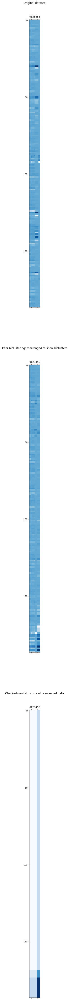

In [33]:
# asr = 0.915
# using colormap limits set by the max and min value of the data
labels_s6_best = bicocluster(all_datasets[('s6', '1.5s after outcome reveal', 'all', 1, True)], svd_method='arpack', n_clusters=3)

80% of values closest to the mean in (-3.8070576190948486, 4.0408430099487305)
Full range: (-50.58757400512695, 46.44874954223633)


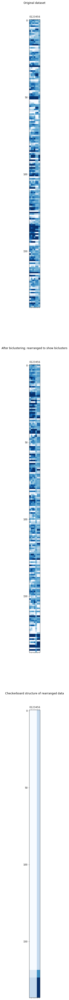

In [122]:
# Using custom limits: min and max of the 80% of data closest to the mean value
labels_s6_best = bicocluster(all_datasets[('s6', '1.5s after outcome reveal', 'all', 1, True)], svd_method='arpack', n_clusters=3,
                           use_limits=True)

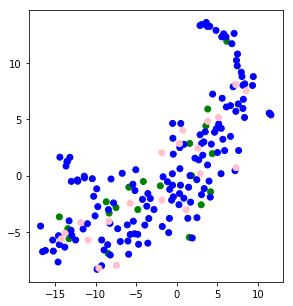

In [101]:
show_tsne_plot(all_datasets[('s6', '1.5s after outcome reveal', 'all', 1, True)], plot_trials=True)  
# trials as instances, electrode averages as features

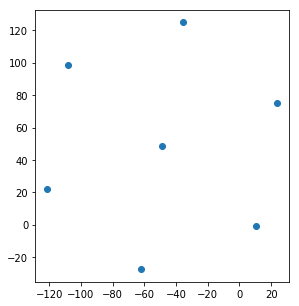

In [104]:
show_tsne_plot(all_datasets[('s6', '1.5s after outcome reveal', 'all', 1, True)].T, plot_trials=False)
# electrodes as instances, trial averages as features

In [80]:
arr1, arr2 = compare_first_and_last_trials(row_labels=labels_s6_best[0], col_labels=labels_s6_best[1])
pretty_print_arrays(arr1, arr2)

[20.0 20.0]    [20.0 20.0]
[ 0.0  0.0]    [ 0.0  0.0]
[ 0.0  0.0]    [ 0.0  0.0]



In [35]:
elec_labels, trial_labels = get_bicluster_trials_elecs(data=all_datasets[('s6', '1.5s after outcome reveal', 'all', 1, True)], 
                                                     tw_per_el=1, row_cl=2, col_cl=1, row_labels=labels_s6_best[0], 
                                                     col_labels=labels_s6_best[1])

print(elec_labels)
print(trial_labels)

['elec5 w1' 'elec6 w1']
['trial93' 'trial51' 'trial140' 'trial61' 'trial142' 'trial125' 'trial36'
 'trial58' 'trial165' 'trial31' 'trial111' 'trial126' 'trial146']


In [45]:
trial_idx = list(map(lambda l: int(l[5:]) - 1, trial_labels))
behavior_data['s6'][behavior_data['s6']['trial.included'] == 1].reset_index(drop = True).iloc[trial_idx]

,round,newround.time,choice.time,buttonpress.time,conf.time,reveal.time,choice.class,choice.location,outcome,trial.included
92,99,367.233,367.999,369.062,369.077,369.093,Safebet,Left,WouldHaveWon,1
50,57,252.390,253.171,254.015,254.030,254.046,Gamble,Left,Win,1
139,150,509.327,510.093,510.812,510.843,510.858,Gamble,Right,Win,1
60,67,279.796,280.562,281.296,281.312,281.327,Gamble,Left,Win,1
141,152,514.858,515.624,516.515,516.530,516.562,Gamble,Right,Win,1
124,135,469.249,470.015,471.046,471.062,471.077,Safebet,Right,WouldHaveLost,1
35,39,199.062,199.843,200.702,200.718,200.733,Gamble,Right,Win,1
57,64,271.577,272.343,273.405,273.421,273.437,Safebet,Left,WouldHaveLost,1
164,178,587.483,588.249,589.093,589.108,589.140,Safebet,Left,WouldHaveLost,1
30,33,180.640,181.421,182.593,182.608,182.624,Safebet,Right,WouldHaveLost,1


In [46]:
included_idx = behavior_data['s6'][behavior_data['s6']['trial.included'] == 1].index
gamble_choices.iloc[included_idx].reset_index(drop = True).iloc[trial_idx]

,Safe.Bet.Amount,Risky.Bet.Amount,Risky.bet.shown.number,Risky.bet.hidden.number,Risky.Side
92,10,15,6,9,Right
50,10,30,2,5,Left
139,10,25,1,3,Right
60,10,30,4,6,Left
141,10,25,2,8,Right
124,10,20,7,4,Left
35,10,20,4,5,Right
57,10,20,8,3,Right
164,10,30,9,0,Right
30,10,25,9,7,Left


In [43]:
elec_labels2, trial_labels2 = get_bicluster_trials_elecs(data=all_datasets[('s6', '1.5s after outcome reveal', 'all', 1, True)], 
                                                     tw_per_el=1, row_cl=1, col_cl=1, row_labels=labels_s6_best[0], 
                                                     col_labels=labels_s6_best[1])

print(elec_labels2)
print(trial_labels2)

['elec5 w1' 'elec6 w1']
['trial139' 'trial128' 'trial32' 'trial144' 'trial166']


In [47]:
trial_idx2 = list(map(lambda l: int(l[5:]) - 1, trial_labels2))
behavior_data['s6'][behavior_data['s6']['trial.included'] == 1].reset_index(drop = True).iloc[trial_idx2]

,round,newround.time,choice.time,buttonpress.time,conf.time,reveal.time,choice.class,choice.location,outcome,trial.included
138,149,506.655,507.421,508.265,508.280,508.312,Gamble,Left,Win,1
127,138,477.405,478.171,479.030,479.046,479.077,Gamble,Left,Win,1
31,35,186.358,187.124,188.515,188.530,188.562,Gamble,Left,Loss,1
143,154,520.233,520.999,521.874,521.890,521.921,Safebet,Right,WouldHaveWon,1
165,179,590.155,590.921,591.858,591.890,591.905,Safebet,Right,WouldHaveWon,1


In [49]:
included_idx2 = behavior_data['s6'][behavior_data['s6']['trial.included'] == 1].index
gamble_choices.iloc[included_idx2].reset_index(drop = True).iloc[trial_idx2]

,Safe.Bet.Amount,Risky.Bet.Amount,Risky.bet.shown.number,Risky.bet.hidden.number,Risky.Side
138,10,20,1,8,Left
127,10,15,0,6,Left
31,10,20,5,2,Left
143,10,30,7,10,Left
165,10,20,5,8,Left


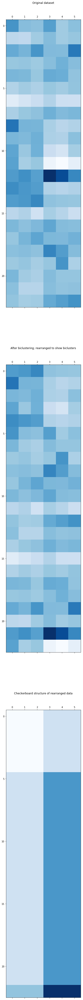

In [56]:
# asr = 0.757
labels_s2_best = bicocluster(all_datasets[('s2', 'between game presentation and buttonpress', 'loss', 3, False)], 
                           svd_method='arpack', n_clusters=3)

80% of values closest to the mean in (-9.193521499633789, 5.367799758911133)
Full range: (-21.679973602294922, 25.255517959594727)


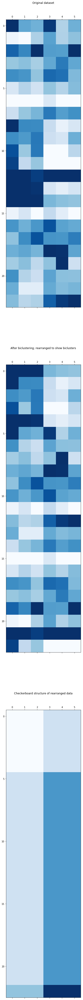

In [206]:
# asr = 0.757
labels_s2_best = bicocluster(all_datasets[('s2', 'between game presentation and buttonpress', 'loss', 3, False)], 
                           svd_method='arpack', n_clusters=3, use_limits=True)

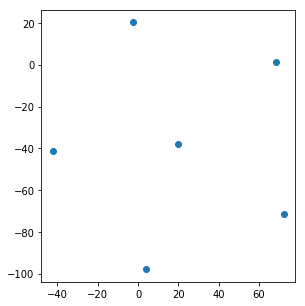

In [107]:
show_tsne_plot(all_datasets[('s2', 'between game presentation and buttonpress', 'loss', 3, False)].T, plot_trials=False)

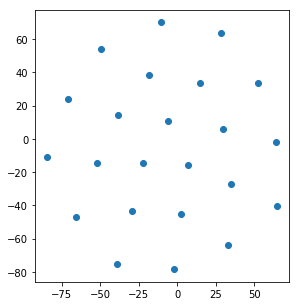

In [109]:
show_tsne_plot(all_datasets[('s2', 'between game presentation and buttonpress', 'loss', 3, False)], plot_trials=True)

In [64]:
compare_first_and_last_trials(row_labels=labels_s2_best[0], col_labels=labels_s2_best[1])

AssertionError: Cannot compare the first 20 and last 20 trials, when data length is 23!

Let's test for a second, if get_bicluster_trials_elecs works correctly:

In [58]:
get_bicluster_trials_elecs(tw_per_el=3, row_cl=0, col_cl=0, row_labels=labels_s2_best[0], col_labels=labels_s2_best[1], 
                           get_trials=True, get_elecs=True, trials_as_labels=True)

(array(['elec1 w1', 'elec1 w2', 'elec1 w3'], dtype='<U8'),
 array(['trial15', 'trial9', 'trial10', 'trial11', 'trial14'], dtype='<U7'))

In [59]:
get_bicluster_trials_elecs(tw_per_el=3, row_cl=0, col_cl=1, row_labels=labels_s2_best[0], col_labels=labels_s2_best[1], 
                           get_trials=True, get_elecs=True, trials_as_labels=True)

(array(['elec2 w1', 'elec2 w2', 'elec2 w3'], dtype='<U8'),
 array(['trial15', 'trial9', 'trial10', 'trial11', 'trial14'], dtype='<U7'))

In [60]:
get_bicluster_trials_elecs(tw_per_el=3, row_cl=1, col_cl=0, row_labels=labels_s2_best[0], col_labels=labels_s2_best[1], 
                           get_trials=True, get_elecs=True, trials_as_labels=True)

(array(['elec1 w1', 'elec1 w2', 'elec1 w3'], dtype='<U8'),
 array(['trial1', 'trial21', 'trial20', 'trial19', 'trial18', 'trial17',
        'trial16', 'trial23', 'trial22', 'trial8', 'trial7', 'trial6',
        'trial5', 'trial4', 'trial3', 'trial2', 'trial13'], dtype='<U7'))

In [61]:
get_bicluster_trials_elecs(tw_per_el=3, row_cl=1, col_cl=1, row_labels=labels_s2_best[0], col_labels=labels_s2_best[1], 
                           get_trials=True, get_elecs=True, trials_as_labels=True)

(array(['elec2 w1', 'elec2 w2', 'elec2 w3'], dtype='<U8'),
 array(['trial1', 'trial21', 'trial20', 'trial19', 'trial18', 'trial17',
        'trial16', 'trial23', 'trial22', 'trial8', 'trial7', 'trial6',
        'trial5', 'trial4', 'trial3', 'trial2', 'trial13'], dtype='<U7'))

Seems to work as there are the correct number of trials and elecs in the biclusters and the biclusters in one column have the same electrodes and the biclusters in the same rows have the same trials.

C:\Users\MariLiis\Anaconda3\lib\site-packages\sklearn\cluster\bicluster.py:296: FutureWarning: arrays to stack must be passed as a "sequence" type such as list or tuple. Support for non-sequence iterables such as generators is deprecated as of NumPy 1.16 and will raise an error in the future.
  for c in range(self.n_clusters))
C:\Users\MariLiis\Anaconda3\lib\site-packages\sklearn\cluster\bicluster.py:298: FutureWarning: arrays to stack must be passed as a "sequence" type such as list or tuple. Support for non-sequence iterables such as generators is deprecated as of NumPy 1.16 and will raise an error in the future.
  for c in range(self.n_clusters))


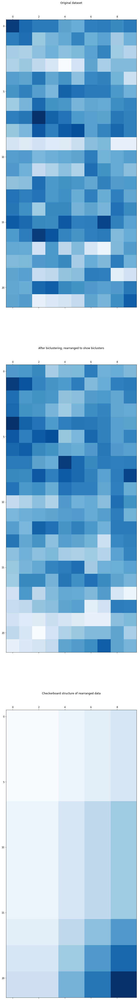

In [129]:
# asr = 0.756
labels_s4_best = bicocluster(all_datasets[('s4', 'between game presentation and buttonpress', 'win', 2, True)],
                           svd_method='arpack', n_clusters=5)

80% of values closest to the mean in (-5.785331726074219, 3.9943158626556396)
Full range: (-12.386317253112793, 8.614013671875)


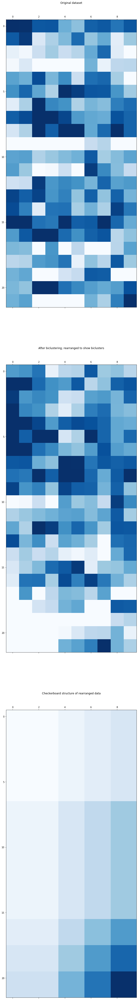

In [207]:
# asr = 0.756
labels_s4_best = bicocluster(all_datasets[('s4', 'between game presentation and buttonpress', 'win', 2, True)],
                           svd_method='arpack', n_clusters=5, use_limits=True)

C:\Users\MariLiis\Anaconda3\lib\site-packages\sklearn\cluster\bicluster.py:296: FutureWarning: arrays to stack must be passed as a "sequence" type such as list or tuple. Support for non-sequence iterables such as generators is deprecated as of NumPy 1.16 and will raise an error in the future.
  for c in range(self.n_clusters))
C:\Users\MariLiis\Anaconda3\lib\site-packages\sklearn\cluster\bicluster.py:298: FutureWarning: arrays to stack must be passed as a "sequence" type such as list or tuple. Support for non-sequence iterables such as generators is deprecated as of NumPy 1.16 and will raise an error in the future.
  for c in range(self.n_clusters))


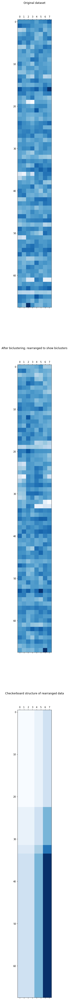

In [136]:
# asr = 0.736
labels_s8_best = bicocluster(all_datasets[('s8', 'between game presentation and buttonpress', 'win', 2, False)], 
                           svd_method='randomized', n_clusters=4)

80% of values closest to the mean in (-6.75242280960083, 4.014735221862793)
Full range: (-22.780921936035156, 14.53744125366211)


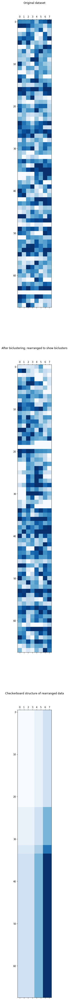

In [208]:
# asr = 0.736
labels_s8_best = bicocluster(all_datasets[('s8', 'between game presentation and buttonpress', 'win', 2, False)], 
                           svd_method='randomized', n_clusters=4, use_limits=True)

C:\Users\MariLiis\Anaconda3\lib\site-packages\sklearn\cluster\bicluster.py:296: FutureWarning: arrays to stack must be passed as a "sequence" type such as list or tuple. Support for non-sequence iterables such as generators is deprecated as of NumPy 1.16 and will raise an error in the future.
  for c in range(self.n_clusters))
C:\Users\MariLiis\Anaconda3\lib\site-packages\sklearn\cluster\bicluster.py:298: FutureWarning: arrays to stack must be passed as a "sequence" type such as list or tuple. Support for non-sequence iterables such as generators is deprecated as of NumPy 1.16 and will raise an error in the future.
  for c in range(self.n_clusters))


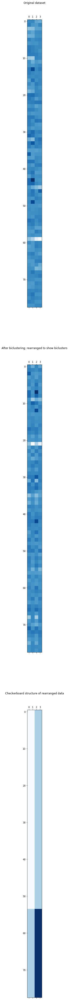

In [123]:
# asr = 0.732
labels_s1_best = bicocluster(all_datasets[('s1', '1.5s after outcome reveal', 'win', 2, False)], svd_method='arpack', 
                             n_clusters=2)

80% of values closest to the mean in (-3.700309991836548, 3.3880221843719482)
Full range: (-29.966270446777344, 16.894733428955078)


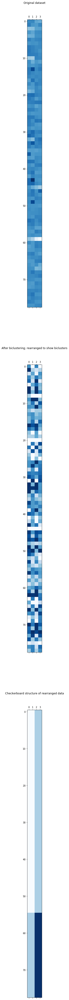

In [42]:
labels_s1_best = bicocluster(all_datasets[('s1', '1.5s after outcome reveal', 'win', 2, False)], svd_method='arpack', 
                           n_clusters=2, use_limits=True)

C:\Users\MariLiis\Anaconda3\lib\site-packages\sklearn\cluster\bicluster.py:296: FutureWarning: arrays to stack must be passed as a "sequence" type such as list or tuple. Support for non-sequence iterables such as generators is deprecated as of NumPy 1.16 and will raise an error in the future.
  for c in range(self.n_clusters))
C:\Users\MariLiis\Anaconda3\lib\site-packages\sklearn\cluster\bicluster.py:298: FutureWarning: arrays to stack must be passed as a "sequence" type such as list or tuple. Support for non-sequence iterables such as generators is deprecated as of NumPy 1.16 and will raise an error in the future.
  for c in range(self.n_clusters))


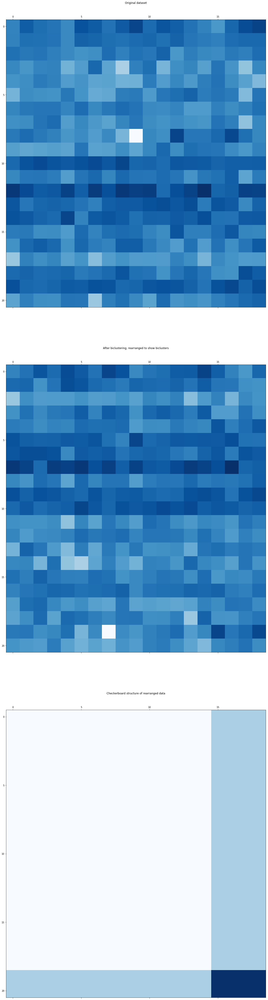

In [138]:
# asr = 0.717
labels_s9_best = bicocluster(all_datasets[('s9', 'between game presentation and buttonpress', 'loss', 1, True)], 
                           svd_method='randomized', n_clusters=2)

80% of values closest to the mean in (-8.033981323242188, 4.657066345214844)
Full range: (-33.93781280517578, 11.019821166992188)


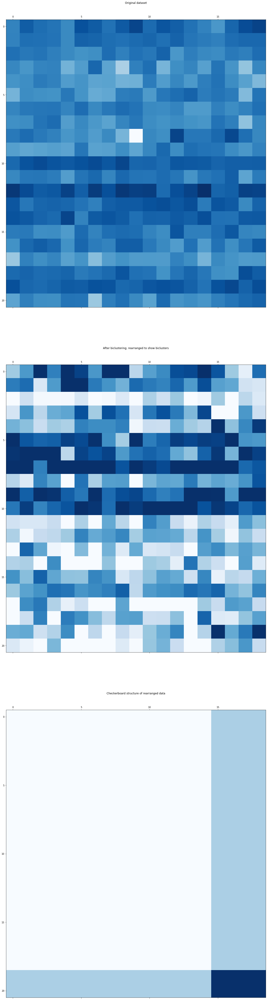

In [86]:
labels_s9_best = bicocluster(all_datasets[('s9', 'between game presentation and buttonpress', 'loss', 1, True)], 
                           svd_method='randomized', n_clusters=2, use_limits=True)

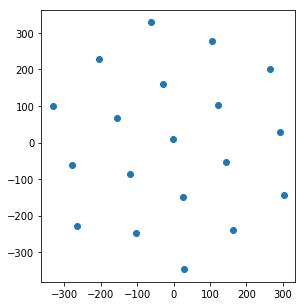

In [105]:
show_tsne_plot(all_datasets[('s9', 'between game presentation and buttonpress', 'loss', 1, True)].T, plot_trials=False)

C:\Users\MariLiis\Anaconda3\lib\site-packages\sklearn\cluster\bicluster.py:296: FutureWarning: arrays to stack must be passed as a "sequence" type such as list or tuple. Support for non-sequence iterables such as generators is deprecated as of NumPy 1.16 and will raise an error in the future.
  for c in range(self.n_clusters))
C:\Users\MariLiis\Anaconda3\lib\site-packages\sklearn\cluster\bicluster.py:298: FutureWarning: arrays to stack must be passed as a "sequence" type such as list or tuple. Support for non-sequence iterables such as generators is deprecated as of NumPy 1.16 and will raise an error in the future.
  for c in range(self.n_clusters))


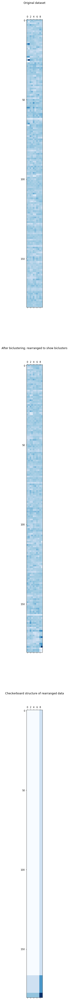

In [134]:
# asr = 0.69
labels_s7_best = bicocluster(all_datasets[('s7', 'between game presentation and buttonpress', 'all', 2, False)], 
                           svd_method='arpack', n_clusters=3)

80% of values closest to the mean in (-5.5059285163879395, 4.495032787322998)
Full range: (-27.245691299438477, 50.81705093383789)


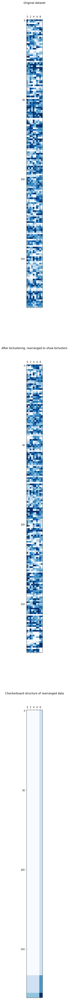

In [209]:
labels_s7_best = bicocluster(all_datasets[('s7', 'between game presentation and buttonpress', 'all', 2, False)], 
                           svd_method='arpack', n_clusters=3, use_limits=True)

In [83]:
arr1, arr2 = compare_first_and_last_trials(row_labels=labels_s7_best[0], col_labels=labels_s7_best[1])
pretty_print_arrays(arr1, arr2)

[18.0 18.0]    [20.0 20.0]
[ 2.0  2.0]    [ 0.0  0.0]
[ 0.0  0.0]    [ 0.0  0.0]



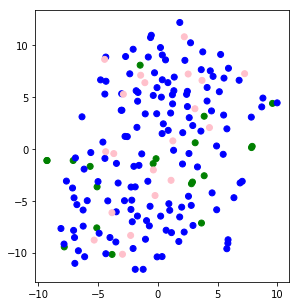

In [110]:
show_tsne_plot(all_datasets[('s7', 'between game presentation and buttonpress', 'all', 2, False)], plot_trials=True)

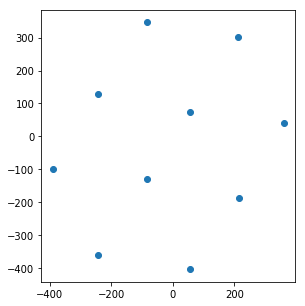

In [111]:
show_tsne_plot(all_datasets[('s7', 'between game presentation and buttonpress', 'all', 2, False)].T, plot_trials=False)

C:\Users\MariLiis\Anaconda3\lib\site-packages\sklearn\cluster\bicluster.py:296: FutureWarning: arrays to stack must be passed as a "sequence" type such as list or tuple. Support for non-sequence iterables such as generators is deprecated as of NumPy 1.16 and will raise an error in the future.
  for c in range(self.n_clusters))
C:\Users\MariLiis\Anaconda3\lib\site-packages\sklearn\cluster\bicluster.py:298: FutureWarning: arrays to stack must be passed as a "sequence" type such as list or tuple. Support for non-sequence iterables such as generators is deprecated as of NumPy 1.16 and will raise an error in the future.
  for c in range(self.n_clusters))


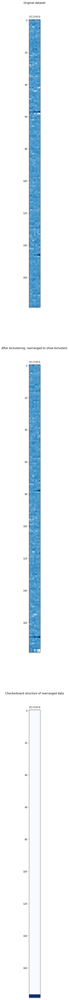

In [132]:
# asr = 0.595
labels_s5_best = bicocluster(all_datasets[('s5', '1.5s after outcome reveal', 'all', 1, False)], svd_method='randomized', 
                           n_clusters=2)

80% of values closest to the mean in (-4.137905120849609, 4.319786071777344)
Full range: (-38.83614730834961, 27.400196075439453)


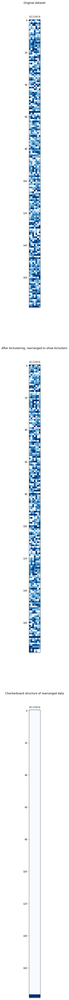

In [210]:
labels_s5_best = bicocluster(all_datasets[('s5', '1.5s after outcome reveal', 'all', 1, False)], svd_method='randomized', 
                           n_clusters=2, use_limits=True)

In [85]:
arr1, arr2 = compare_first_and_last_trials(row_labels=labels_s5_best[0], col_labels=labels_s5_best[1])
pretty_print_arrays(arr1, arr2)

[20.0]    [20.0]
[ 0.0]    [ 0.0]



C:\Users\MariLiis\Anaconda3\lib\site-packages\sklearn\cluster\bicluster.py:296: FutureWarning: arrays to stack must be passed as a "sequence" type such as list or tuple. Support for non-sequence iterables such as generators is deprecated as of NumPy 1.16 and will raise an error in the future.
  for c in range(self.n_clusters))
C:\Users\MariLiis\Anaconda3\lib\site-packages\sklearn\cluster\bicluster.py:298: FutureWarning: arrays to stack must be passed as a "sequence" type such as list or tuple. Support for non-sequence iterables such as generators is deprecated as of NumPy 1.16 and will raise an error in the future.
  for c in range(self.n_clusters))


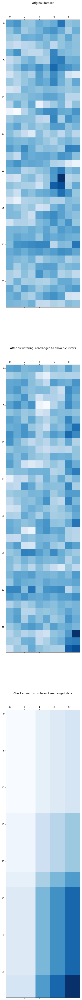

In [140]:
# asr = 0.586
labels_s10_best = bicocluster(all_datasets[('s10', 'between game presentation and buttonpress', 'loss', 2, False)], 
                           svd_method='arpack', n_clusters=5)

C:\Users\MariLiis\Anaconda3\lib\site-packages\sklearn\cluster\bicluster.py:296: FutureWarning: arrays to stack must be passed as a "sequence" type such as list or tuple. Support for non-sequence iterables such as generators is deprecated as of NumPy 1.16 and will raise an error in the future.
  for c in range(self.n_clusters))
C:\Users\MariLiis\Anaconda3\lib\site-packages\sklearn\cluster\bicluster.py:298: FutureWarning: arrays to stack must be passed as a "sequence" type such as list or tuple. Support for non-sequence iterables such as generators is deprecated as of NumPy 1.16 and will raise an error in the future.
  for c in range(self.n_clusters))


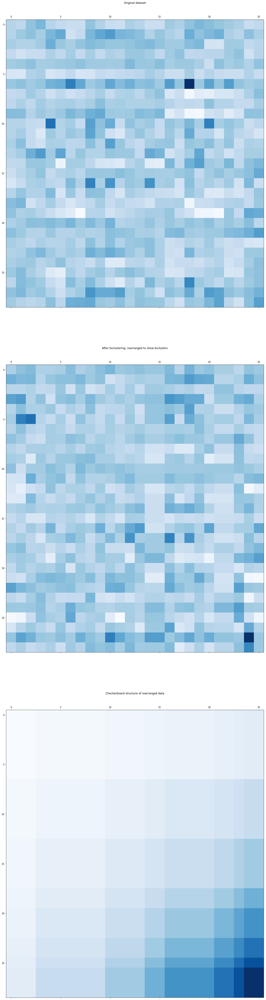

In [127]:
# asr = 0.495
labels_s3_best = bicocluster(all_datasets[('s3', 'between game presentation and buttonpress', 'loss', 2, False)], 
                           svd_method='randomized', n_clusters=8)

### 6. Spectral biclustering results when testing different parameters and datasets

These results were obtained by running biclustering.ipynb.

In [131]:
# spec_cluster_results = {**load_var("bicluster_results_s123"), **load_var("bicluster_results_s456"), 
#                      **load_var("bicluster_results_s78910")} # this expression combines the dictionaries
# len(spec_cluster_results.keys())
# save_var(spec_cluster_results, "bicluster_results_1")

10536

In [132]:
sorted_results_spec = sorted(spec_cluster_results.items(), key=lambda x: x[1][0], reverse=True)
list(map(lambda x: (x[0], x[1][0]), sorted_results_spec[:10]))

[(('s6',
   '1.5s after outcome reveal',
   'all',
   2,
   False,
   'bistochastic',
   3,
   'randomized'),
  0.967),
 (('s6', '1.5s after outcome reveal', 'win', 2, True, 'log', 3, 'randomized'),
  0.926),
 (('s6', '1.5s after outcome reveal', 'win', 2, True, 'log', 3, 'arpack'),
  0.926),
 (('s6',
   '1.5s after outcome reveal',
   'all',
   3,
   False,
   'bistochastic',
   4,
   'randomized'),
  0.924),
 (('s6', '1.5s after outcome reveal', 'win', 2, True, 'log', 5, 'randomized'),
  0.92),
 (('s6', '1.5s after outcome reveal', 'win', 2, True, 'log', 5, 'arpack'),
  0.92),
 (('s6', '1.5s after outcome reveal', 'win', 2, False, 'log', 3, 'randomized'),
  0.91),
 (('s6',
   '1.5s after outcome reveal',
   'win',
   2,
   True,
   'bistochastic',
   3,
   'arpack'),
  0.909),
 (('s6',
   'between game presentation and buttonpress',
   'win',
   1,
   True,
   'log',
   2,
   'randomized'),
  0.908),
 (('s6',
   'between game presentation and buttonpress',
   'win',
   1,
   True,
  

In [137]:
result_statistics_spec = defaultdict(lambda: defaultdict(float))
counts_spec = defaultdict(lambda: defaultdict(int))  # we need to count occurrences bc some results were nan

for item in sorted_results_spec:
    params, res = item
    asr, _, _, _, _ = res
    s, tw_type, trial_type, tw_per_el, use_all_els, method, n_clusters, svd_method = params
    result_statistics_spec['subjects'][s] += asr
    counts_spec['subjects'][s] += 1 
    result_statistics_spec['tw_type'][tw_type] += asr
    counts_spec['tw_type'][tw_type] += 1
    result_statistics_spec['trial_type'][trial_type] += asr
    counts_spec['trial_type'][trial_type] += 1
    result_statistics_spec['tw_per_el'][tw_per_el] += asr
    counts_spec['tw_per_el'][tw_per_el] += 1
    result_statistics_spec['use_all_els'][use_all_els] += asr
    counts_spec['use_all_els'][use_all_els] += 1
    result_statistics_spec['method'][method] += asr 
    counts_spec['method'][method] += 1
    result_statistics_spec['n_clusters'][n_clusters] += asr 
    counts_spec['n_clusters'][n_clusters] += 1
    result_statistics_spec['svd_method'][svd_method] += asr 
    counts_spec['svd_method'][svd_method] += 1
    result_statistics_spec['combo'][(tw_type, trial_type, tw_per_el, use_all_els, n_clusters, svd_method)] += asr
    counts_spec['combo'][(tw_type, trial_type, tw_per_el, use_all_els, n_clusters, svd_method)] += 1

for key1 in result_statistics_spec:
    for key2 in result_statistics_spec[key1]:
        result_statistics_spec[key1][key2] /= counts_spec[key1][key2]

In [138]:
sorted(result_statistics_spec['subjects'].items(), key=lambda x: x[1], reverse=True)

[('s6', 0.49670833333333353),
 ('s4', 0.39975793650793645),
 ('s9', 0.37616850490196124),
 ('s2', 0.35879960317460313),
 ('s8', 0.34556296296296346),
 ('s1', 0.34036111111111067),
 ('s7', 0.33901562500000004),
 ('s10', 0.29170032051282074),
 ('s5', 0.2825499999999996),
 ('s3', 0.21390870098039202)]

In [139]:
sorted(result_statistics_spec['tw_type'].items(), key=lambda x: x[1], reverse=True)

[('1.5s after outcome reveal', 0.34227980258162427),
 ('between game presentation and buttonpress', 0.31617957479119185)]

In [140]:
sorted(result_statistics_spec['trial_type'].items(), key=lambda x: x[1], reverse=True)

[('win', 0.3491245254365997),
 ('all', 0.33230751708428297),
 ('gamble', 0.3269700075930152),
 ('loss', 0.3085167046317382)]

In [141]:
sorted(result_statistics_spec['tw_per_el'].items(), key=lambda x: x[1], reverse=True)

[(2, 0.35188328157349935), (3, 0.34982394688644664), (1, 0.2521944444444454)]

In [142]:
sorted(result_statistics_spec['use_all_els'].items(), key=lambda x: x[1], reverse=True)

[(False, 0.3604060509554135), (True, 0.3118726359338064)]

In [143]:
sorted(result_statistics_spec['method'].items(), key=lambda x: x[1], reverse=True)

[('log', 0.35730050790067636),
 ('bistochastic', 0.31703060640732134),
 ('scale', 0.3129725400457666)]

In [144]:
sorted(result_statistics_spec['n_clusters'].items(), key=lambda x: x[1], reverse=True)

[(4, 0.3429827755905515),
 (5, 0.33470551801801834),
 (3, 0.33238122775800727),
 (6, 0.32202083333333287),
 (7, 0.31835119047618976),
 (2, 0.3183209459459467)]

In [145]:
sorted(result_statistics_spec['svd_method'].items(), key=lambda x: x[1], reverse=True)

[('randomized', 0.3652535765379113), ('arpack', 0.28848422330097095)]

In [146]:
sorted(result_statistics_spec['combo'].items(), key=lambda x: x[1], reverse=True)[:5]

[(('1.5s after outcome reveal', 'all', 2, False, 3, 'randomized'),
  0.5576666666666668),
 (('1.5s after outcome reveal', 'gamble', 2, False, 3, 'randomized'),
  0.539047619047619),
 (('between game presentation and buttonpress',
   'win',
   2,
   False,
   2,
   'randomized'),
  0.5263666666666668),
 (('1.5s after outcome reveal', 'all', 3, False, 4, 'randomized'),
  0.5099523809523809),
 (('1.5s after outcome reveal', 'win', 2, False, 2, 'randomized'),
  0.4941333333333334)]

In [221]:
list(filter(lambda x: x[0][0] == 's10', map(lambda x: (x[0], x[1][0]), sorted_results_spec)))[0]

(('s10',
  'between game presentation and buttonpress',
  'loss',
  2,
  False,
  'log',
  4,
  'randomized'),
 0.651)

In [223]:
list(map(lambda x: (x[0][0], x[1]), filter(lambda x: x[1] >= 0.75, map(lambda x: (x[0], x[1][0]), sorted_results_spec))))

[('s6', 0.967),
 ('s6', 0.926),
 ('s6', 0.926),
 ('s6', 0.924),
 ('s6', 0.92),
 ('s6', 0.92),
 ('s6', 0.91),
 ('s6', 0.909),
 ('s6', 0.908),
 ('s6', 0.908),
 ('s6', 0.908),
 ('s6', 0.906),
 ('s6', 0.906),
 ('s6', 0.905),
 ('s6', 0.905),
 ('s6', 0.893),
 ('s6', 0.893),
 ('s6', 0.89),
 ('s6', 0.887),
 ('s6', 0.886),
 ('s6', 0.881),
 ('s6', 0.881),
 ('s6', 0.881),
 ('s6', 0.88),
 ('s6', 0.88),
 ('s6', 0.878),
 ('s6', 0.878),
 ('s6', 0.878),
 ('s6', 0.872),
 ('s6', 0.871),
 ('s6', 0.87),
 ('s6', 0.87),
 ('s6', 0.868),
 ('s6', 0.868),
 ('s6', 0.867),
 ('s6', 0.867),
 ('s6', 0.867),
 ('s6', 0.865),
 ('s6', 0.863),
 ('s6', 0.858),
 ('s6', 0.857),
 ('s6', 0.857),
 ('s6', 0.857),
 ('s6', 0.855),
 ('s6', 0.85),
 ('s6', 0.85),
 ('s6', 0.85),
 ('s6', 0.85),
 ('s6', 0.85),
 ('s6', 0.85),
 ('s6', 0.85),
 ('s6', 0.845),
 ('s6', 0.845),
 ('s6', 0.844),
 ('s6', 0.844),
 ('s6', 0.844),
 ('s6', 0.843),
 ('s6', 0.843),
 ('s1', 0.841),
 ('s6', 0.841),
 ('s6', 0.841),
 ('s6', 0.839),
 ('s6', 0.839),
 ('s6',

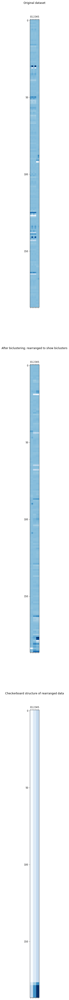

In [133]:
labels_s6_best_spec = spectral_bicluster(all_datasets[('s6', '1.5s after outcome reveal', 'all', 2, False)], 
                                         method='bistochastic', n_clusters=3, svd_method='randomized')

80% of values closest to the mean in (-2.2525315284729004, 2.5215554237365723)
Full range: (-58.678157806396484, 78.18171691894531)


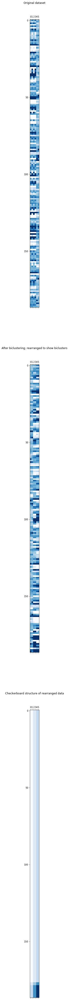

In [134]:
labels_s6_best_spec = spectral_bicluster(all_datasets[('s6', '1.5s after outcome reveal', 'all', 2, False)], 
                                         method='bistochastic', n_clusters=3, svd_method='randomized', use_limits=True)

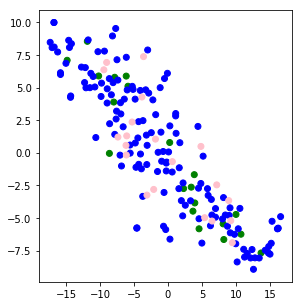

In [135]:
show_tsne_plot(all_datasets[('s6', '1.5s after outcome reveal', 'all', 2, False)], plot_trials=True)

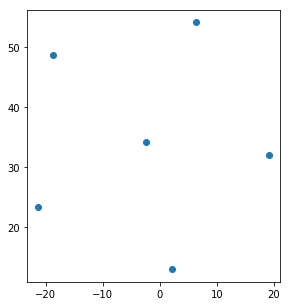

In [151]:
show_tsne_plot(all_datasets[('s6', '1.5s after outcome reveal', 'all', 2, False)].T, plot_trials=False)

In [136]:
arr1, arr2 = compare_first_and_last_trials(labels_s6_best_spec[0], labels_s6_best_spec[1])
pretty_print_arrays(arr1, arr2)

[20.0 20.0 20.0]    [20.0 20.0 20.0]
[ 0.0  0.0  0.0]    [ 0.0  0.0  0.0]
[ 0.0  0.0  0.0]    [ 0.0  0.0  0.0]



### 7. Coclustering results when testing different parameters and datasets vol 2

These results are obtained by using cocluster_results_3.p, where (as opposed to the first case) different electrodes were used for different time window types. 

In [371]:
cocluster_results_2 = load_var("cocluster_results_3")

In [459]:
all_datasets = load_var("all_datasets_2")

In [373]:
def sort_by_param(results, param, reverse=True):
     return sorted(results[param].items(), key=lambda x: x[1], reverse=reverse)

In [374]:
def sort_by_subject(results, s):
    return list(filter(lambda x: x[0][0] == s and x[0][4], map(lambda x: (x[0], x[1][0]), results)))

In [375]:
def sort_filter_by_asr(results, asr_filter=0.75):
    return list(map(lambda x: (x[0][0], x[1]), # maps to tuple (subject, asr)
                    filter(lambda x: x[1] >= asr_filter and x[0][4], # filters by asr and use_all_els = True
                           list(map(lambda x: (x[0], x[1][0]), # selects the tuple of params and the asr score
                                    results)))))    

In [385]:
sorted_results_cocl_2 = sorted(cocluster_results_2.items(), key=lambda x: x[1][0], reverse=True)
sorted_tuples = list(map(lambda x: (x[0], x[1][0]), sorted_results_cocl_2))
filtered = list(filter(lambda x: x[0][4] and x[0][0] != 's6' and x[1] >= 0.7, sorted_tuples))
filtered[:15]

[(('s4',
   'between game presentation and buttonpress',
   'win',
   2,
   True,
   5,
   'arpack'),
  0.756),
 (('s9',
   'between game presentation and buttonpress',
   'loss',
   1,
   True,
   2,
   'randomized'),
  0.717)]

80% of values closest to the mean in (-5.785331726074219, 3.9943158626556396)
Full range: (-12.386317253112793, 8.614013671875)


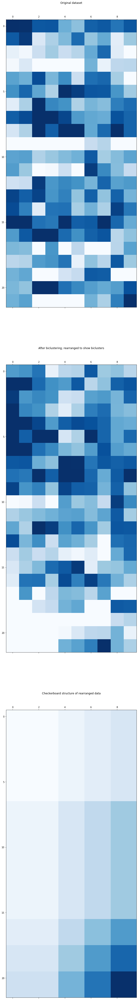

In [386]:
# Using custom limits: min and max of the 80% of data closest to the mean value
labels_s6_best = bicocluster(all_datasets[('s4', 
                                           'between game presentation and buttonpress', 
                                           'win', 2, True)], 
                             svd_method='arpack', n_clusters=5,
                           use_limits=True)

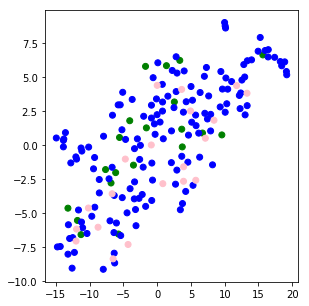

In [389]:
show_tsne_plot(all_datasets[('s6', '1.5s after outcome reveal', 'all', 1, True)], plot_trials=True)  

In [8]:
result_statistics_cocl_2 = defaultdict(lambda: defaultdict(float))
counts_cocl_2 = defaultdict(lambda: defaultdict(int))  # we need to count occurrences bc some results were nan

for item in sorted_results_cocl_2:
    params, res = item
    asr, _, _, _, _ = res
    s, tw_type, trial_type, tw_per_el, use_all_els, n_clusters, svd_method = params
    
    if not use_all_els: # only include the all-electrodes-results
        continue
    
    result_statistics_cocl_2['subjects'][s] += asr
    counts_cocl_2['subjects'][s] += 1 
    result_statistics_cocl_2['tw_type'][tw_type] += asr
    counts_cocl_2['tw_type'][tw_type] += 1
    result_statistics_cocl_2['trial_type'][trial_type] += asr
    counts_cocl_2['trial_type'][trial_type] += 1
    result_statistics_cocl_2['tw_per_el'][tw_per_el] += asr
    counts_cocl_2['tw_per_el'][tw_per_el] += 1
    result_statistics_cocl_2['use_all_els'][use_all_els] += asr
    counts_cocl_2['use_all_els'][use_all_els] += 1
    result_statistics_cocl_2['n_clusters'][n_clusters] += asr 
    counts_cocl_2['n_clusters'][n_clusters] += 1
    result_statistics_cocl_2['svd_method'][svd_method] += asr 
    counts_cocl_2['svd_method'][svd_method] += 1
    result_statistics_cocl_2['combo'][(tw_type, trial_type, tw_per_el, use_all_els, n_clusters, svd_method)] += asr
    counts_cocl_2['combo'][(tw_type, trial_type, tw_per_el, use_all_els, n_clusters, svd_method)] += 1

for key1 in result_statistics_cocl_2:
    for key2 in result_statistics_cocl_2[key1]:
        result_statistics_cocl_2[key1][key2] /= counts_cocl_2[key1][key2]

In [37]:
sort_by_param(result_statistics_cocl_2, 'subjects')

[('s6', 0.4845044642857141),
 ('s9', 0.4280624999999999),
 ('s4', 0.35819999999999996),
 ('s7', 0.3261433823529412),
 ('s8', 0.31032720588235274),
 ('s2', 0.30218124999999996),
 ('s1', 0.26424375000000005),
 ('s10', 0.25310855263157916),
 ('s5', 0.22437202380952379),
 ('s3', 0.1613898809523811)]

In [38]:
sort_by_param(result_statistics_cocl_2, 'tw_type')

[('1.5s after outcome reveal', 0.3072727987421391),
 ('between game presentation and buttonpress', 0.3005338050314463)]

In [39]:
sort_by_param(result_statistics_cocl_2, 'trial_type')

[('win', 0.3091603773584905),
 ('loss', 0.30526415094339643),
 ('all', 0.3037201257861629),
 ('gamble', 0.2974685534591193)]

In [40]:
sort_by_param(result_statistics_cocl_2, 'tw_per_el')

[(2, 0.3177064732142859), (3, 0.3125040322580651), (1, 0.2720442073170733)]

In [41]:
sort_by_param(result_statistics_cocl_2, 'use_all_els')

[(True, 0.30390330188679227)]

In [42]:
sort_by_param(result_statistics_cocl_2, 'svd_method')

[('randomized', 0.3162759433962264), ('arpack', 0.29153066037735875)]

In [43]:
sort_by_param(result_statistics_cocl_2, 'n_clusters')

[(5, 0.33877604166666675),
 (4, 0.3159421296296292),
 (3, 0.3102375),
 (6, 0.30627777777777776),
 (7, 0.3039960937499997),
 (8, 0.28287053571428583),
 (2, 0.2671770833333334)]

In [44]:
sort_by_param(result_statistics_cocl_2, 'combo')[:10]

[(('between game presentation and buttonpress',
   'loss',
   2,
   True,
   3,
   'randomized'),
  0.41980000000000006),
 (('between game presentation and buttonpress',
   'loss',
   3,
   True,
   5,
   'randomized'),
  0.4103),
 (('1.5s after outcome reveal', 'gamble', 2, True, 5, 'arpack'),
  0.4052222222222222),
 (('between game presentation and buttonpress',
   'loss',
   2,
   True,
   5,
   'randomized'),
  0.4027777777777778),
 (('1.5s after outcome reveal', 'win', 2, True, 5, 'randomized'),
  0.39844444444444443),
 (('1.5s after outcome reveal', 'loss', 2, True, 5, 'randomized'),
  0.3923333333333334),
 (('between game presentation and buttonpress',
   'loss',
   3,
   True,
   3,
   'randomized'),
  0.3910000000000001),
 (('between game presentation and buttonpress',
   'loss',
   1,
   True,
   2,
   'randomized'),
  0.3899),
 (('between game presentation and buttonpress', 'win', 2, True, 5, 'arpack'),
  0.3877777777777778),
 (('between game presentation and buttonpress', '

In [300]:
sort_by_subject(sorted_results_cocl_2, 's9')[:5]

[(('s9',
   'between game presentation and buttonpress',
   'loss',
   1,
   True,
   2,
   'randomized'),
  0.717),
 (('s9', '1.5s after outcome reveal', 'loss', 1, True, 4, 'arpack'), 0.632),
 (('s9', '1.5s after outcome reveal', 'loss', 2, True, 4, 'randomized'),
  0.609),
 (('s9', '1.5s after outcome reveal', 'loss', 2, True, 6, 'randomized'),
  0.604),
 (('s9', '1.5s after outcome reveal', 'loss', 3, True, 4, 'randomized'),
  0.603)]

In [304]:
def count_subjects(tuples):
    counts = defaultdict(float)
    for t in tuples:
        counts[t[0]] += 1
    
    print(counts)
    for key in counts:
        counts[key] /= len(tuples)
    return counts

In [299]:
sort_filter_by_asr(sorted_results_cocl_2, asr_filter=0.7)

[('s6', 0.915),
 ('s6', 0.89),
 ('s6', 0.87),
 ('s6', 0.841),
 ('s6', 0.824),
 ('s6', 0.813),
 ('s6', 0.802),
 ('s6', 0.766),
 ('s6', 0.765),
 ('s6', 0.758),
 ('s6', 0.758),
 ('s6', 0.758),
 ('s6', 0.757),
 ('s6', 0.757),
 ('s4', 0.756),
 ('s6', 0.751),
 ('s6', 0.744),
 ('s6', 0.732),
 ('s6', 0.73),
 ('s6', 0.724),
 ('s6', 0.722),
 ('s6', 0.72),
 ('s9', 0.717),
 ('s6', 0.714),
 ('s6', 0.714),
 ('s6', 0.71),
 ('s6', 0.71),
 ('s6', 0.708),
 ('s6', 0.702),
 ('s6', 0.7),
 ('s6', 0.7)]

In [305]:
count_subjects(sort_filter_by_asr(sorted_results_cocl_2, asr_filter=0.7))

defaultdict(<class 'float'>, {'s6': 29.0, 's4': 1.0, 's9': 1.0})


defaultdict(float,
            {'s6': 0.9354838709677419,
             's4': 0.03225806451612903,
             's9': 0.03225806451612903})

In [185]:
cocl_dict_2 = defaultdict(lambda: defaultdict(float))
counts_temp = defaultdict(lambda: defaultdict(int))  # we need to count occurrences bc some results were nan

for item in sorted_results_cocl_2:
    params, res = item
    asr, _, _, _, _ = res
    s, tw_type, trial_type, tw_per_el, use_all_els, n_clusters, svd_method = params
    if not use_all_els:
        continue
    cocl_dict_2[tw_type][tw_per_el] += asr
    counts_temp[tw_type][tw_per_el] += 1 
    cocl_dict_2[trial_type][tw_type] += asr
    counts_temp[trial_type][tw_type] += 1 

for key1 in cocl_dict_2:
    for key2 in counts_temp[key1]:
        cocl_dict_2[key1][key2] /= counts_temp[key1][key2]

In [186]:
print(cocl_dict_2[AFTER_OUTCOME])

defaultdict(<class 'float'>, {1: 0.26857621951219507, 2: 0.32035714285714295, 3: 0.32104435483870974})


In [187]:
print(cocl_dict_2[GAMEPRES_BUTTONPRESS])

defaultdict(<class 'float'>, {1: 0.2755121951219512, 2: 0.3150558035714284, 3: 0.30396370967741904})


In [188]:
print(cocl_dict_2[WIN])

defaultdict(<class 'float'>, {'between game presentation and buttonpress': 0.31920125786163533, '1.5s after outcome reveal': 0.29911949685534606})


In [189]:
print(cocl_dict_2[LOSS])

defaultdict(<class 'float'>, {'between game presentation and buttonpress': 0.30847798742138377, '1.5s after outcome reveal': 0.30205031446540853})


In [190]:
print(cocl_dict_2[ALL])

defaultdict(<class 'float'>, {'1.5s after outcome reveal': 0.3213301886792455, 'between game presentation and buttonpress': 0.28611006289308166})


In [191]:
print(cocl_dict_2[GAMBLE])

defaultdict(<class 'float'>, {'1.5s after outcome reveal': 0.30659119496855375, 'between game presentation and buttonpress': 0.2883459119496854})


80% of values closest to the mean in (-3.8070576190948486, 4.0408430099487305)
Full range: (-50.58757400512695, 46.44874954223633)


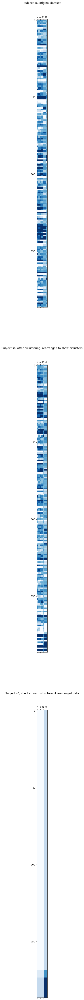

In [365]:
# ('s6', '1.5s after outcome reveal', 'all', 1, True, 3, 'arpack'), 0.915)
res = bicocluster(all_datasets[('s6', '1.5s after outcome reveal', 'all', 1, True)], n_clusters=3, 
            svd_method='arpack', s_name='s6', use_limits=True)

In [361]:
elecs, trials = get_bicluster_trials_elecs(tw_per_el=1, row_cl=2, col_cl=0, row_labels=res[0], col_labels=res[1], 
                                           get_trials=True, get_elecs=True, trials_as_labels=False)
print(elecs)
print(trials)

['elec1 w1' 'elec2 w1' 'elec3 w1' 'elec4 w1' 'elec7 w1']
[52 28 58 47 54  8  6 61 35 66 37]


In [356]:
behav_s9 = behavior_data['s9']
behav_s9 = behav_s9[behav_s9['trial.included'] == 1] 
behav_s9 = behav_s9.reset_index(drop=True)

In [362]:
behav_s9.iloc[trials]['choice.class'].value_counts()

Gamble     7
Safebet    4
Name: choice.class, dtype: int64

In [363]:
behav_s9.iloc[trials]['outcome'].value_counts()

Win              6
WouldHaveLost    3
Loss             1
WouldHaveWon     1
Name: outcome, dtype: int64

numpy.ndarray

80% of values closest to the mean in (-5.785331726074219, 3.9943158626556396)
Full range: (-12.386317253112793, 8.614013671875)


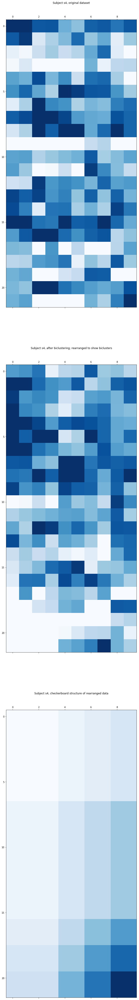

In [295]:
# ('s4', 'between game presentation and buttonpress', 'win', 2, True, 5, 'arpack'), 0.756)
res = bicocluster(all_datasets[('s4', 'between game presentation and buttonpress', 'win', 2, True)], n_clusters=5, 
            svd_method='arpack', s_name='s4', use_limits=True)

80% of values closest to the mean in (-8.033981323242188, 4.657066345214844)
Full range: (-33.93781280517578, 11.019821166992188)


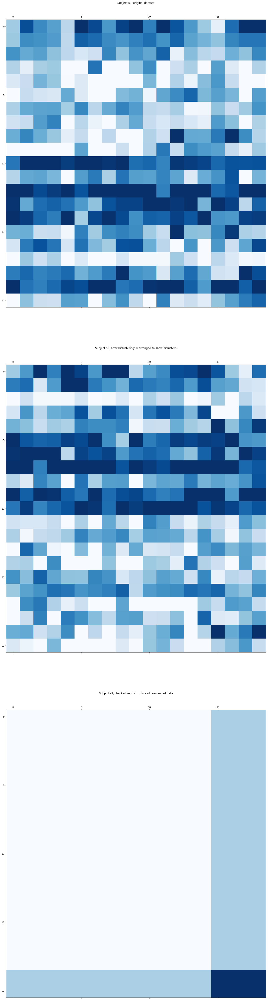

In [301]:
# (('s9', 'between game presentation and buttonpress', 'loss', 1, True, 2, 'randomized'), 0.717)
res = bicocluster(all_datasets[('s9', 'between game presentation and buttonpress', 'loss', 1, True)], n_clusters=2, 
            svd_method='randomized', s_name='s9', use_limits=True)

### 8.  SpectralBiclustering results when testing different parameters and datasets vol 2

These results are obtained by using bicluster_results_s123_2.p, bicluster_results_s456_2.p and bicluster_results_s8910_2.p, where (as opposed to the first case) different electrodes were used for different time window types.

In [320]:
def sort_filter_by_asr_2(results, asr_filter=0.75):
    return list(map(lambda x: (x[0][0], x[1]), # maps to tuple (subject, asr)
                    filter(lambda x: x[1] >= asr_filter and x[0][4] and x[0][5] == 'log', # filters by asr and use_all_els = True and method='log'
                           list(map(lambda x: (x[0], x[1][0]), # selects the tuple of params and the asr score
                                    results)))))    

In [324]:
def sort_by_subject_2(results, s):
    return list(filter(lambda x: x[0][0] == s and x[0][4] and x[0][5] == 'log', map(lambda x: (x[0], x[1][0]), results)))

In [31]:
# spec_cluster_results_2 = {**load_var("bicluster_results_s123_2"), **load_var("bicluster_results_s456_2"), 
#                      **load_var("bicluster_results_s78910_2")} # this expression combines the dictionaries
# save_var(spec_cluster_results_2, "bicluster_results_2")
spec_cluster_results_2 = load_var("bicluster_results_2")

In [318]:
sorted_results_spec_2 = sorted(spec_cluster_results_2.items(), key=lambda x: x[1][0], reverse=True)
sorted_tuples = list(map(lambda x: (x[0], x[1][0]), sorted_results_spec_2))
only_all_els = list(filter(lambda x: x[0][4] and x[0][5] == 'log', sorted_tuples))
only_all_els[:10]

[(('s6', '1.5s after outcome reveal', 'win', 2, True, 'log', 3, 'randomized'),
  0.926),
 (('s6', '1.5s after outcome reveal', 'win', 2, True, 'log', 3, 'arpack'),
  0.926),
 (('s6', '1.5s after outcome reveal', 'win', 2, True, 'log', 5, 'randomized'),
  0.92),
 (('s6', '1.5s after outcome reveal', 'win', 2, True, 'log', 5, 'arpack'),
  0.92),
 (('s6',
   'between game presentation and buttonpress',
   'win',
   1,
   True,
   'log',
   2,
   'randomized'),
  0.908),
 (('s6',
   'between game presentation and buttonpress',
   'win',
   1,
   True,
   'log',
   2,
   'arpack'),
  0.908),
 (('s6', '1.5s after outcome reveal', 'win', 2, True, 'log', 4, 'randomized'),
  0.906),
 (('s6', '1.5s after outcome reveal', 'win', 2, True, 'log', 4, 'arpack'),
  0.906),
 (('s6', '1.5s after outcome reveal', 'all', 2, True, 'log', 4, 'randomized'),
  0.905),
 (('s6', '1.5s after outcome reveal', 'all', 2, True, 'log', 4, 'arpack'),
  0.905)]

In [240]:
result_statistics_spec_2 = defaultdict(lambda: defaultdict(float))
counts_spec_2 = defaultdict(lambda: defaultdict(int))  # we need to count occurrences bc some results were nan

for item in sorted_results_spec_2:
    params, res = item
    asr, _, _, _, _ = res
    s, tw_type, trial_type, tw_per_el, use_all_els, method, n_clusters, svd_method = params
    
    if not use_all_els:
        continue
        
    if method != 'log':
        continue
    
    result_statistics_spec_2['subjects'][s] += asr
    counts_spec_2['subjects'][s] += 1 
    result_statistics_spec_2['tw_type'][tw_type] += asr
    counts_spec_2['tw_type'][tw_type] += 1
    result_statistics_spec_2['trial_type'][trial_type] += asr
    counts_spec_2['trial_type'][trial_type] += 1
    result_statistics_spec_2['tw_per_el'][tw_per_el] += asr
    counts_spec_2['tw_per_el'][tw_per_el] += 1
    result_statistics_spec_2['use_all_els'][use_all_els] += asr
    counts_spec_2['use_all_els'][use_all_els] += 1
    result_statistics_spec_2['n_clusters'][n_clusters] += asr 
    counts_spec_2['n_clusters'][n_clusters] += 1
    result_statistics_spec_2['method'][method] += asr 
    counts_spec_2['method'][method] += 1
    result_statistics_spec_2['svd_method'][svd_method] += asr 
    counts_spec_2['svd_method'][svd_method] += 1
    result_statistics_spec_2['combo'][(tw_type, trial_type, tw_per_el, use_all_els, n_clusters, svd_method)] += asr
    counts_spec_2['combo'][(tw_type, trial_type, tw_per_el, use_all_els, n_clusters, svd_method)] += 1

for key1 in result_statistics_spec_2:
    for key2 in result_statistics_spec_2[key1]:
        result_statistics_spec_2[key1][key2] /= counts_spec_2[key1][key2]

In [241]:
sort_by_param(result_statistics_spec_2, 'subjects')

[('s6', 0.5383461538461541),
 ('s4', 0.4295833333333331),
 ('s9', 0.4149618055555561),
 ('s2', 0.37370138888888893),
 ('s8', 0.37080078124999977),
 ('s7', 0.3670500000000002),
 ('s1', 0.324),
 ('s10', 0.28405882352941125),
 ('s5', 0.24769444444444455),
 ('s3', 0.19103124999999982)]

In [242]:
sort_by_param(result_statistics_spec_2, 'tw_type')

[('1.5s after outcome reveal', 0.35750704225352115),
 ('between game presentation and buttonpress', 0.32950704225352034)]

In [243]:
sort_by_param(result_statistics_spec_2, 'trial_type')

[('win', 0.36438908450704205),
 ('all', 0.3496672535211273),
 ('gamble', 0.33962676056338026),
 ('loss', 0.3203450704225352)]

In [244]:
sort_by_param(result_statistics_spec_2, 'tw_per_el')

[(2, 0.37684313725490154), (3, 0.36244318181818097), (1, 0.26735069444444487)]

In [245]:
sort_by_param(result_statistics_spec_2, 'n_clusters')

[(5, 0.3639609375000001),
 (4, 0.36058333333333376),
 (3, 0.34346052631578977),
 (6, 0.3357361111111112),
 (7, 0.32737109374999984),
 (2, 0.32411842105263206)]

In [246]:
sort_by_param(result_statistics_spec_2, 'use_all_els')

[(True, 0.34350704225352235)]

In [247]:
sort_by_param(result_statistics_spec_2,'svd_method')

[('arpack', 0.3482877697841723), ('randomized', 0.338924137931034)]

In [248]:
sort_by_param(result_statistics_spec_2, 'method')

[('log', 0.34350704225352235)]

In [249]:
sort_by_param(result_statistics_spec_2, 'combo')[:5]

[(('1.5s after outcome reveal', 'all', 2, True, 5, 'randomized'),
  0.4888888888888888),
 (('1.5s after outcome reveal', 'all', 2, True, 5, 'arpack'),
  0.4888888888888888),
 (('1.5s after outcome reveal', 'gamble', 2, True, 4, 'randomized'), 0.4614),
 (('1.5s after outcome reveal', 'gamble', 2, True, 4, 'arpack'), 0.4614),
 (('1.5s after outcome reveal', 'all', 3, True, 6, 'randomized'),
  0.45812499999999995)]

In [321]:
sort_filter_by_asr_2(sorted_results_spec_2, asr_filter=0.7)

[('s6', 0.926),
 ('s6', 0.926),
 ('s6', 0.92),
 ('s6', 0.92),
 ('s6', 0.908),
 ('s6', 0.908),
 ('s6', 0.906),
 ('s6', 0.906),
 ('s6', 0.905),
 ('s6', 0.905),
 ('s6', 0.881),
 ('s6', 0.881),
 ('s6', 0.878),
 ('s6', 0.878),
 ('s6', 0.87),
 ('s6', 0.87),
 ('s6', 0.857),
 ('s6', 0.857),
 ('s6', 0.85),
 ('s6', 0.85),
 ('s6', 0.85),
 ('s6', 0.85),
 ('s6', 0.845),
 ('s6', 0.845),
 ('s6', 0.841),
 ('s6', 0.841),
 ('s6', 0.835),
 ('s6', 0.835),
 ('s6', 0.831),
 ('s6', 0.831),
 ('s6', 0.821),
 ('s6', 0.821),
 ('s6', 0.818),
 ('s6', 0.818),
 ('s6', 0.814),
 ('s6', 0.814),
 ('s6', 0.813),
 ('s6', 0.813),
 ('s6', 0.809),
 ('s6', 0.809),
 ('s6', 0.803),
 ('s6', 0.803),
 ('s6', 0.787),
 ('s6', 0.787),
 ('s6', 0.784),
 ('s6', 0.784),
 ('s6', 0.771),
 ('s6', 0.771),
 ('s6', 0.771),
 ('s6', 0.771),
 ('s6', 0.767),
 ('s6', 0.767),
 ('s6', 0.744),
 ('s6', 0.744),
 ('s6', 0.741),
 ('s6', 0.741),
 ('s6', 0.738),
 ('s6', 0.738),
 ('s6', 0.723),
 ('s6', 0.723),
 ('s6', 0.716),
 ('s6', 0.716),
 ('s6', 0.712),


In [322]:
count_subjects(sort_filter_by_asr_2(sorted_results_spec_2, asr_filter=0.7))

defaultdict(<class 'float'>, {'s6': 64.0, 's1': 2.0, 's4': 2.0})


defaultdict(float,
            {'s6': 0.9411764705882353,
             's1': 0.029411764705882353,
             's4': 0.029411764705882353})

In [330]:
sort_by_subject_2(sorted_results_spec_2, 's1')[0]

(('s1', '1.5s after outcome reveal', 'all', 2, True, 'log', 5, 'randomized'),
 0.706)

In [255]:
bicl_dict_2 = defaultdict(lambda: defaultdict(float))
counts_temp = defaultdict(lambda: defaultdict(int))  # we need to count occurrences bc some results were nan

for item in sorted_results_spec_2:
    params, res = item
    asr, _, _, _, _ = res
    s, tw_type, trial_type, tw_per_el, use_all_els, method, n_clusters, svd_method = params
    
    if not use_all_els:
        continue
    
    if method != 'log':
        continue
    
    bicl_dict_2[tw_type][tw_per_el] += asr
    counts_temp[tw_type][tw_per_el] += 1 
    bicl_dict_2[trial_type][tw_type] += asr
    counts_temp[trial_type][tw_type] += 1 

for key1 in bicl_dict_2:
    for key2 in counts_temp[key1]:
        bicl_dict_2[key1][key2] /= counts_temp[key1][key2]

In [256]:
print(bicl_dict_2[AFTER_OUTCOME])

defaultdict(<class 'float'>, {2: 0.3876053921568628, 1: 0.2838472222222224, 3: 0.3778113636363637})


In [257]:
print(bicl_dict_2[GAMEPRES_BUTTONPRESS])

defaultdict(<class 'float'>, {1: 0.25085416666666643, 2: 0.3660808823529412, 3: 0.34707500000000063})


In [258]:
print(bicl_dict_2[WIN])

defaultdict(<class 'float'>, {'1.5s after outcome reveal': 0.3618028169014088, 'between game presentation and buttonpress': 0.3669753521126761})


In [259]:
print(bicl_dict_2[ALL])

defaultdict(<class 'float'>, {'1.5s after outcome reveal': 0.3775528169014084, 'between game presentation and buttonpress': 0.32178169014084507})


In [260]:
print(bicl_dict_2[LOSS])

defaultdict(<class 'float'>, {'1.5s after outcome reveal': 0.32124647887323926, 'between game presentation and buttonpress': 0.31944366197183094})


In [261]:
print(bicl_dict_2[GAMBLE])

defaultdict(<class 'float'>, {'1.5s after outcome reveal': 0.369426056338028, 'between game presentation and buttonpress': 0.3098274647887325})


80% of values closest to the mean in (-4.4583048820495605, 4.198119163513184)
Full range: (-50.69358444213867, 62.17708206176758)


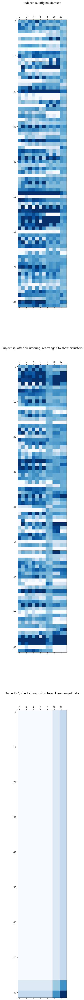

In [333]:
# (('s6', '1.5s after outcome reveal', 'win', 2, True, 'log', 3, 'arpack'), 0.926)
res = spectral_bicluster(all_datasets[('s6', '1.5s after outcome reveal', 'win', 2, True)], n_clusters=3, method='log',
                         svd_method='arpack', s_name='s6', use_limits=True)

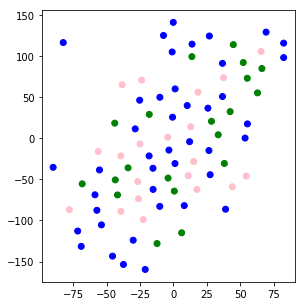

In [392]:
show_tsne_plot(all_datasets[('s6', '1.5s after outcome reveal', 'win', 2, True)], plot_trials=True)  

In [393]:
b = behavior_data['s6']
b = b[b['trial.included'] == 1]
b['outcome'].value_counts()

Win              82
WouldHaveLost    57
Loss             27
WouldHaveWon     21
Name: outcome, dtype: int64

80% of values closest to the mean in (-3.679168939590454, 4.107121467590332)
Full range: (-57.47934341430664, 68.1337890625)


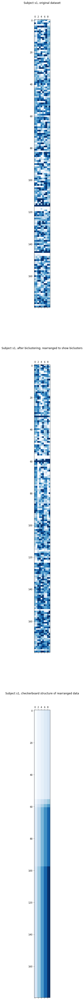

In [332]:
# (('s1', '1.5s after outcome reveal', 'all', 2, True, 'log', 5, 'randomized'), 0.706)
res = spectral_bicluster(all_datasets[('s1', '1.5s after outcome reveal', 'all', 2, True)], n_clusters=5, method='log', 
                         svd_method='randomized', s_name='s1', use_limits=True)

80% of values closest to the mean in (-4.536334991455078, 4.0374040603637695)
Full range: (-12.08127212524414, 13.29546070098877)


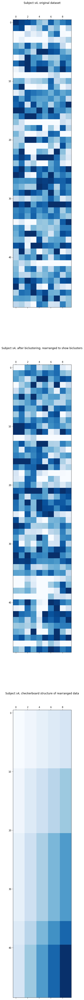

In [329]:
# (('s4', 'between game presentation and buttonpress', 'gamble', 2, True, 'log', 5, 'randomized'), 0.703)
res = spectral_bicluster(all_datasets[('s4', 'between game presentation and buttonpress', 'gamble', 2, True)], n_clusters=5, 
                         method='log', svd_method='randomized', s_name='s4', use_limits=True)

## Visualizing the results

In [233]:
def plot_params_both_algs(param_tuples_cocl, param_tuples_bicl, param_name, title=''):
    if param_name == 'subject':
        arr_cocl = np.array(sorted(param_tuples_cocl, key=lambda x: int(x[0][1:]))) # sorts by subject's nr
        arr_bicl = np.array(sorted(param_tuples_bicl, key=lambda x: int(x[0][1:])))
    else:
        arr_cocl = np.array(sorted(param_tuples_cocl)) # sorts by param name
        arr_bicl = np.array(sorted(param_tuples_bicl))
    
    if param_name == 'n_clusters':
        arr_cocl = arr_cocl[:-1]  # remove the tuple with n_clusters=8 bc bicluster only has upto 7
    
    assert list(arr_cocl[:, 0]) == list(arr_bicl[:, 0]), "Tuples in wrong order! %s and %s" % (str(list(arr_cocl[:, 0])),
                                                                                               str(list(arr_bicl[:, 0])))
    
    n_vals = len(arr_cocl)
    models = list(np.repeat("SpCocluster", n_vals)) + list(np.repeat("SpBicluster", n_vals))
    
    data = pd.DataFrame({param_name: list(arr_cocl[:, 0]) + list(arr_bicl[:, 0]), 'model': models,
                         'ASR': list(arr_cocl[:, 1]) + list(arr_bicl[:, 1])})
    if param_name == 'tw_type':
        data = data.replace(AFTER_OUTCOME, 'Type A').replace(GAMEPRES_BUTTONPRESS, 'Type B')
        
    data['ASR'] = data['ASR'].astype(float)
    
    sns.catplot(x=param_name, y="ASR", hue="model", data=data, kind="bar").set(title=title)

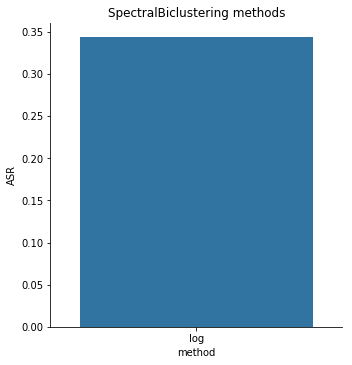

In [262]:
method_data = pd.DataFrame(sort_by_param(result_statistics_spec_2, 'method'), columns=['method', 'ASR'])
sns.catplot(x='method', y='ASR', data=method_data, kind='bar').set(title="SpectralBiclustering methods")

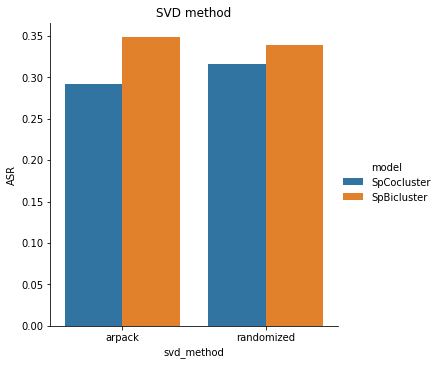

In [263]:
plot_params_both_algs(sort_by_param(result_statistics_cocl_2, 'svd_method'), 
                      sort_by_param(result_statistics_spec_2, 'svd_method'),
                     'svd_method',
                      'SVD method')

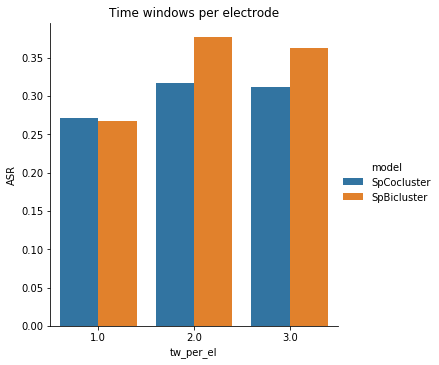

In [264]:
plot_params_both_algs(sort_by_param(result_statistics_cocl_2, 'tw_per_el'), 
                      sort_by_param(result_statistics_spec_2, 'tw_per_el'),
                     'tw_per_el',
                     'Time windows per electrode')

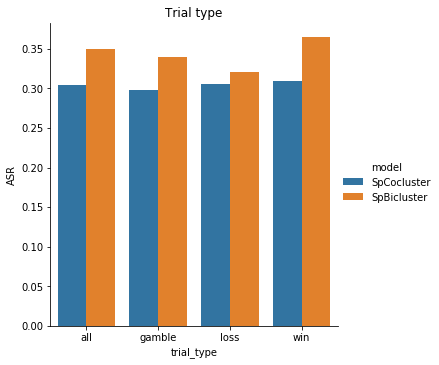

In [265]:
plot_params_both_algs(sort_by_param(result_statistics_cocl_2, 'trial_type'), 
                      sort_by_param(result_statistics_spec_2, 'trial_type'),
                     'trial_type',
                     'Trial type')

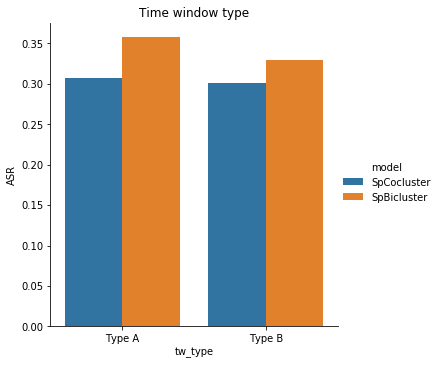

In [266]:
plot_params_both_algs(sort_by_param(result_statistics_cocl_2, 'tw_type'), 
                      sort_by_param(result_statistics_spec_2, 'tw_type'),
                     'tw_type',
                     'Time window type')

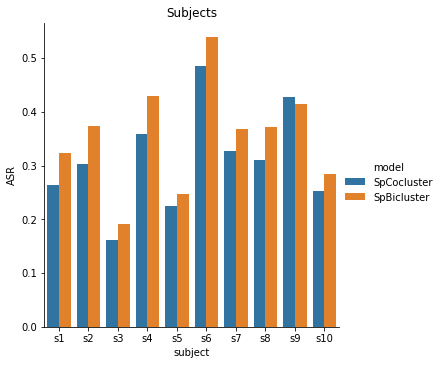

In [267]:
plot_params_both_algs(sort_by_param(result_statistics_cocl_2, 'subjects'), sort_by_param(result_statistics_spec_2, 'subjects'),
                     'subject', 'Subjects')

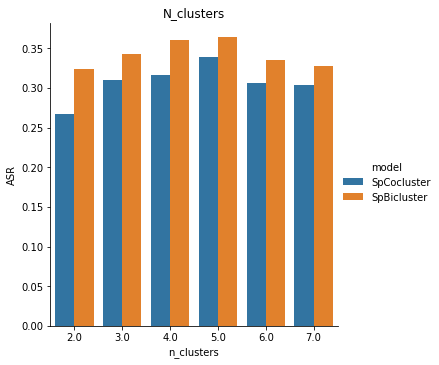

In [268]:
plot_params_both_algs(sort_by_param(result_statistics_cocl_2, 'n_clusters'), 
                      sort_by_param(result_statistics_spec_2, 'n_clusters'),
                     'n_clusters',
                     'N_clusters')

In [269]:
def plot_types_grouped(cocl_dict, bicl_dict, trial_to_tw=True):
    
    if trial_to_tw:
        models = []
        asr_scores = []
        trial_types = []
        tw_types = []
        
        for trial_type in [GAMBLE, LOSS, ALL, WIN]:
            for tw_type in [AFTER_OUTCOME, GAMEPRES_BUTTONPRESS]:
                asr_scores.append(cocl_dict[trial_type][tw_type])
                asr_scores.append(bicl_dict[trial_type][tw_type])
                trial_types += [trial_type, trial_type]
                tw_type = 'Type A' if tw_type == AFTER_OUTCOME else 'Type B'
                tw_types += [tw_type, tw_type]
                models += ["SpectralCocluster", "SpectralBicluster"]
        
        data = pd.DataFrame({"trial_type": trial_types, "ASR": asr_scores, "tw_type": tw_types, 
                                 "model": models})
        sns.catplot(x="trial_type", y="ASR", hue="tw_type", col="model", data=data, kind="bar", height=4, aspect=.8)
        
    else:
        models = []
        asr_scores = []
        tw_types = []
        tw_per_els = []
        
        for tw_type in [AFTER_OUTCOME, GAMEPRES_BUTTONPRESS]:
            for tw_per_el in [1,2,3]:
                asr_scores.append(cocl_dict[tw_type][tw_per_el])
                asr_scores.append(bicl_dict[tw_type][tw_per_el])
                tw_type_lbl = 'Type A' if tw_type == AFTER_OUTCOME else 'Type B'
                tw_types += [tw_type_lbl, tw_type_lbl]
                tw_per_els += [tw_per_el, tw_per_el]
                models += ["SpectralCocluster", "SpectralBicluster"]
        
        data = pd.DataFrame({"tw_type": tw_types, "ASR": asr_scores, "tw_per_el": tw_per_els, 
                                 "model": models})
        sns.catplot(x="tw_type", y="ASR", hue="tw_per_el", col="model", data=data, kind="bar", height=4, aspect=.8)

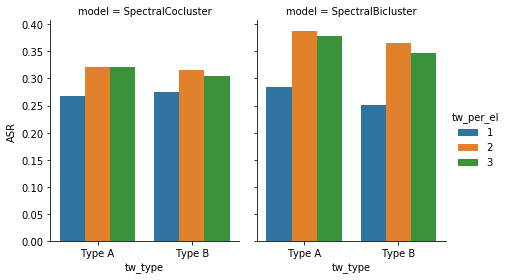

In [270]:
plot_types_grouped(cocl_dict=cocl_dict_2, bicl_dict=bicl_dict_2, trial_to_tw=False)

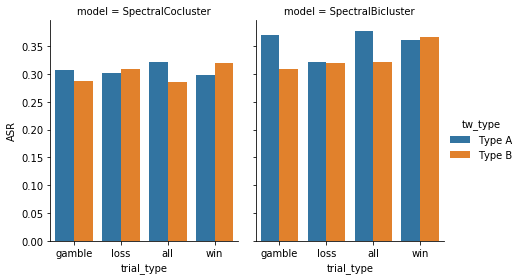

In [271]:
plot_types_grouped(cocl_dict=cocl_dict_2, bicl_dict=bicl_dict_2)

## t-SNE

In [549]:
def show_tsne_plot_2(data, behav_data, plot_trials=True, plot_loss_win=False, plot_gamble=False, n=20, perplexity=30, 
                     n_iter=1000):
    n_features = len(data[0])

    data_tsne = None
    if n_features >= 35:
        data_reduced = TruncatedSVD(n_components=30, random_state=0).fit_transform(data)
        data_tsne = TSNE(perplexity=perplexity, n_iter=n_iter).fit_transform(data_reduced)
    else:
        data_tsne = TSNE(perplexity=perplexity, n_iter=n_iter).fit_transform(data)

#     plt.figure(figsize=(10, 5))
#     plt.subplot(121)
    if n is not None:
        if plot_trials and len(data) > 2 * n:
            # paint the first 20 trials green, the last 20 trials pink and all other trials blue
            colors = ["green" for _ in range(n)] + ["blue" for _ in range(len(data) - 2 * n)] + ["pink" for _ in range(n)]
            plt.scatter(data_tsne[:, 0], data_tsne[:, 1], c=colors)
        else:
            plt.scatter(data_tsne[:, 0], data_tsne[:, 1])
    elif plot_loss_win:
        behav_data = behav_data[behav_data['trial.included'] == 1]
        behav_data = behav_data.reset_index(drop=True)
        loss_idx = behav_data[behav_data['outcome'] == 'Loss'].index
        win_idx = behav_data[behav_data['outcome'] == 'Win'].index
        colors = []
        for i in range(len(data)):
            color = "blue"
            if i in loss_idx:
                color = "red"
            elif i in win_idx:
                color = "green"
            colors.append(color)
        plt.scatter(data_tsne[:, 0], data_tsne[:, 1], c=colors)
    elif plot_gamble:
        behav_data = behav_data[behav_data['trial.included'] == 1]
        behav_data = behav_data.reset_index(drop=True)
        gamble_idx = behav_data[behav_data['choice.class'] == 'Gamble'].index
        safebet_idx = behav_data[behav_data['choice.class'] == 'Safebet'].index
        colors = []
        for i in range(len(data)):
            if i in gamble_idx:
                color = "red"
            elif i in safebet_idx:
                color = "green"
            colors.append(color)
        plt.scatter(data_tsne[:, 0], data_tsne[:, 1], c=colors)
#     plt.show()

In [553]:
def tsne_plots_multiple_perplexities(data, behav_data, perplexities=[2, 5, 10, 15, 20, 25, 30, 60, 100], plot_trials=True, 
                                     plot_loss_win=False, plot_gamble=False, n=None, n_iter=1000):
    cols = 3
    rows = ceil(len(perplexities) / cols)
    plt.rcParams['figure.figsize'] = [cols * 6, rows * 5]
    
    for i in range(1, len(perplexities) + 1):
        plt.subplot(rows, cols, i)
        p = perplexities[i - 1]
        show_tsne_plot_2(data=data, behav_data=behav_data, plot_trials=plot_trials, plot_loss_win=plot_loss_win, 
                         plot_gamble=plot_gamble, n=n, perplexity=p, n_iter=n_iter)
        plt.title("Perplexity " + str(p))

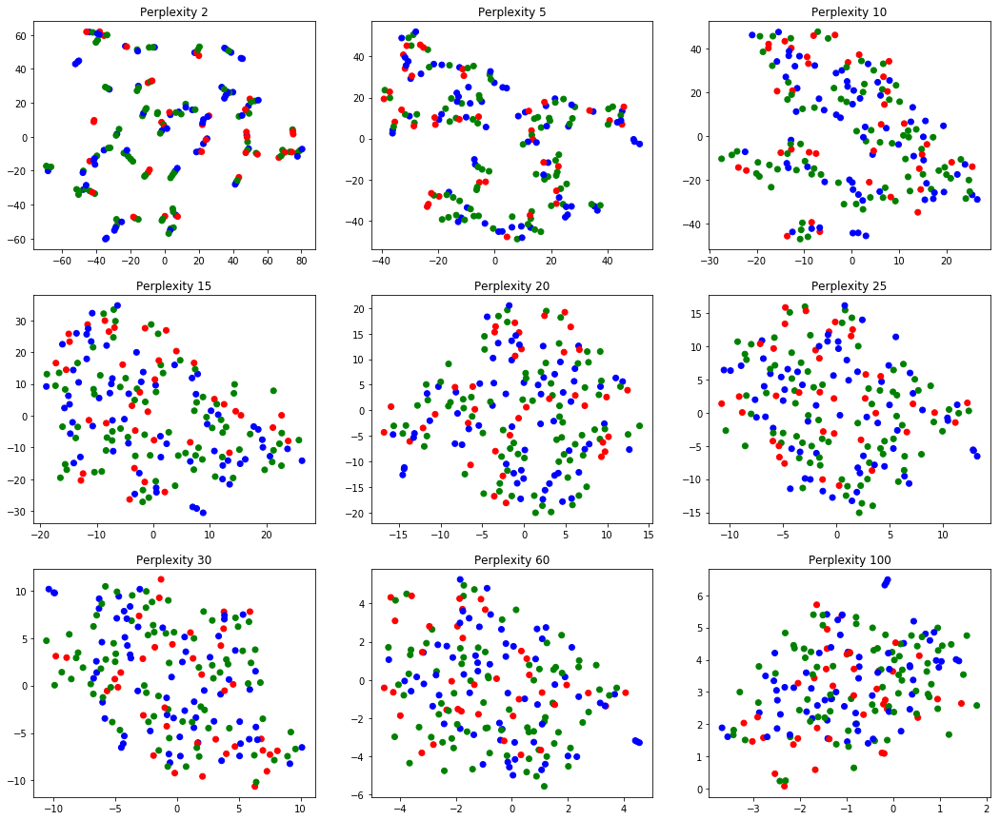

In [554]:
tsne_plots_multiple_perplexities(data=all_datasets[('s1', '1.5s after outcome reveal', 'all', 1, True)], 
                                 behav_data=behavior_data['s1'], plot_loss_win=True)  

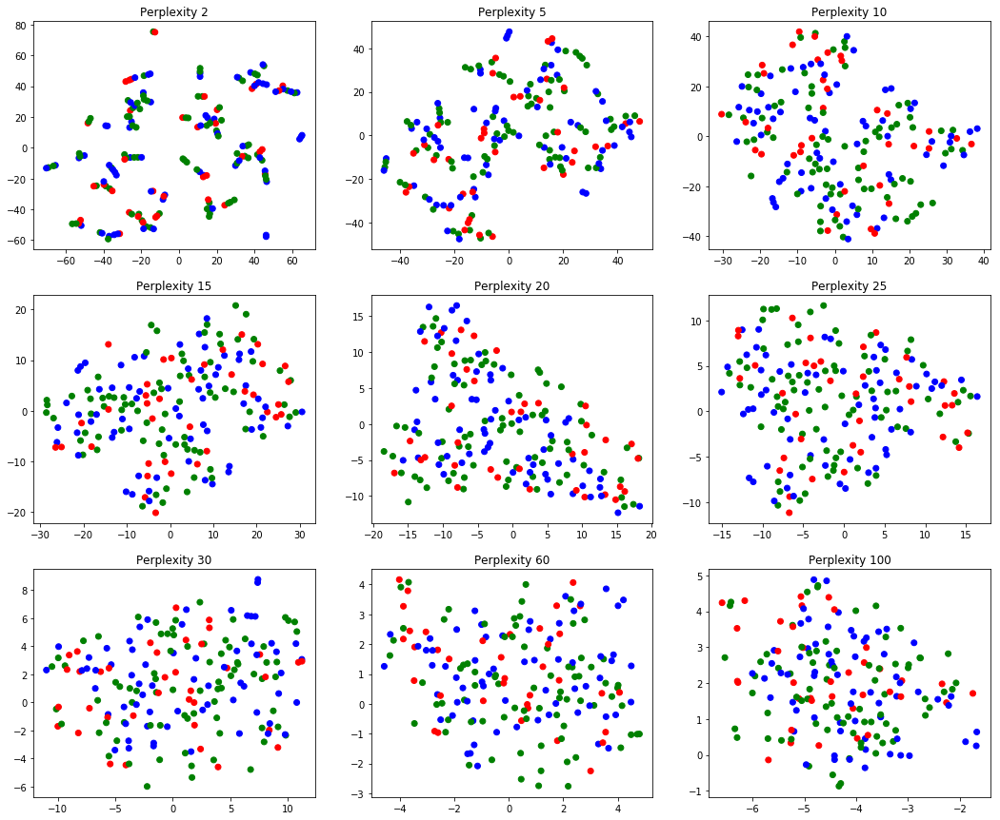

In [555]:
tsne_plots_multiple_perplexities(all_datasets[('s1', '1.5s after outcome reveal', 'all', 2, True)], behavior_data['s1'], 
                                 plot_loss_win=True, n=None)  

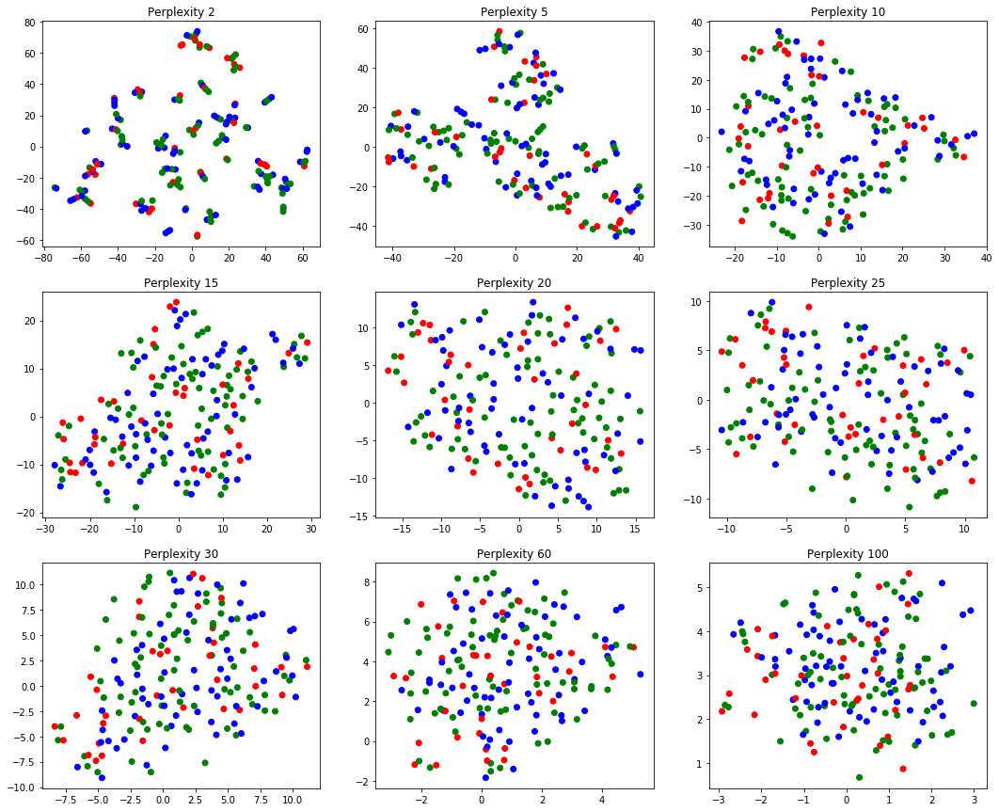

In [556]:
tsne_plots_multiple_perplexities(all_datasets[('s1', '1.5s after outcome reveal', 'all', 3, True)], behavior_data['s1'], 
                 plot_loss_win=True, n=None)  

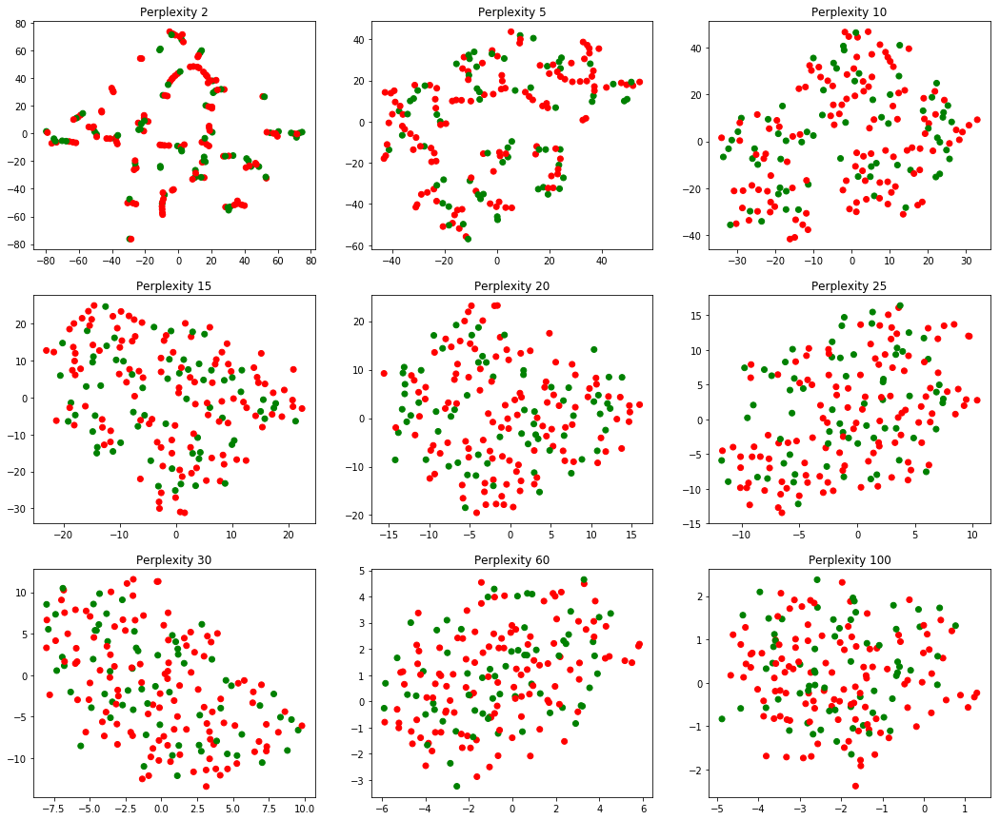

In [557]:
tsne_plots_multiple_perplexities(all_datasets[('s1', GAMEPRES_BUTTONPRESS, 'all', 1, True)], behavior_data['s1'], 
                 plot_gamble=True, n=None)  

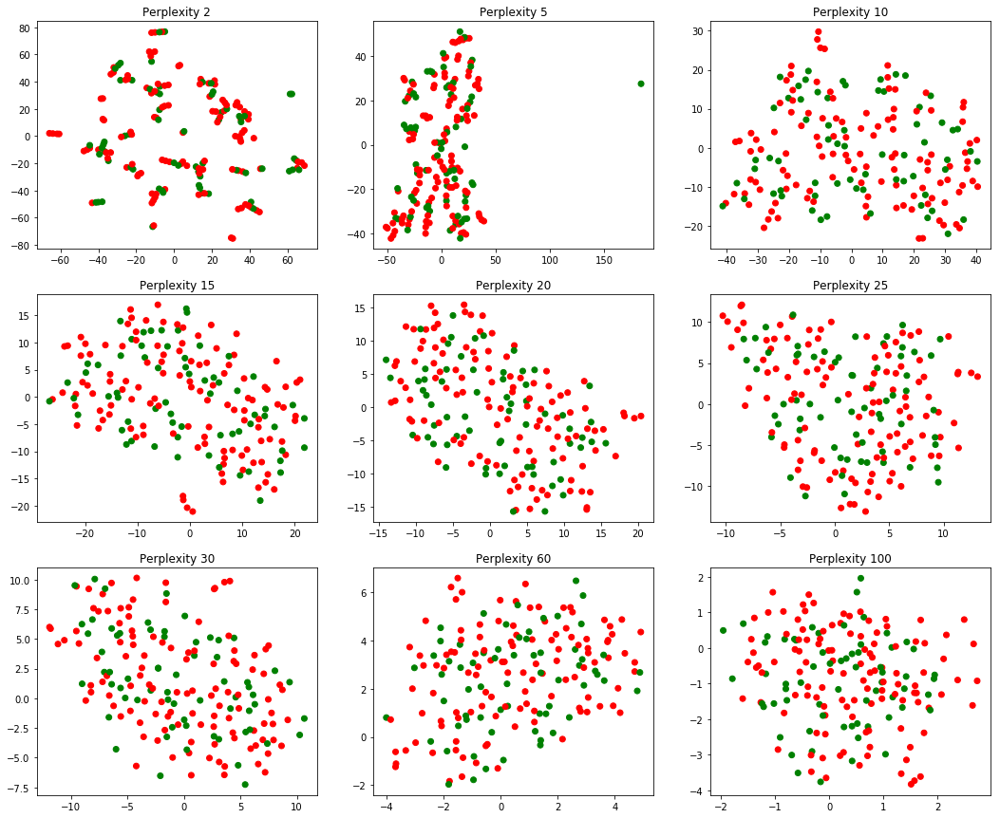

In [558]:
tsne_plots_multiple_perplexities(all_datasets[('s1', GAMEPRES_BUTTONPRESS, 'all', 2, True)], behavior_data['s1'], 
                 plot_gamble=True, n=None)  

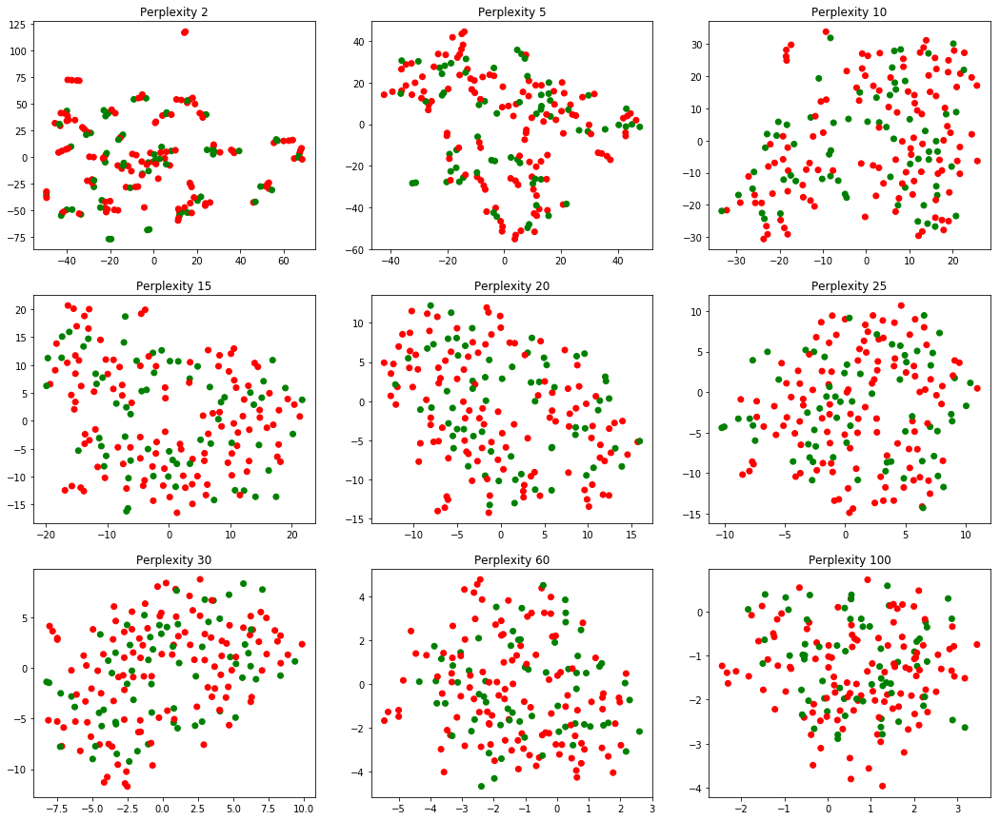

In [559]:
tsne_plots_multiple_perplexities(all_datasets[('s1', GAMEPRES_BUTTONPRESS, 'all', 3, True)], behavior_data['s1'], 
                 plot_gamble=True, n=None)  

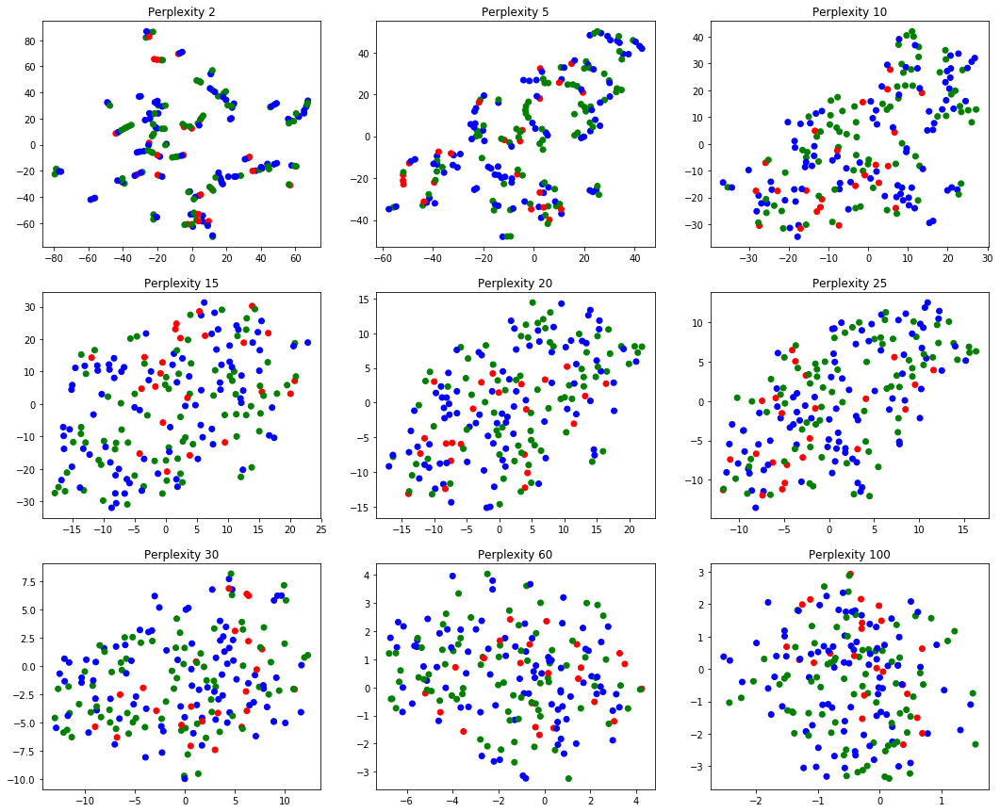

In [560]:
tsne_plots_multiple_perplexities(all_datasets[('s2', '1.5s after outcome reveal', 'all', 1, True)], behavior_data['s2'],
                 plot_loss_win=True, n=None)  

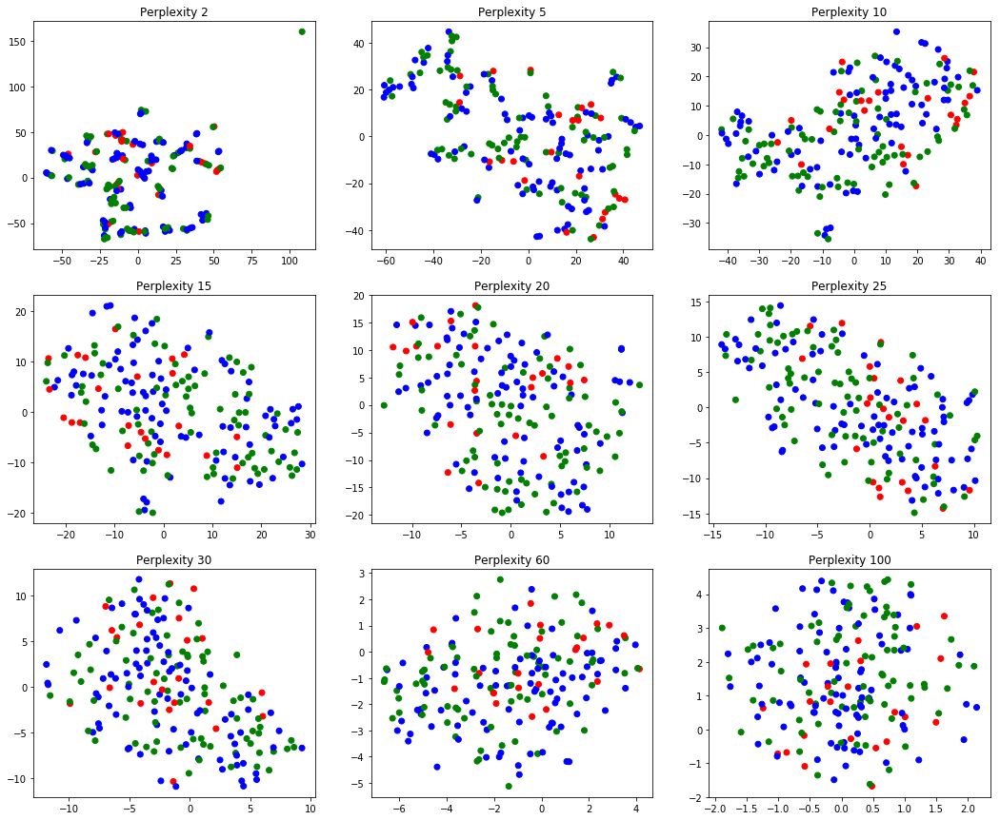

In [561]:
tsne_plots_multiple_perplexities(all_datasets[('s2', '1.5s after outcome reveal', 'all', 2, True)], behavior_data['s2'],
                 plot_loss_win=True, n=None)  

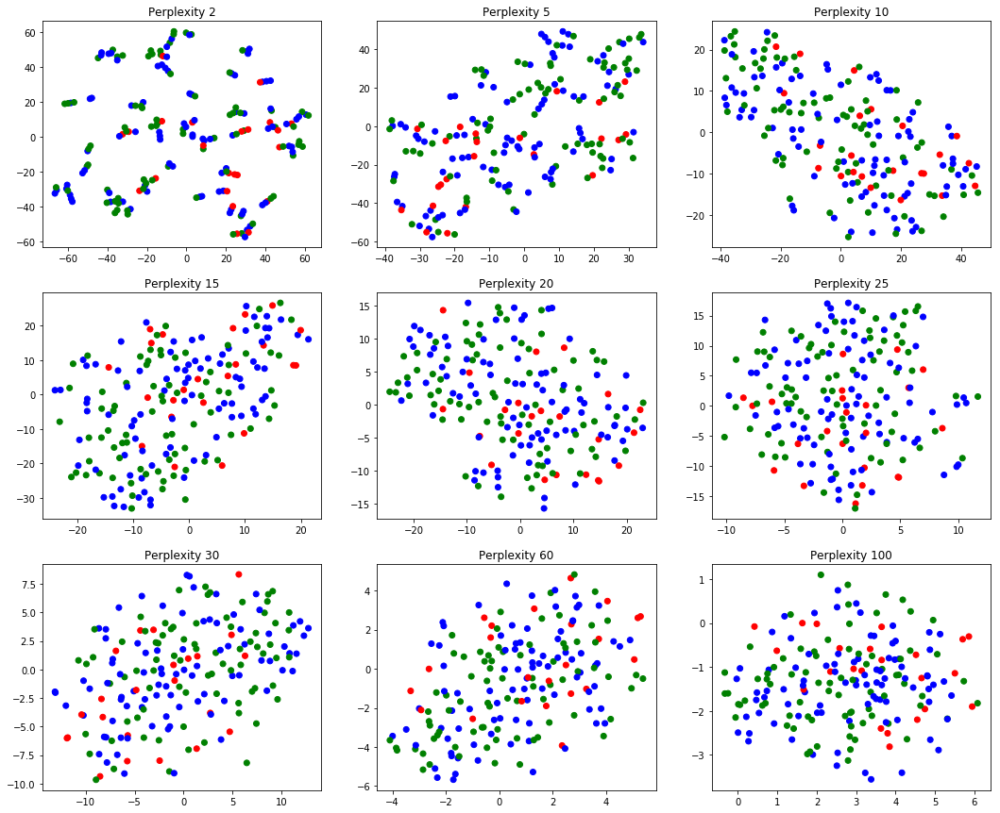

In [562]:
tsne_plots_multiple_perplexities(all_datasets[('s2', '1.5s after outcome reveal', 'all', 3, True)], behavior_data['s2'],
                 plot_loss_win=True, n=None)  

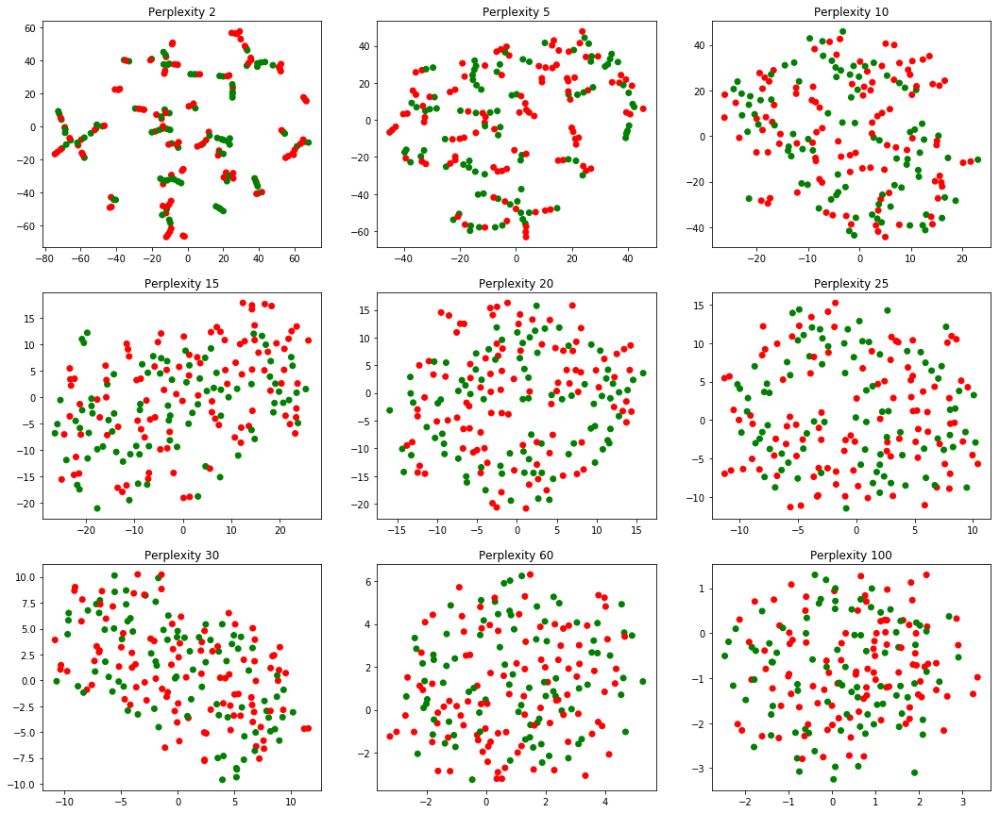

In [563]:
tsne_plots_multiple_perplexities(all_datasets[('s2', GAMEPRES_BUTTONPRESS, 'all', 1, True)], behavior_data['s2'], 
                 plot_gamble=True, n=None)

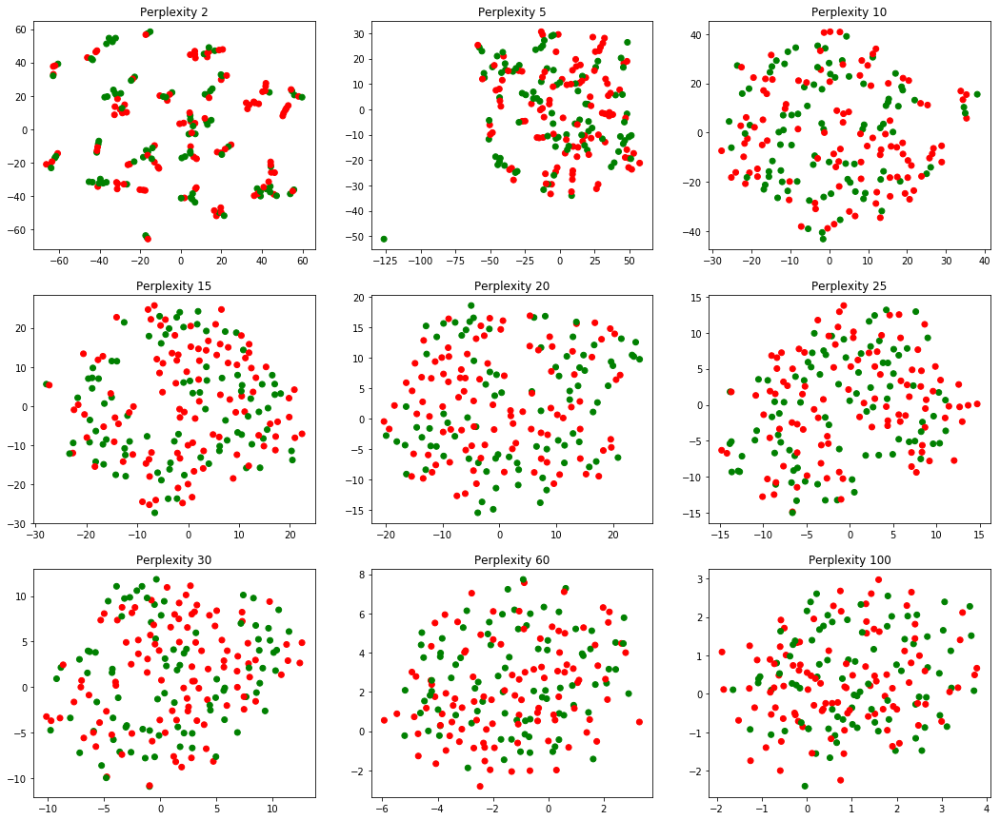

In [564]:
tsne_plots_multiple_perplexities(all_datasets[('s2', GAMEPRES_BUTTONPRESS, 'all', 2, True)], behavior_data['s2'], 
                 plot_gamble=True, n=None)

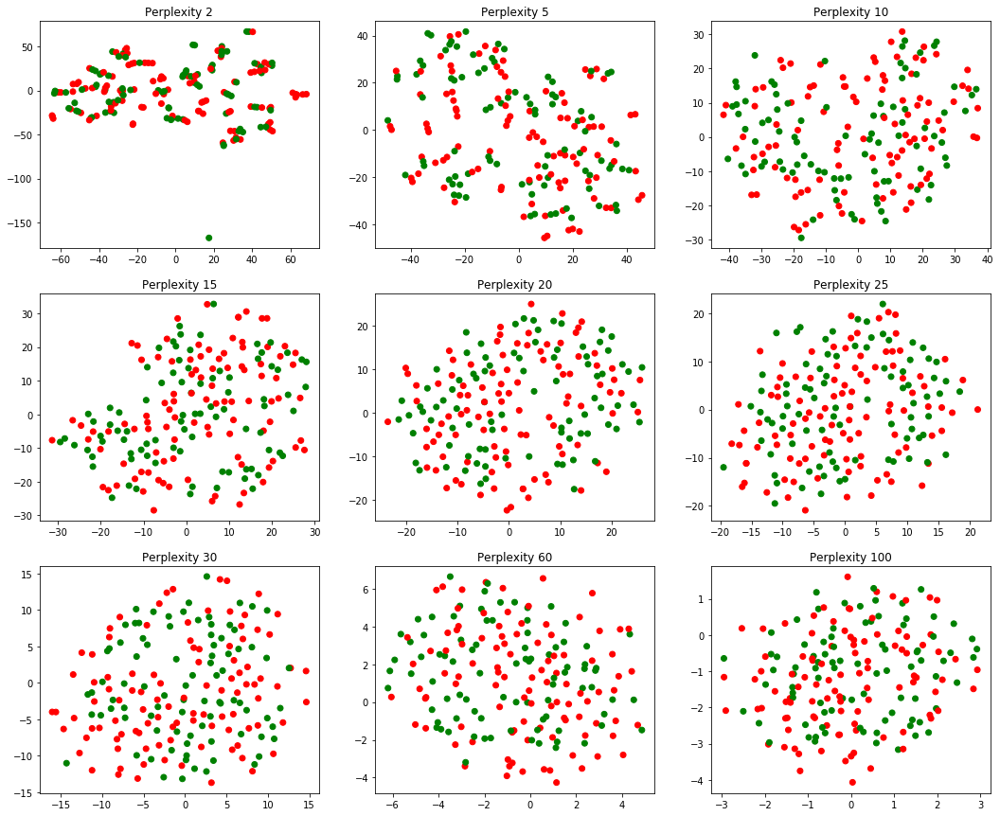

In [565]:
tsne_plots_multiple_perplexities(all_datasets[('s2', GAMEPRES_BUTTONPRESS, 'all', 3, True)], behavior_data['s2'], 
                 plot_gamble=True, n=None)

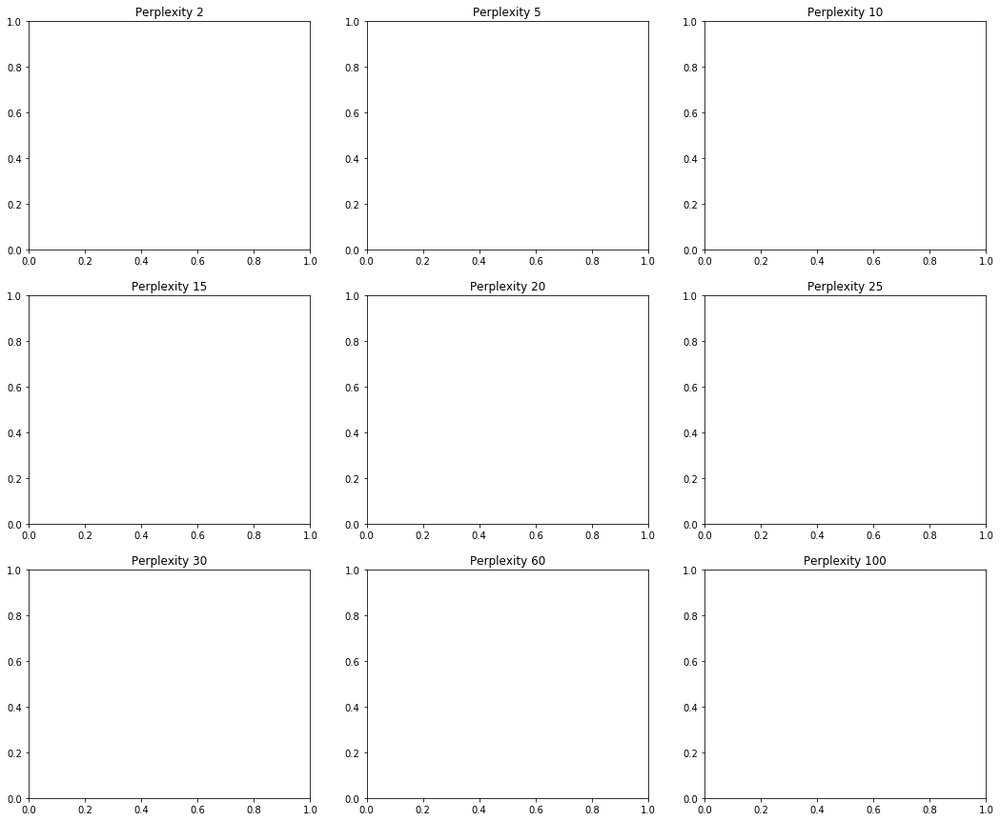

In [566]:
tsne_plots_multiple_perplexities(all_datasets[('s3', '1.5s after outcome reveal', 'all', 1, True)], behavior_data['s3'],
                 plot_trials=True, n=None)  

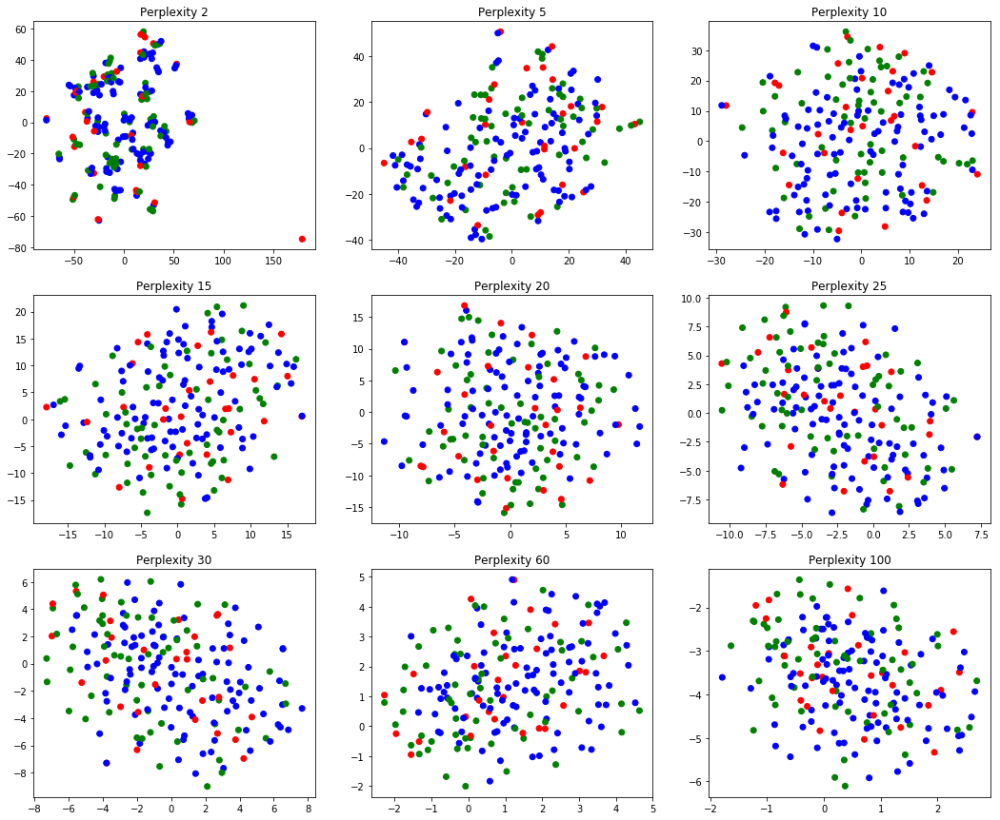

In [567]:
tsne_plots_multiple_perplexities(all_datasets[('s3', '1.5s after outcome reveal', 'all', 2, True)], behavior_data['s3'], 
                 plot_loss_win=True,
                 plot_trials=True, n=None)  

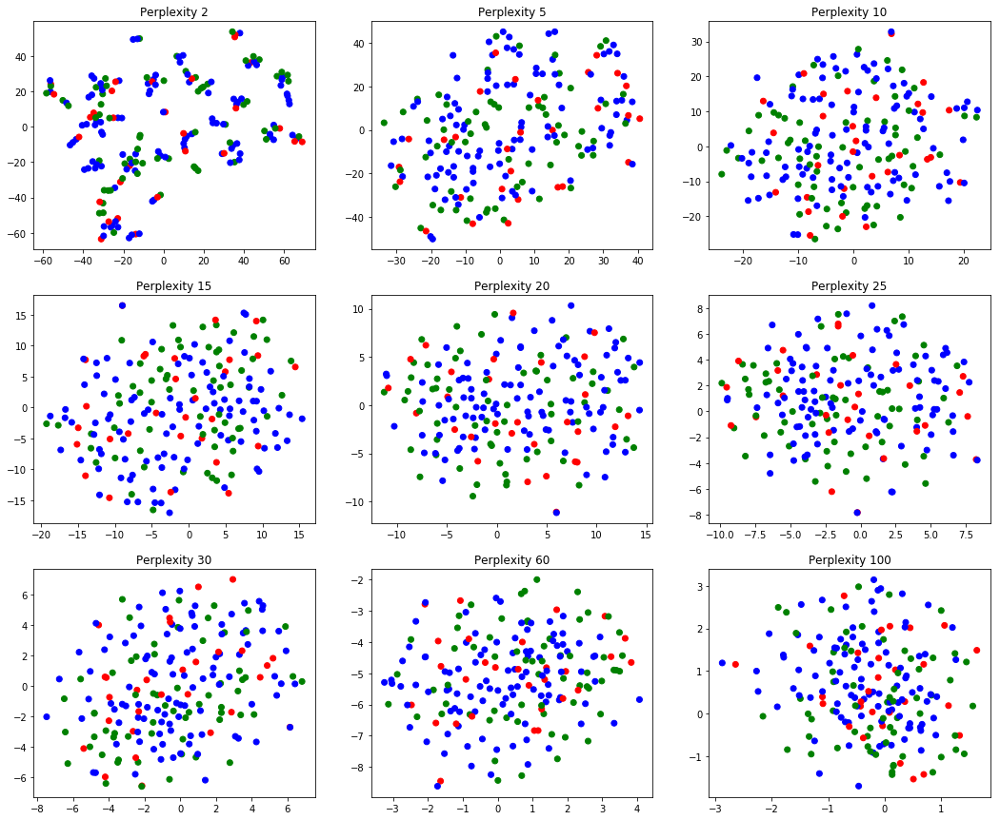

In [568]:
tsne_plots_multiple_perplexities(all_datasets[('s3', '1.5s after outcome reveal', 'all', 3, True)], behavior_data['s3'], 
                 plot_loss_win=True,
                 plot_trials=True, n=None)  

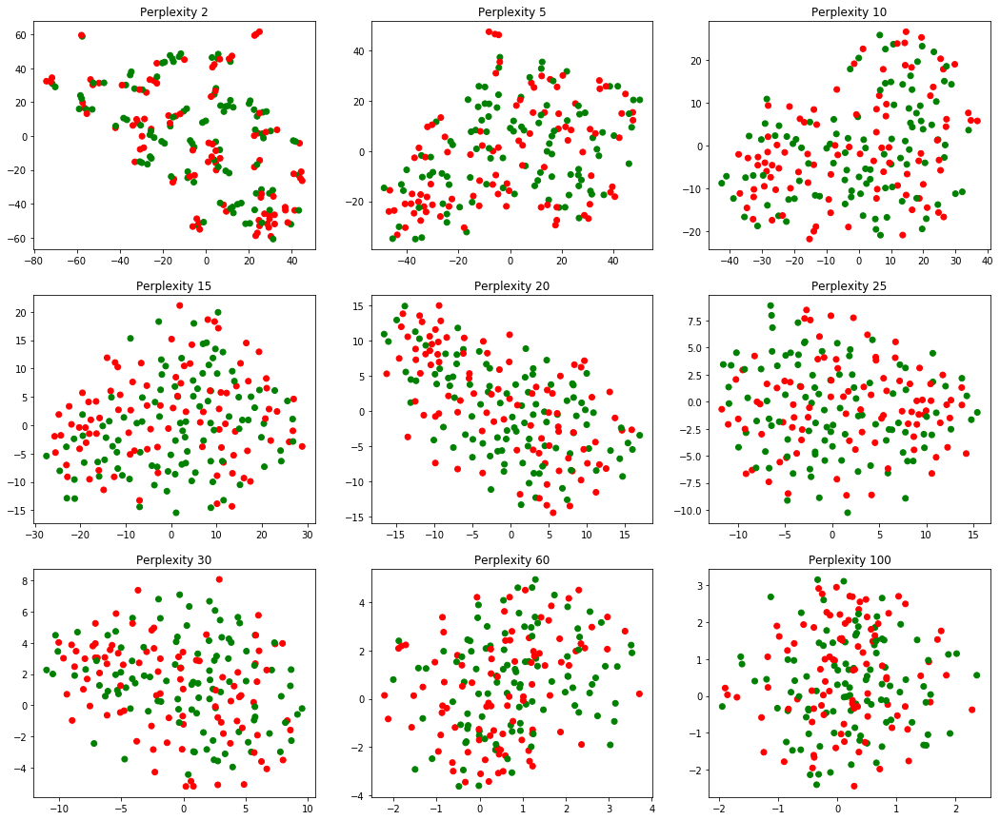

In [569]:
tsne_plots_multiple_perplexities(all_datasets[('s3', GAMEPRES_BUTTONPRESS, 'all', 1, True)], behavior_data['s3'], 
                 plot_gamble=True, n=None)  

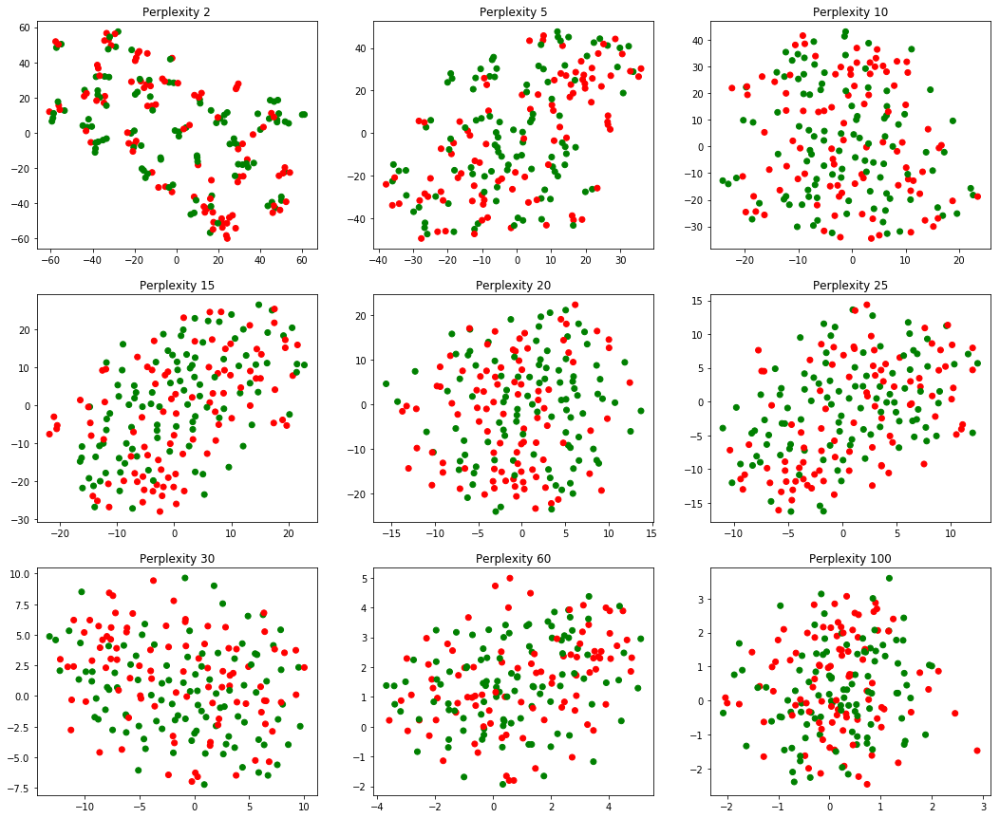

In [570]:
tsne_plots_multiple_perplexities(all_datasets[('s3', GAMEPRES_BUTTONPRESS, 'all', 2, True)], behavior_data['s3'], 
                 plot_gamble=True, n=None)  

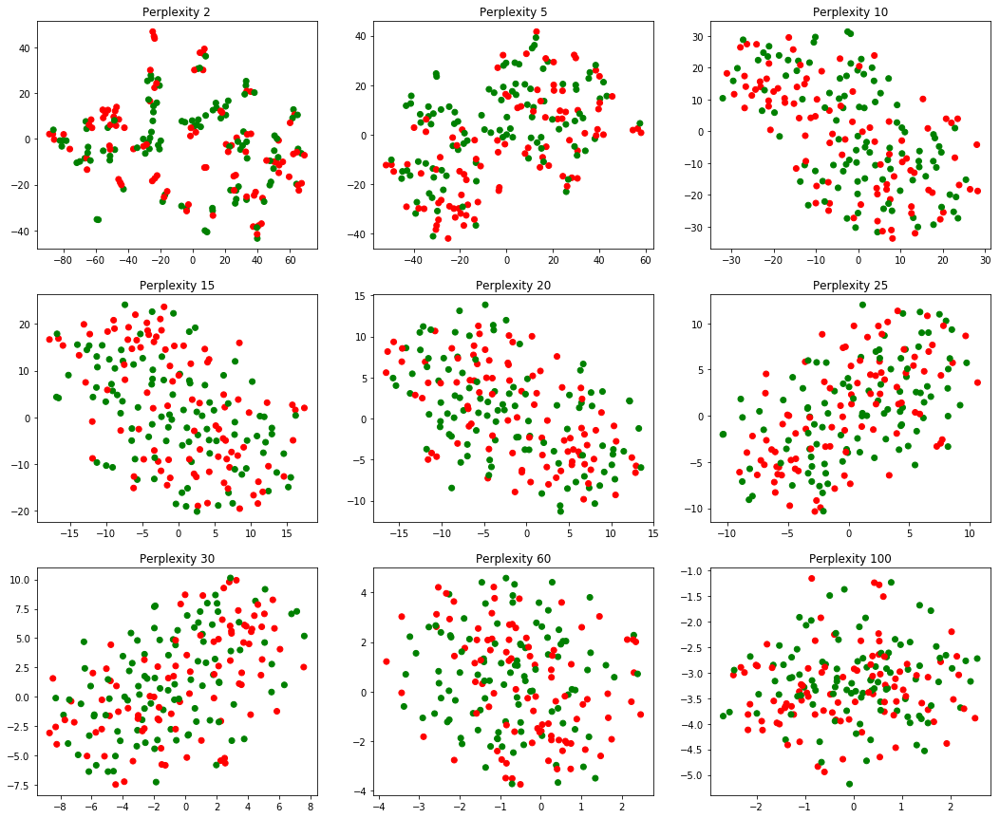

In [571]:
tsne_plots_multiple_perplexities(all_datasets[('s3', GAMEPRES_BUTTONPRESS, 'all', 3, True)], behavior_data['s3'], 
                 plot_gamble=True, n=None)  

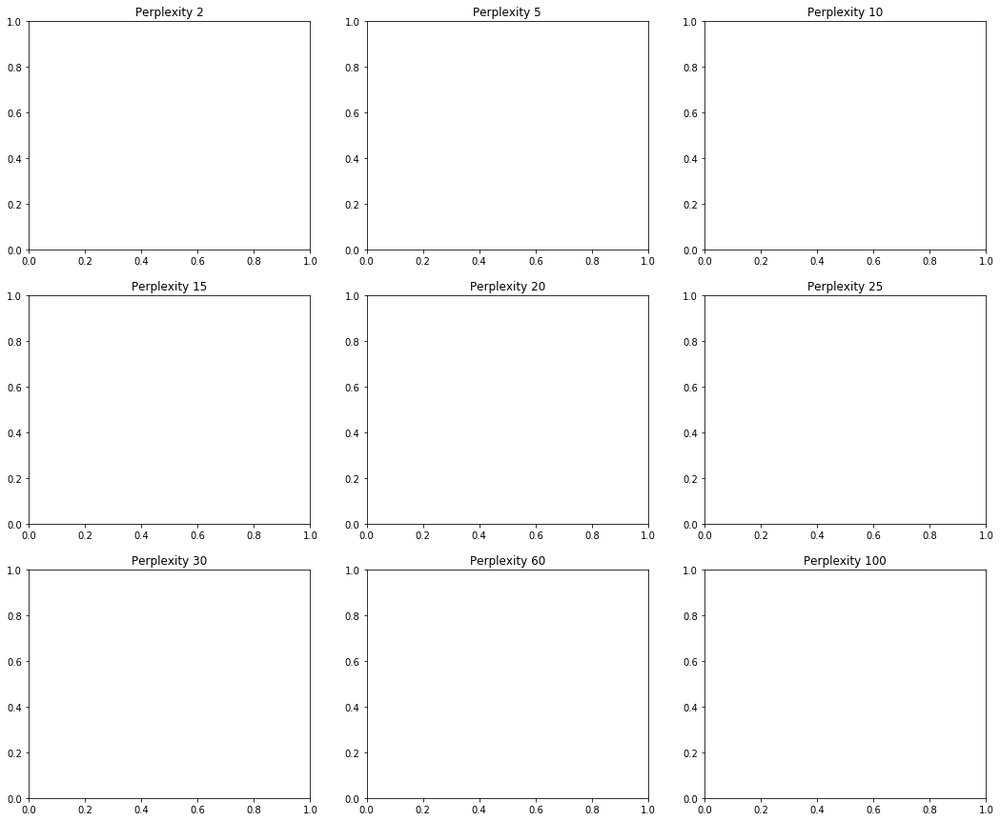

In [572]:
tsne_plots_multiple_perplexities(all_datasets[('s4', '1.5s after outcome reveal', 'all', 1, True)], behavior_data['s4'],
                 plot_trials=True, n=None)  

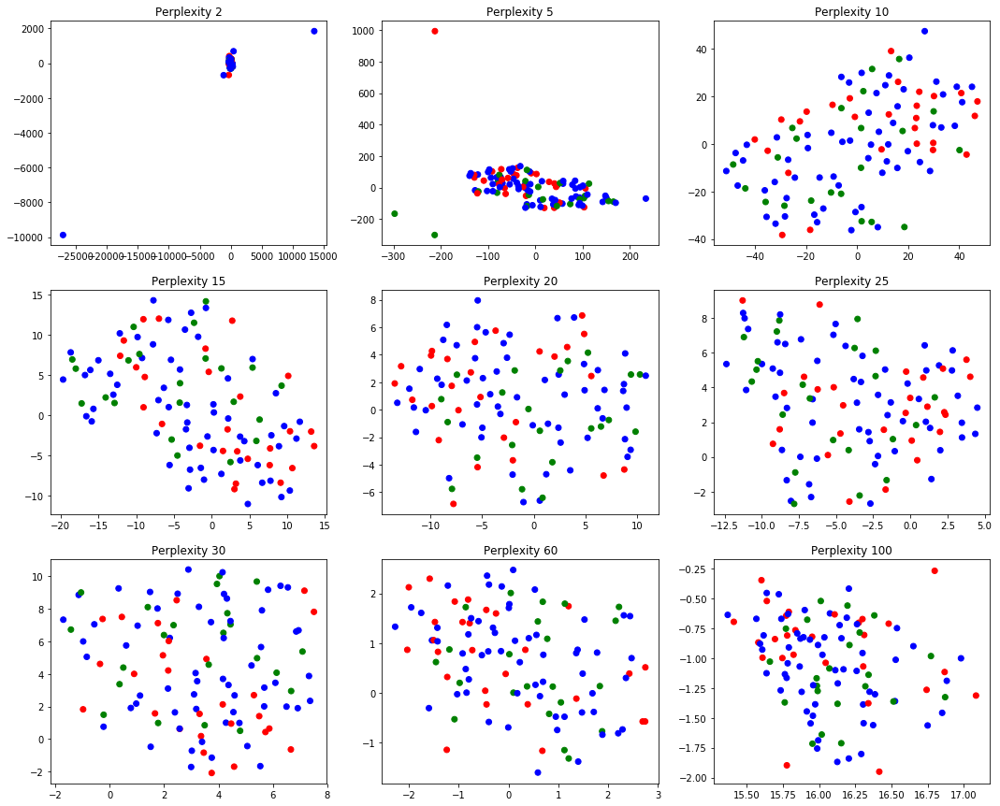

In [573]:
tsne_plots_multiple_perplexities(all_datasets[('s4', '1.5s after outcome reveal', 'all', 2, True)], behavior_data['s4'], 
                                 plot_loss_win=True,
                 plot_trials=True, n=None)  

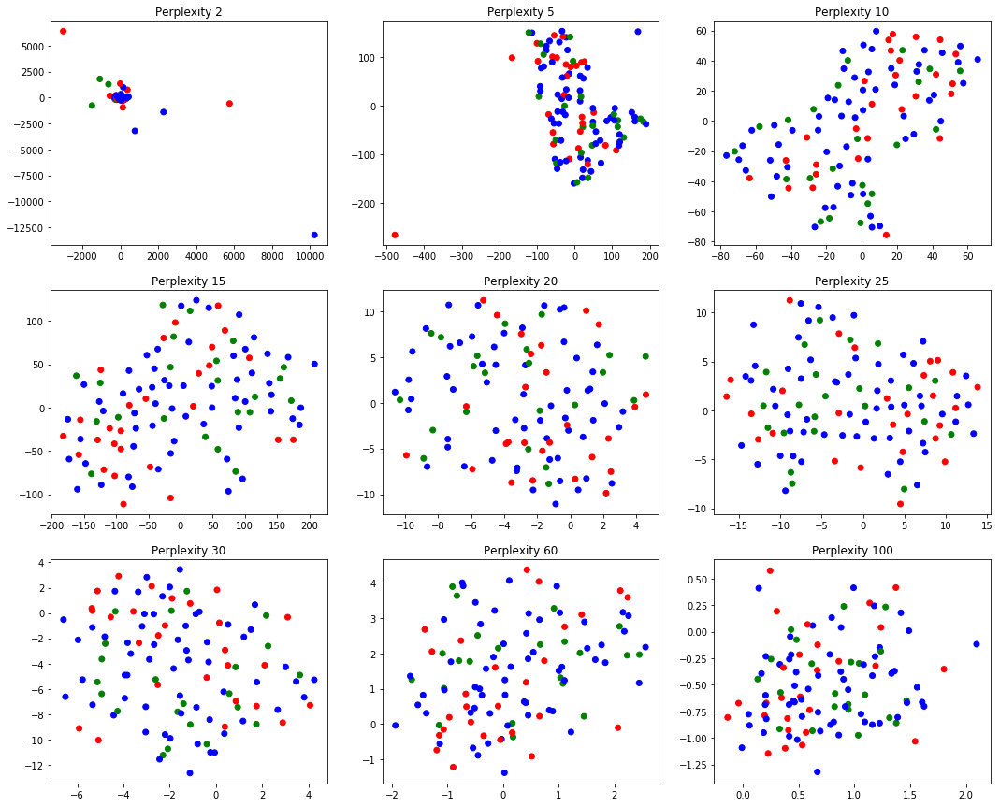

In [574]:
tsne_plots_multiple_perplexities(all_datasets[('s4', AFTER_OUTCOME, 'all', 3, True)], behavior_data['s4'], plot_loss_win=True,
                 plot_trials=True, n=None)  

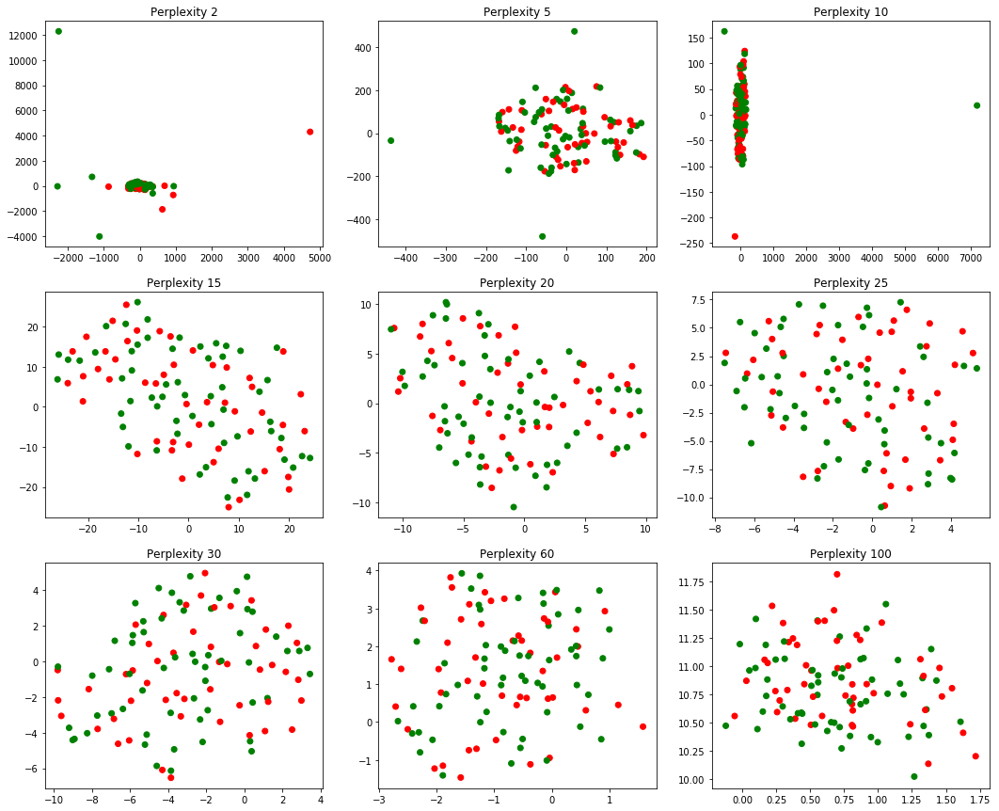

In [575]:
tsne_plots_multiple_perplexities(all_datasets[('s4', GAMEPRES_BUTTONPRESS, 'all', 1, True)], behavior_data['s4'], 
                 plot_gamble=True, n=None)  

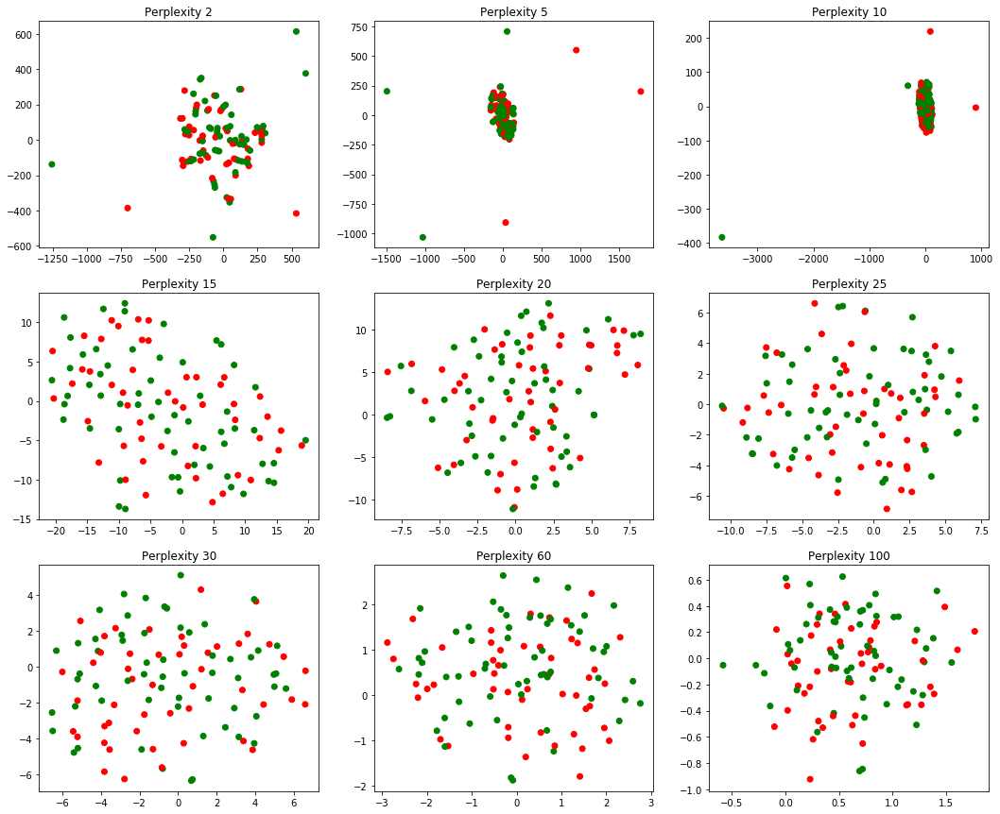

In [576]:
tsne_plots_multiple_perplexities(all_datasets[('s4', GAMEPRES_BUTTONPRESS, 'all', 2, True)], behavior_data['s4'], 
                 plot_gamble=True, n=None)  

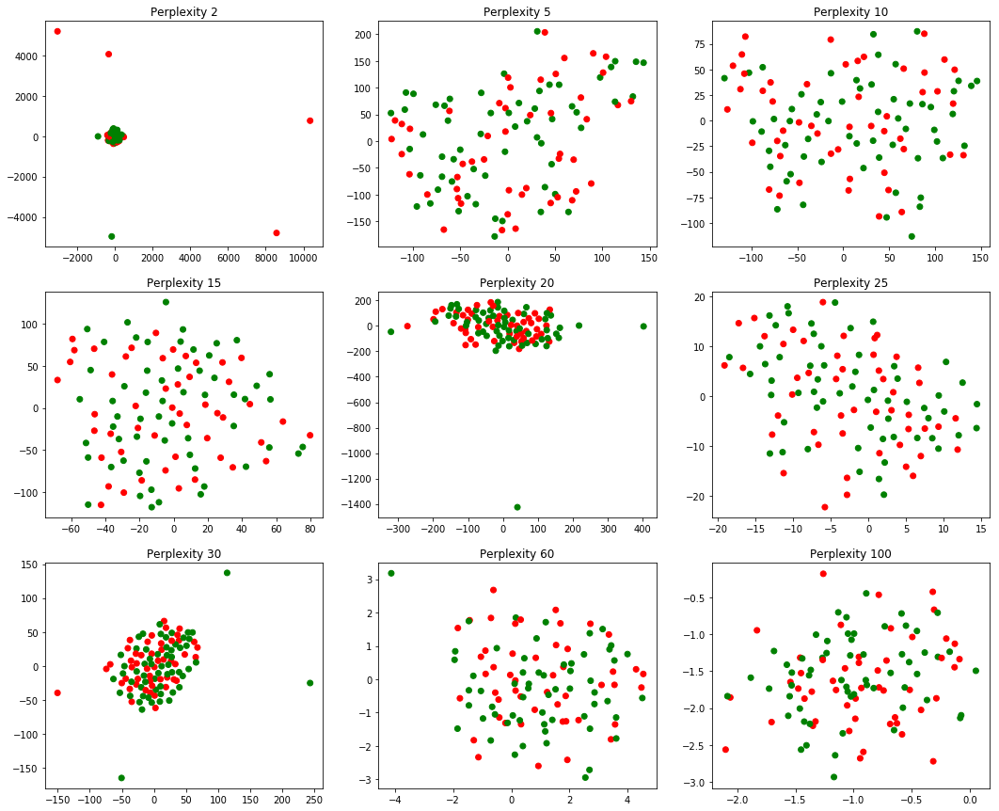

In [577]:
tsne_plots_multiple_perplexities(all_datasets[('s4', GAMEPRES_BUTTONPRESS, 'all', 3, True)], behavior_data['s4'], 
                 plot_gamble=True, n=None)  

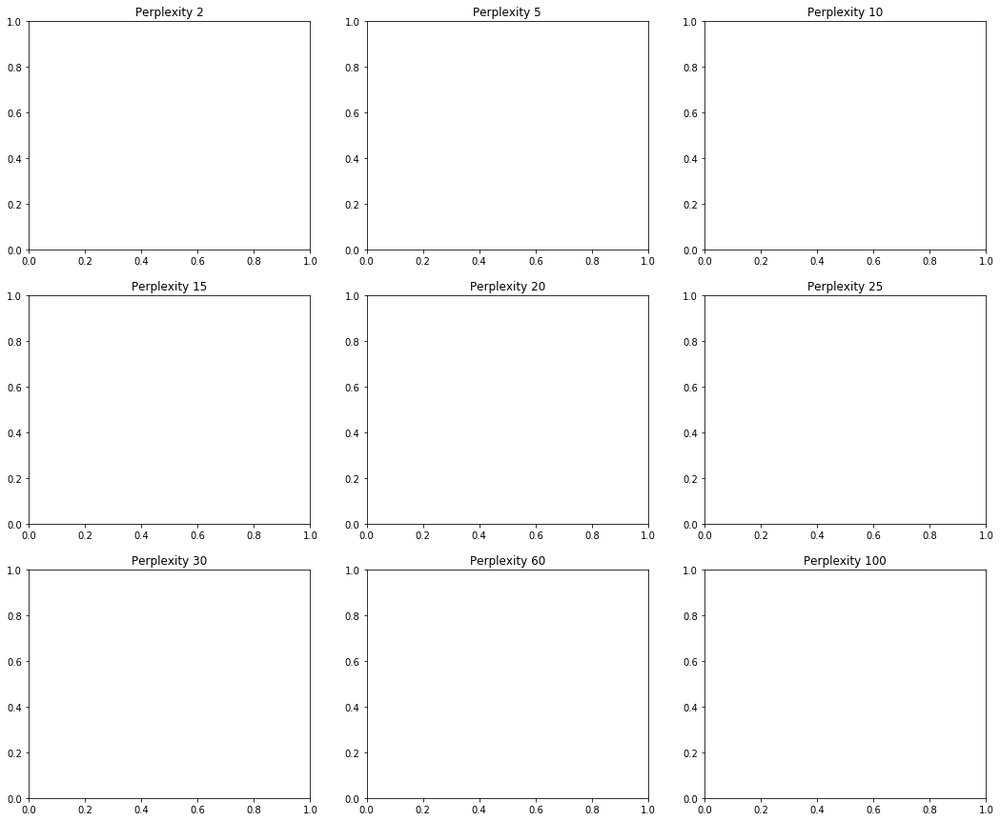

In [578]:
tsne_plots_multiple_perplexities(all_datasets[('s5', '1.5s after outcome reveal', 'all', 1, True)], behavior_data['s5'],
                 plot_trials=True, n=None)  

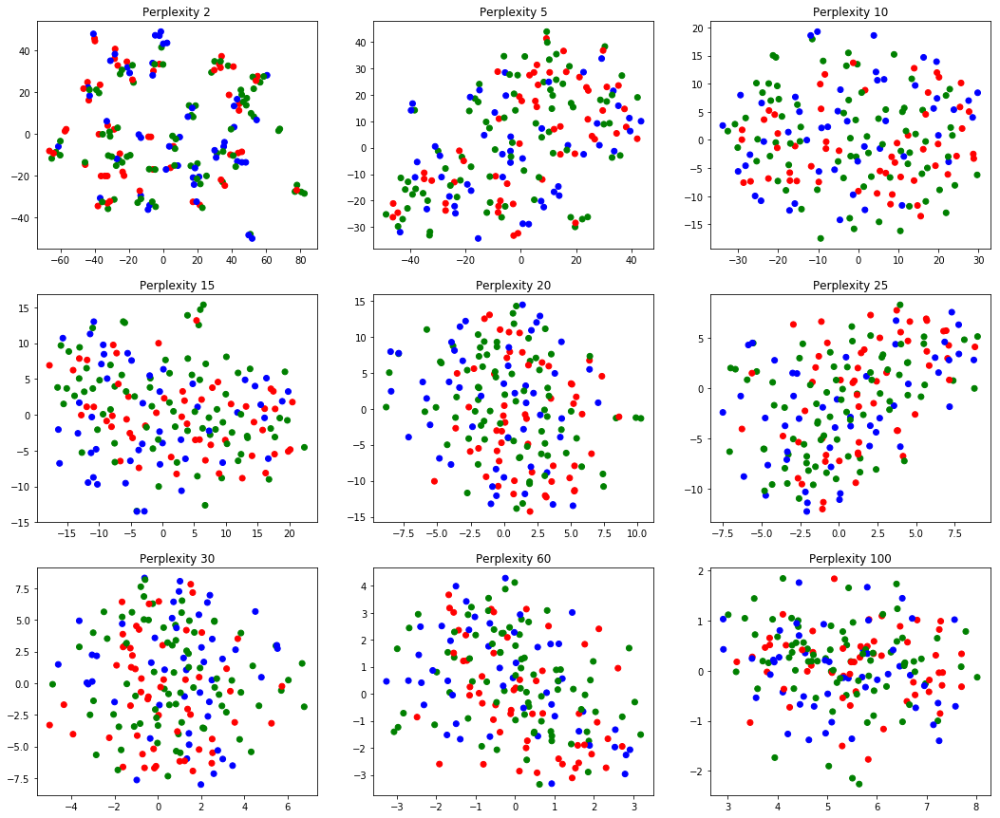

In [579]:
tsne_plots_multiple_perplexities(all_datasets[('s5', '1.5s after outcome reveal', 'all', 2, True)], behavior_data['s5'], 
                                 plot_loss_win=True,
                 plot_trials=True, n=None)  

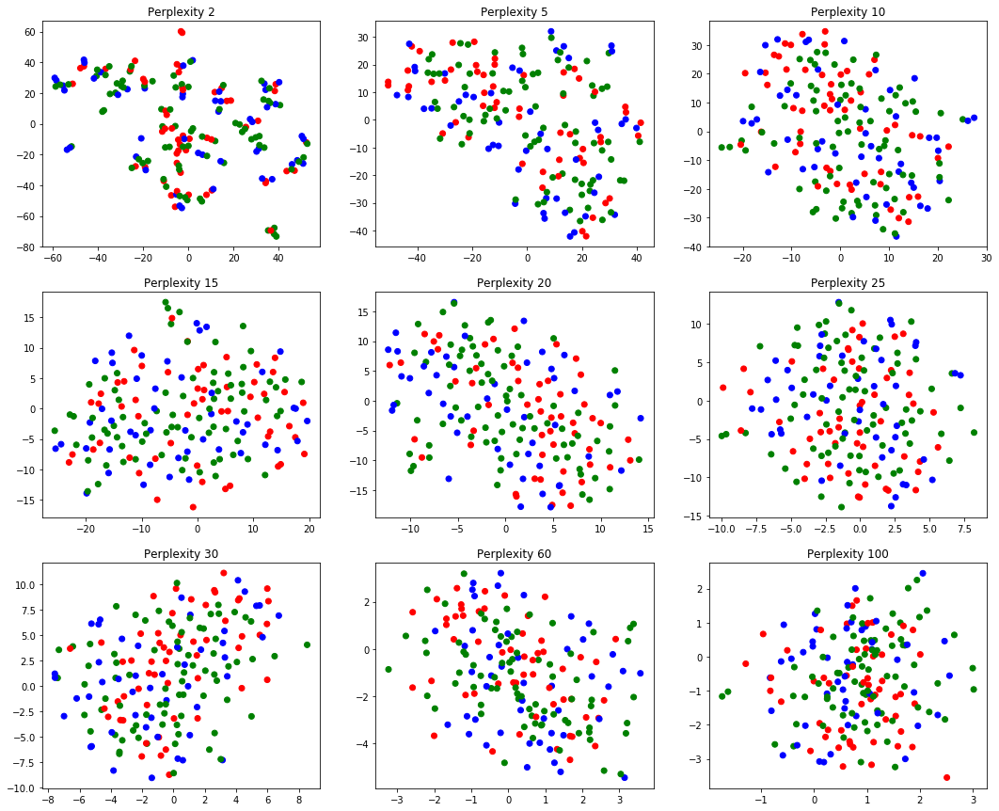

In [580]:
tsne_plots_multiple_perplexities(all_datasets[('s5', '1.5s after outcome reveal', 'all', 3, True)], behavior_data['s5'], 
                                 plot_loss_win=True,
                 plot_trials=True, n=None)  

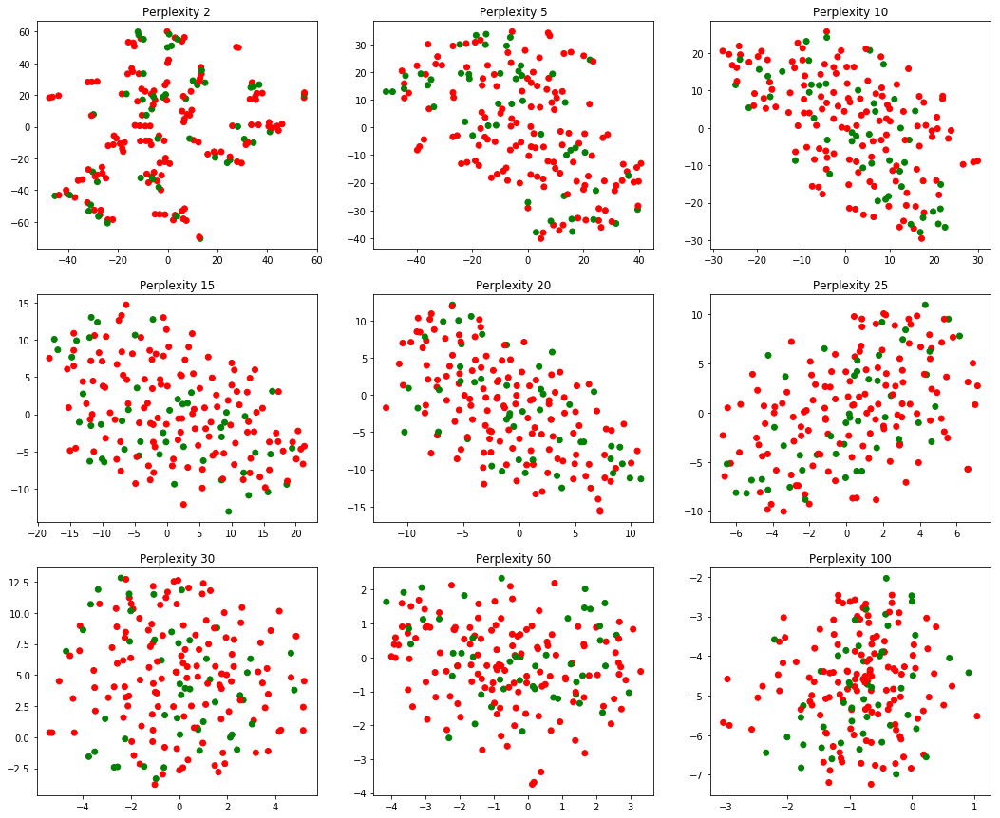

In [581]:
tsne_plots_multiple_perplexities(all_datasets[('s5', GAMEPRES_BUTTONPRESS, 'all', 1, True)], behavior_data['s5'], 
                 plot_gamble=True, n=None)  

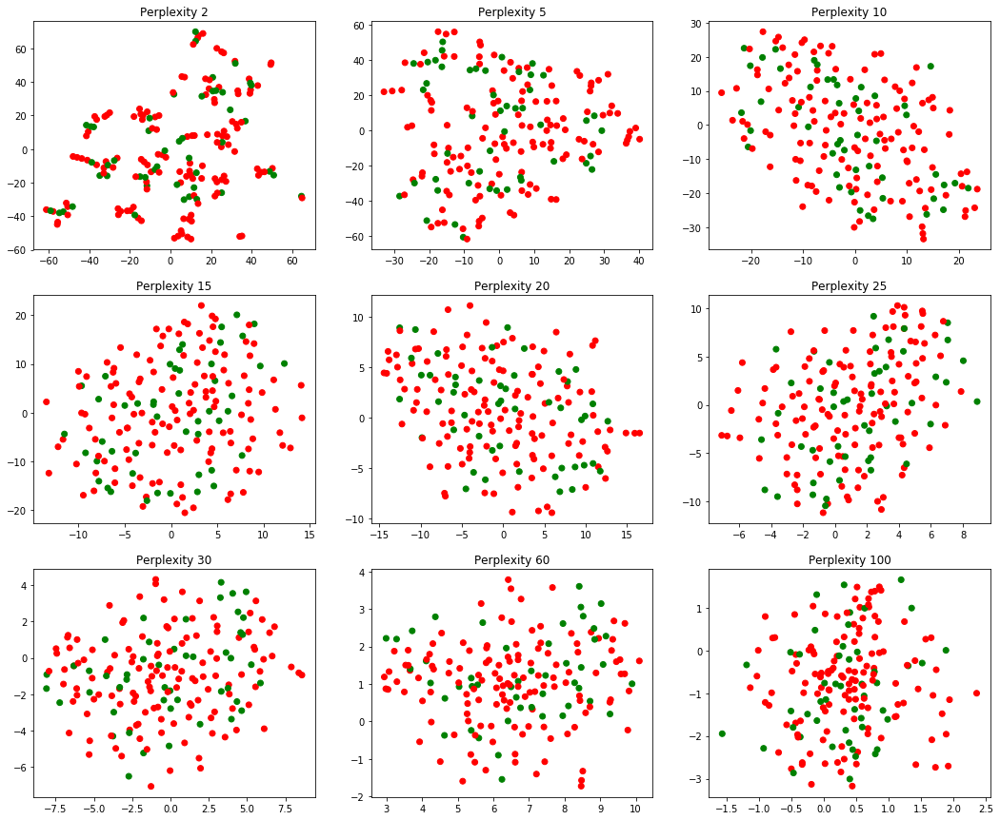

In [582]:
tsne_plots_multiple_perplexities(all_datasets[('s5', GAMEPRES_BUTTONPRESS, 'all', 2, True)], behavior_data['s5'], 
                 plot_gamble=True, n=None)  

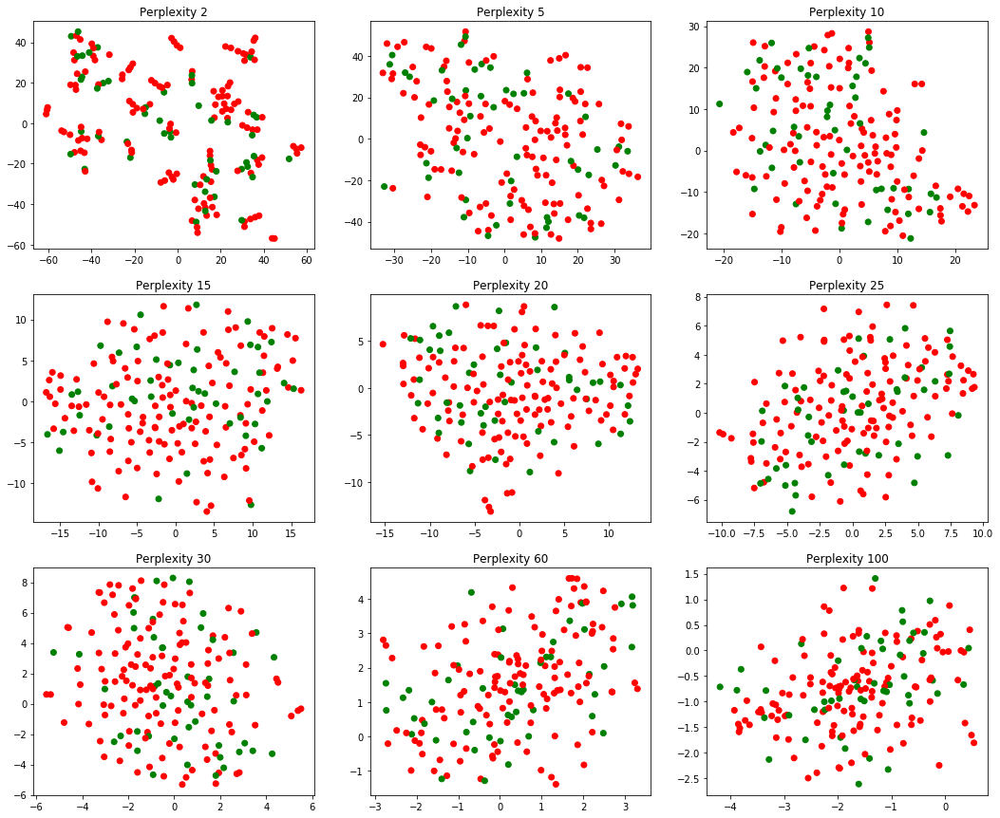

In [583]:
tsne_plots_multiple_perplexities(all_datasets[('s5', GAMEPRES_BUTTONPRESS, 'all', 3, True)], behavior_data['s5'], 
                 plot_gamble=True, n=None)  

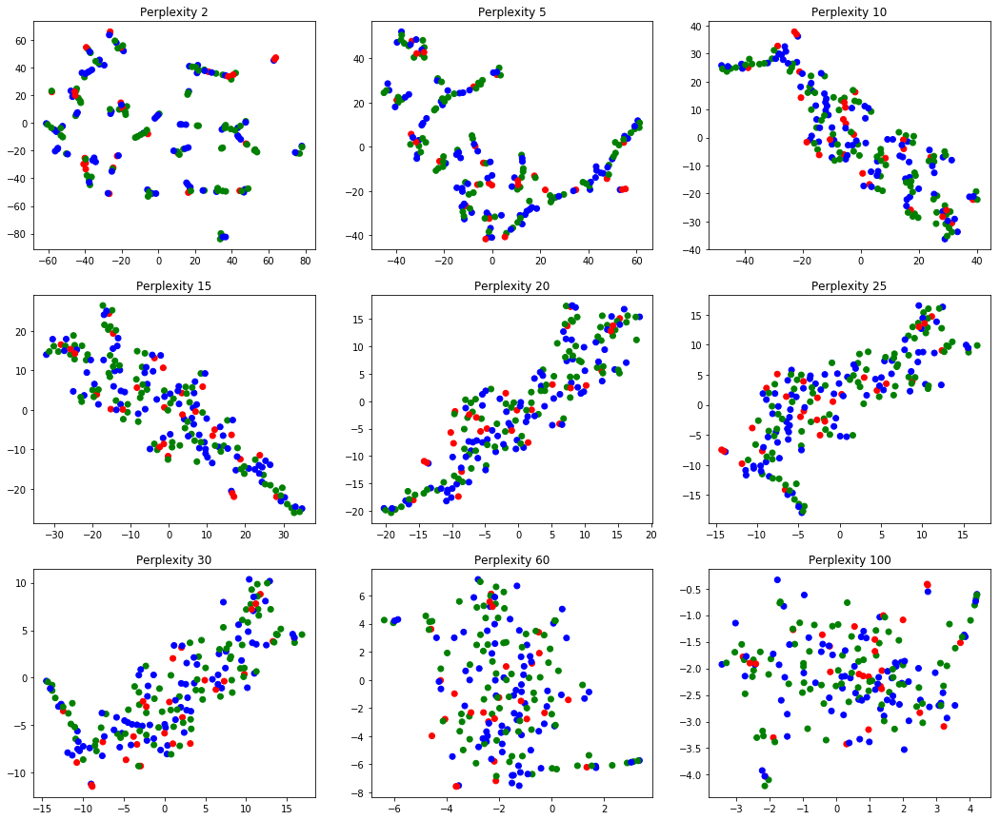

In [612]:
tsne_plots_multiple_perplexities(all_datasets[('s6', '1.5s after outcome reveal', 'all', 1, True)], behavior_data['s6'],
                                 plot_loss_win=True, plot_trials=True, n=None)  

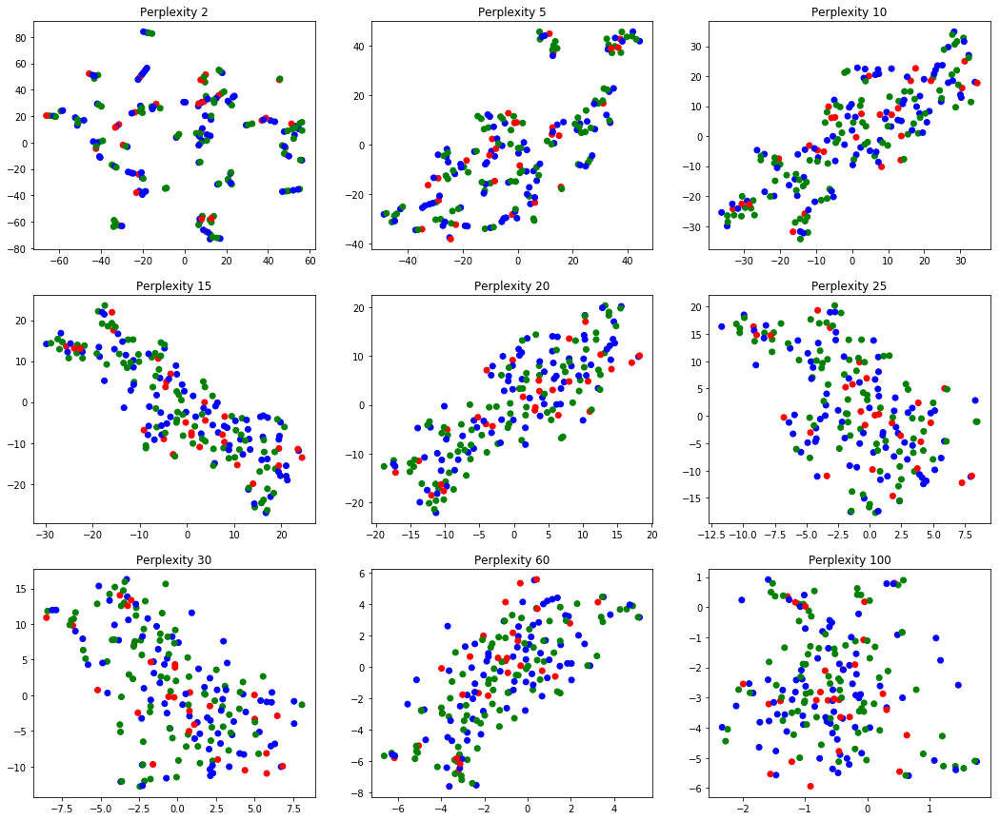

In [613]:
tsne_plots_multiple_perplexities(all_datasets[('s6', '1.5s after outcome reveal', 'all', 2, True)], behavior_data['s6'], 
                                 plot_loss_win=True, plot_trials=True, n=None)  

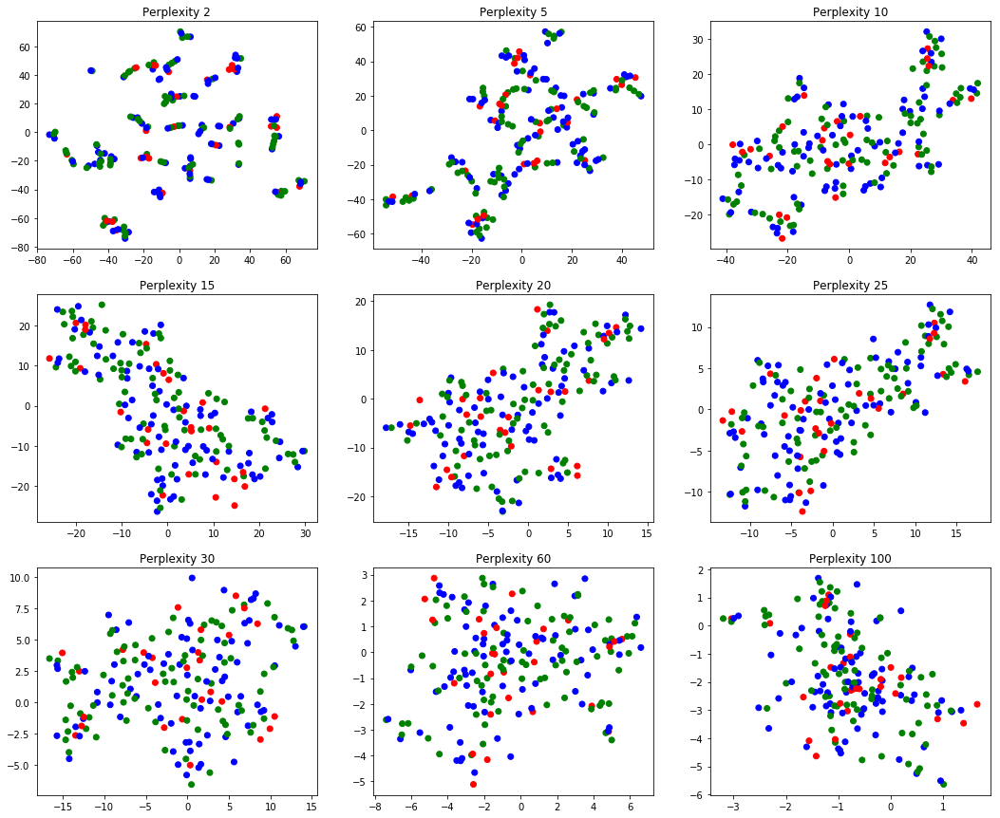

In [586]:
tsne_plots_multiple_perplexities(all_datasets[('s6', '1.5s after outcome reveal', 'all', 3, True)], behavior_data['s6'], 
                                 plot_loss_win=True, plot_trials=True, n=None)  

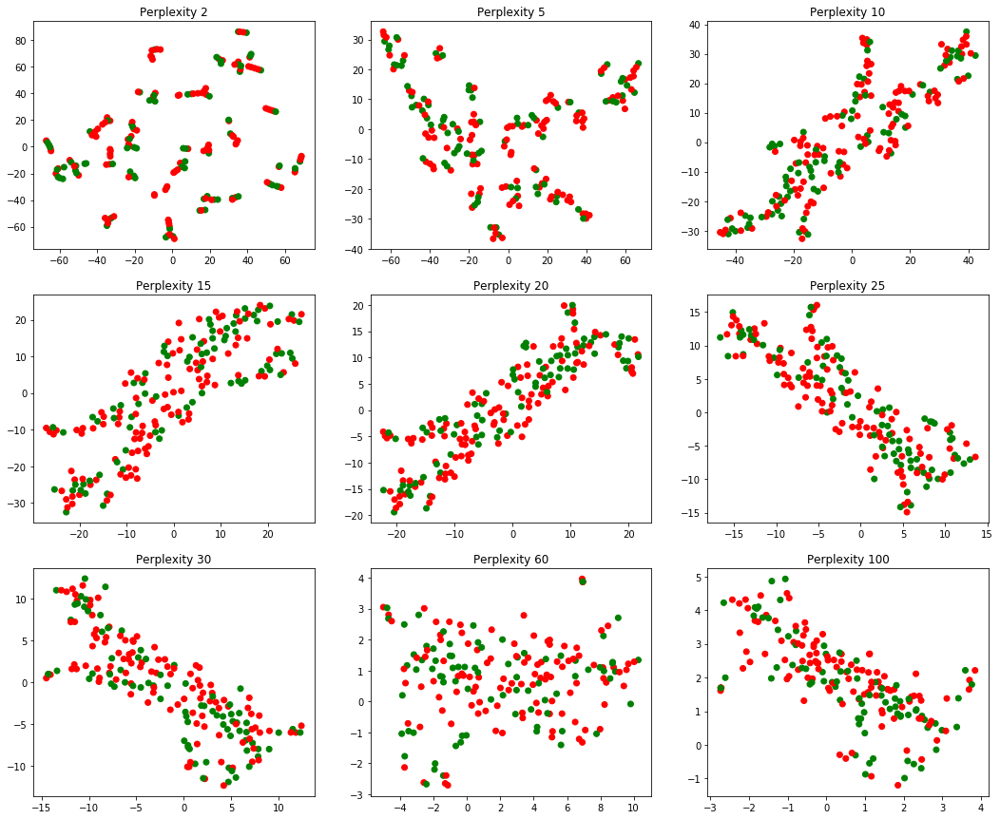

In [587]:
tsne_plots_multiple_perplexities(all_datasets[('s6', GAMEPRES_BUTTONPRESS, 'all', 1, True)], behavior_data['s6'], 
                 plot_gamble=True, n=None)  

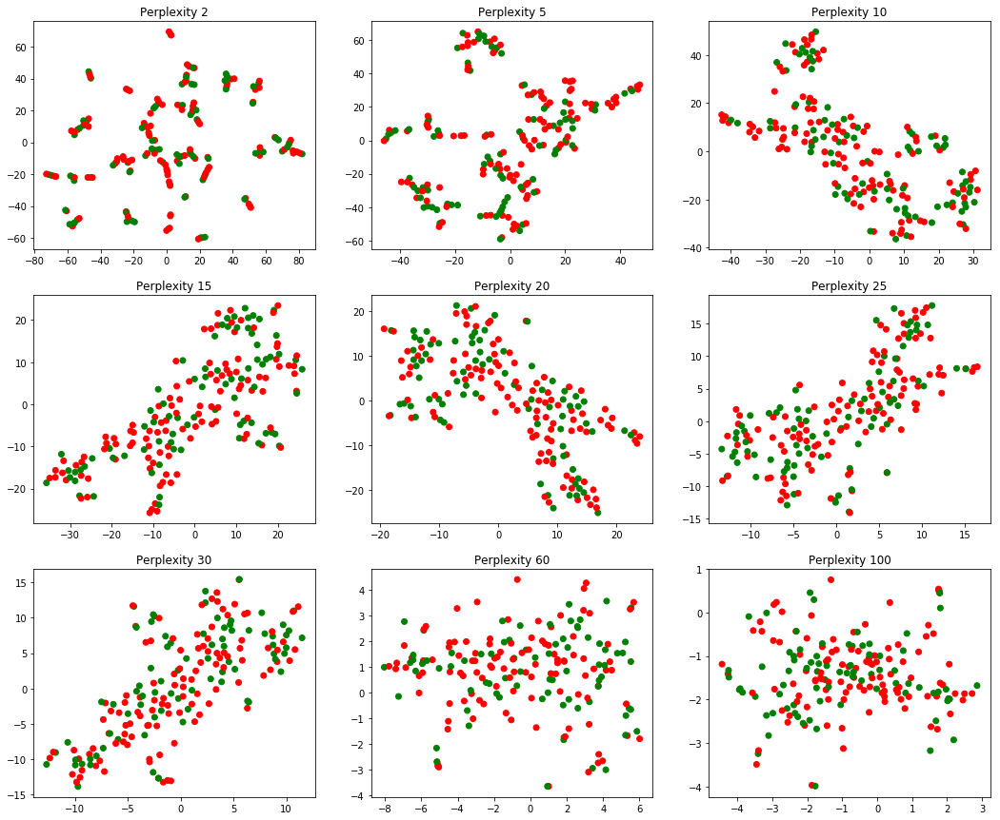

In [588]:
tsne_plots_multiple_perplexities(all_datasets[('s6', GAMEPRES_BUTTONPRESS, 'all', 2, True)], behavior_data['s6'], 
                 plot_gamble=True, n=None)  

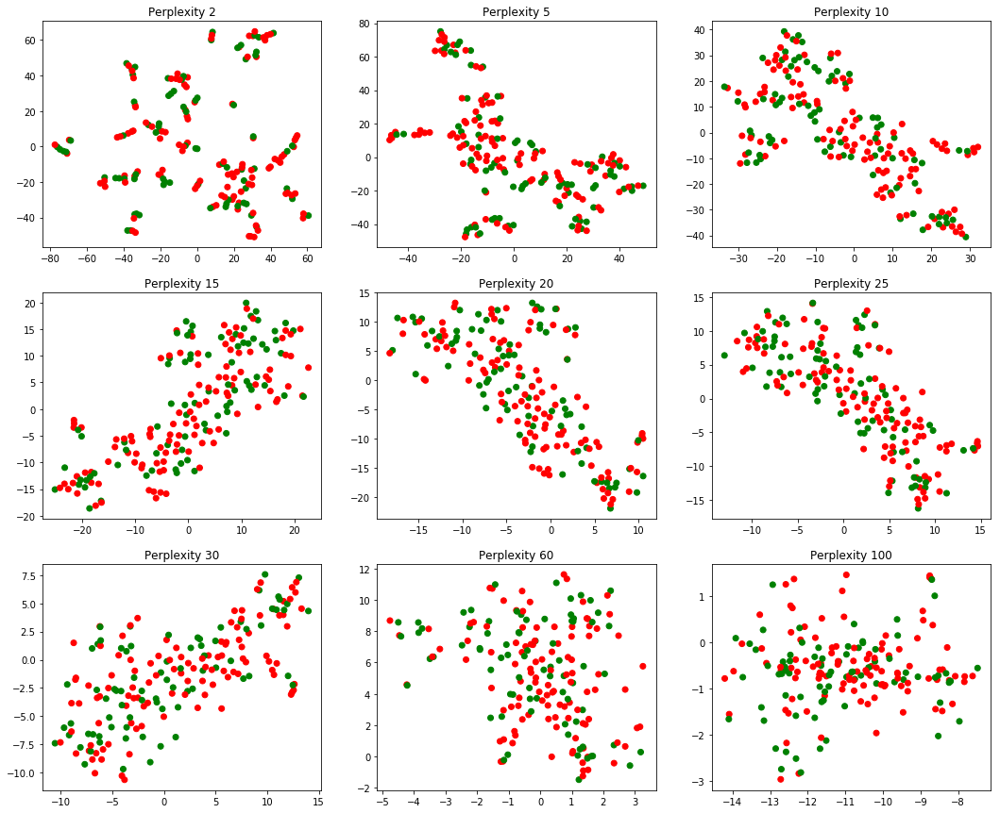

In [589]:
tsne_plots_multiple_perplexities(all_datasets[('s6', GAMEPRES_BUTTONPRESS, 'all', 3, True)], behavior_data['s6'], 
                 plot_gamble=True, n=None)  

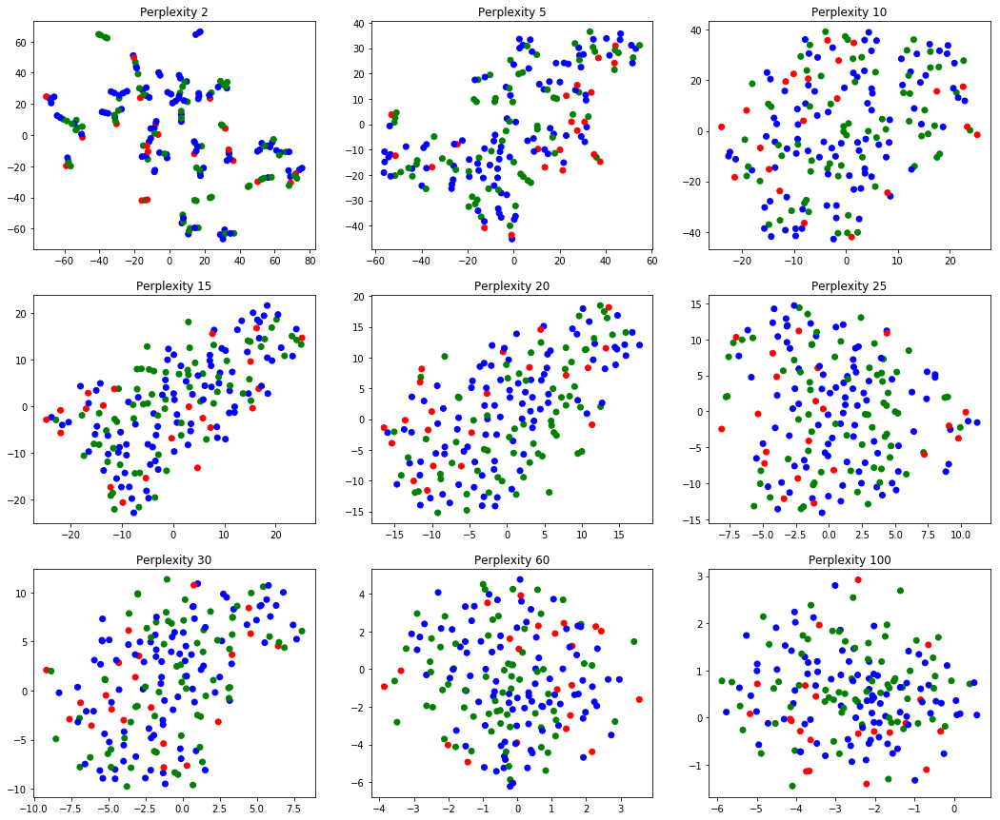

In [614]:
tsne_plots_multiple_perplexities(all_datasets[('s7', '1.5s after outcome reveal', 'all', 1, True)], behavior_data['s7'],
                 plot_trials=True, plot_loss_win=True, n=None)  

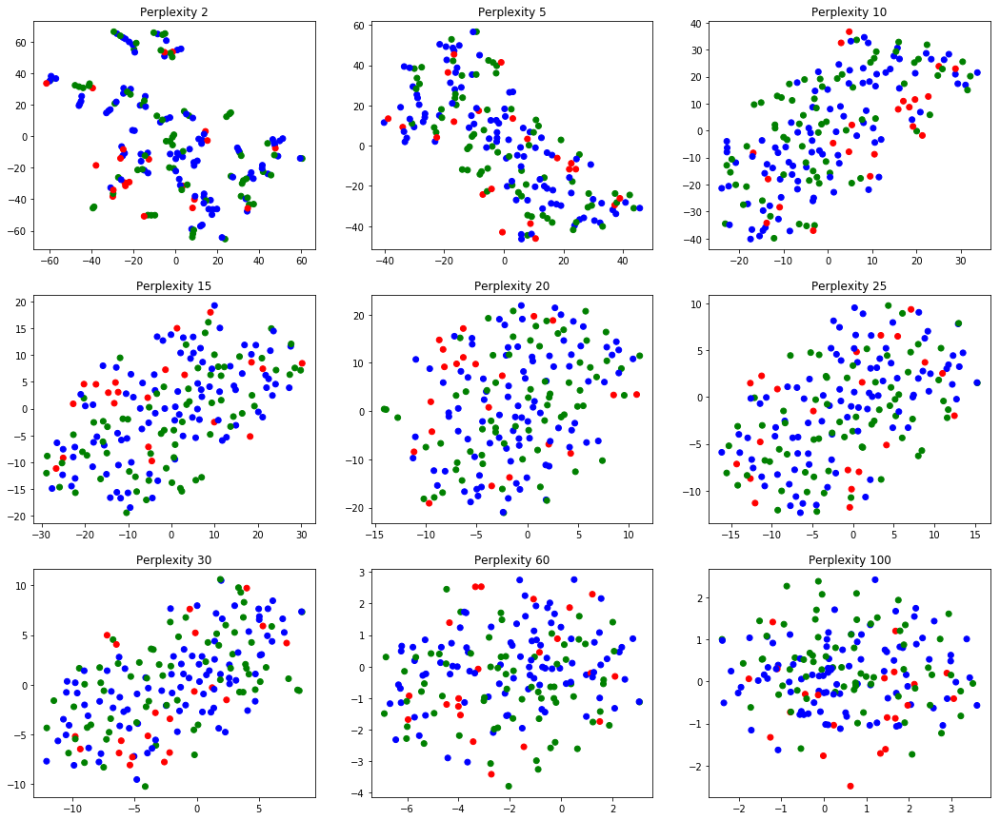

In [591]:
tsne_plots_multiple_perplexities(all_datasets[('s7', '1.5s after outcome reveal', 'all', 2, True)], behavior_data['s7'], 
                                 plot_loss_win=True, plot_trials=True, n=None)  

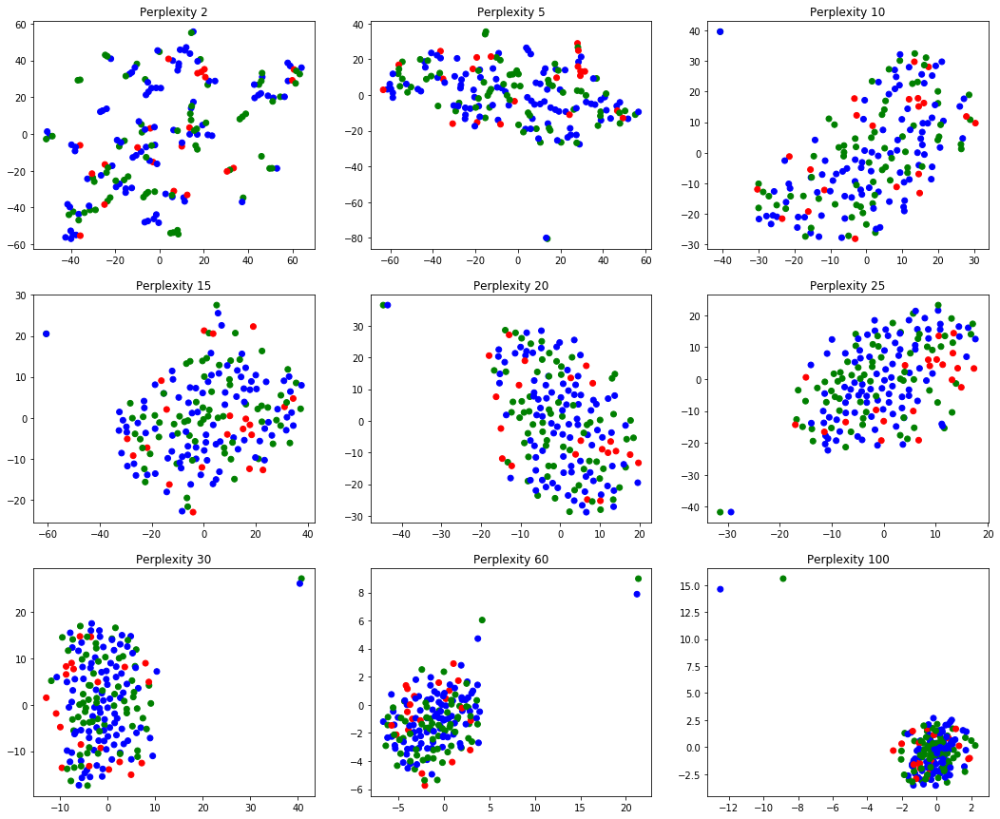

In [592]:
tsne_plots_multiple_perplexities(all_datasets[('s7', '1.5s after outcome reveal', 'all', 3, True)], behavior_data['s7'], plot_loss_win=True,
                 plot_trials=True, n=None)  

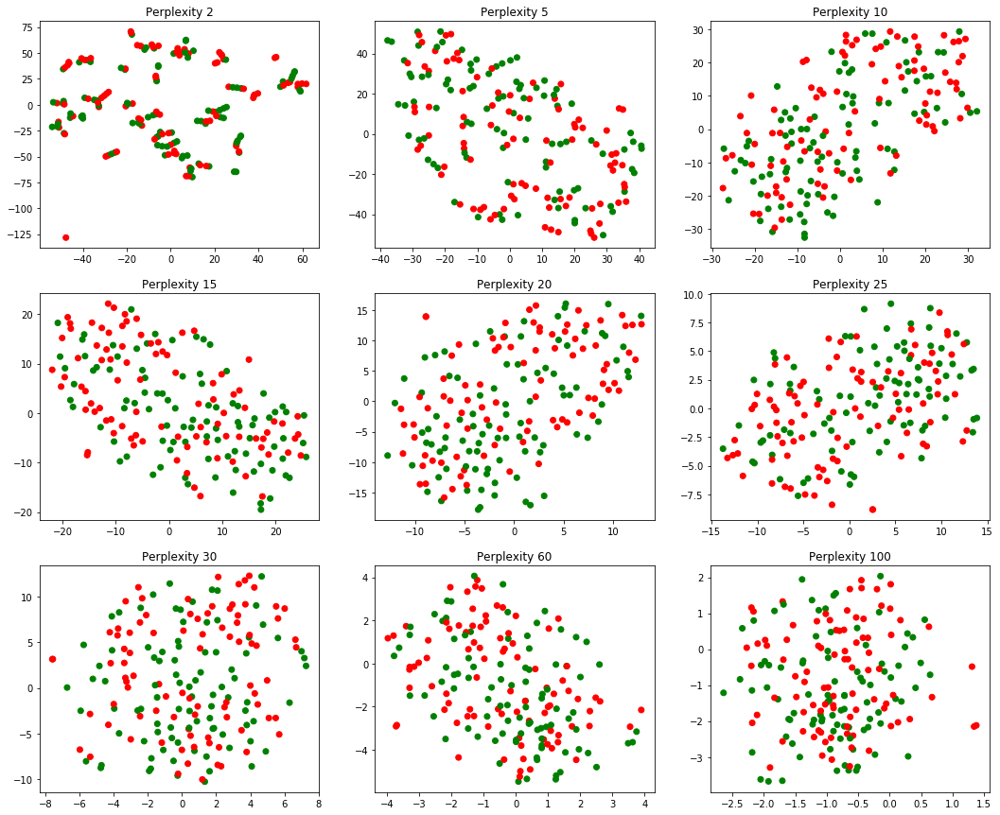

In [593]:
tsne_plots_multiple_perplexities(all_datasets[('s7', GAMEPRES_BUTTONPRESS, 'all', 1, True)], behavior_data['s7'], 
                 plot_gamble=True, n=None)  

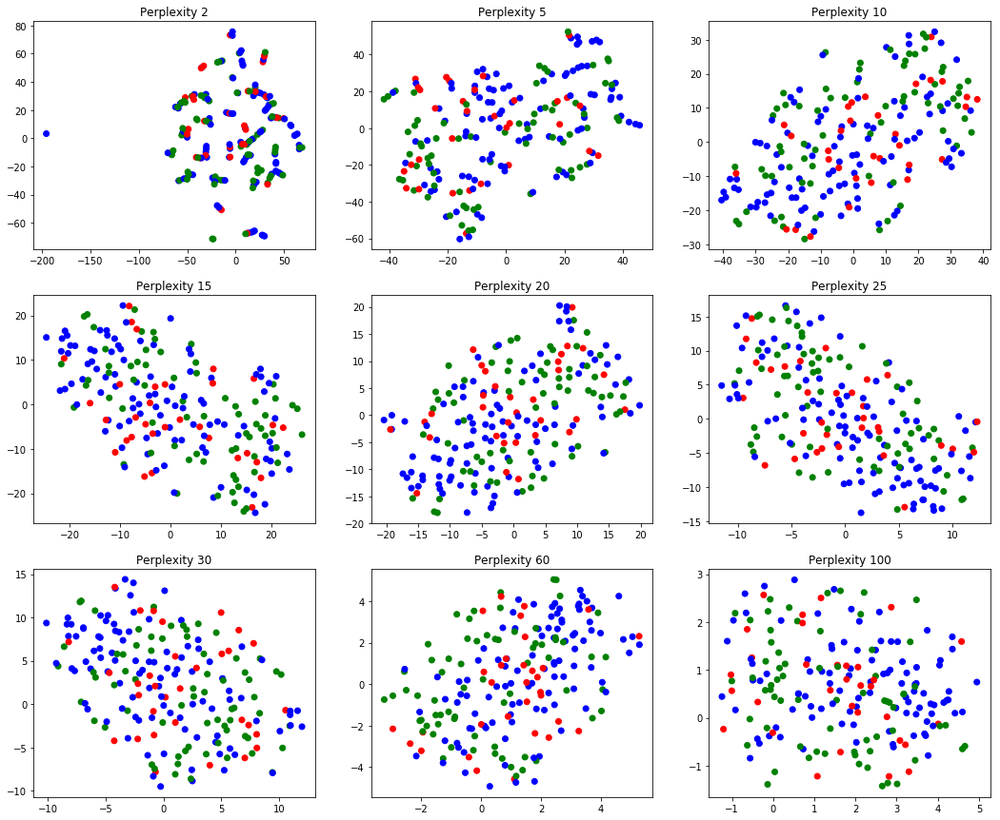

In [615]:
tsne_plots_multiple_perplexities(all_datasets[('s8', '1.5s after outcome reveal', 'all', 1, True)], behavior_data['s8'],
                                 plot_loss_win=True, plot_trials=True, n=None)  

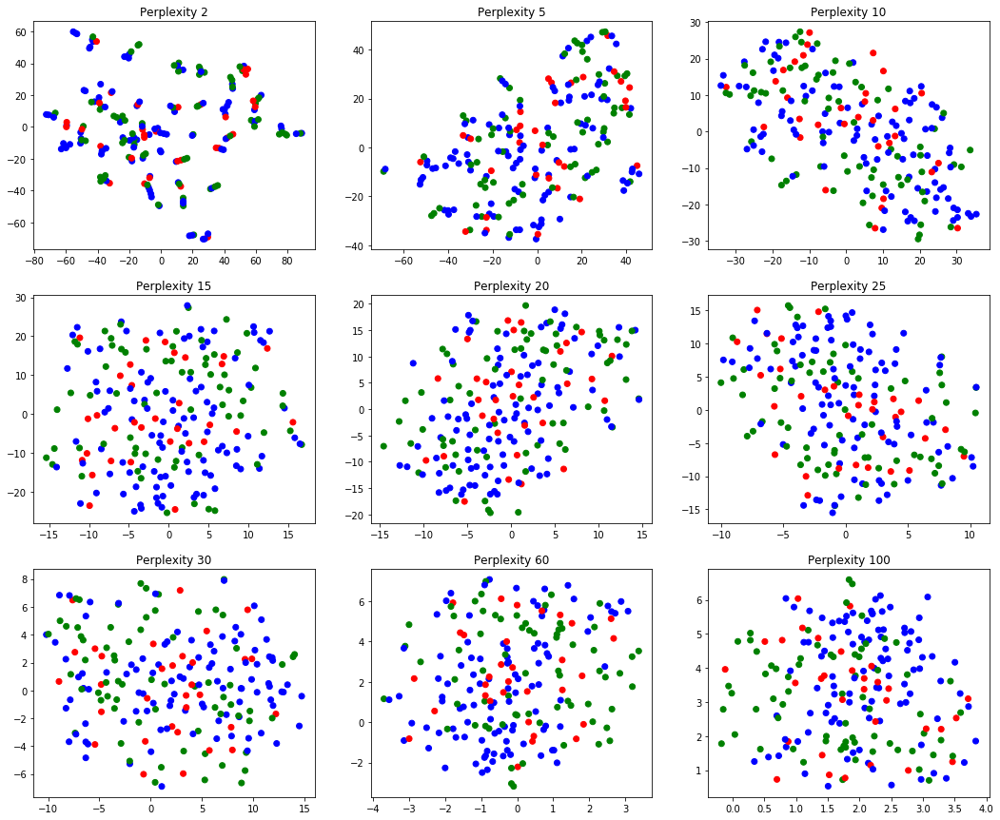

In [595]:
tsne_plots_multiple_perplexities(all_datasets[('s8', '1.5s after outcome reveal', 'all', 2, True)], behavior_data['s8'], plot_loss_win=True,
                 plot_trials=True, n=None)  

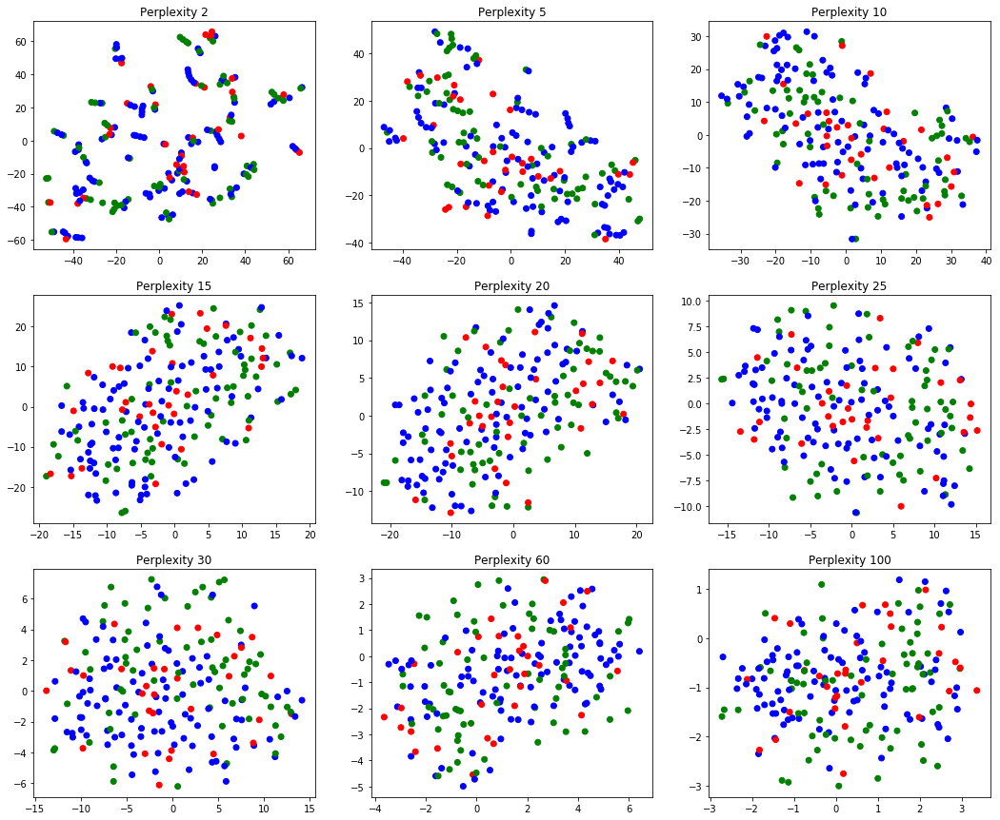

In [596]:
tsne_plots_multiple_perplexities(all_datasets[('s8', '1.5s after outcome reveal', 'all', 3, True)], behavior_data['s8'], 
                                 plot_loss_win=True, plot_trials=True, n=None)  

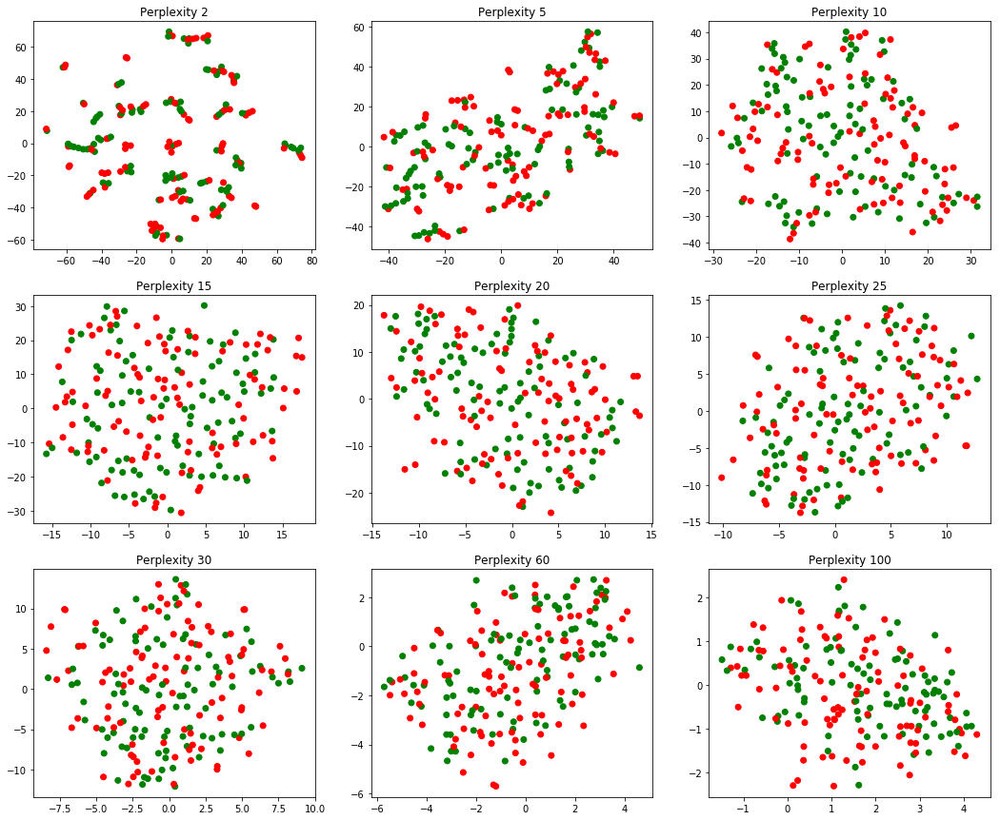

In [597]:
tsne_plots_multiple_perplexities(all_datasets[('s8', GAMEPRES_BUTTONPRESS, 'all', 1, True)], behavior_data['s8'], 
                 plot_gamble=True, n=None)  

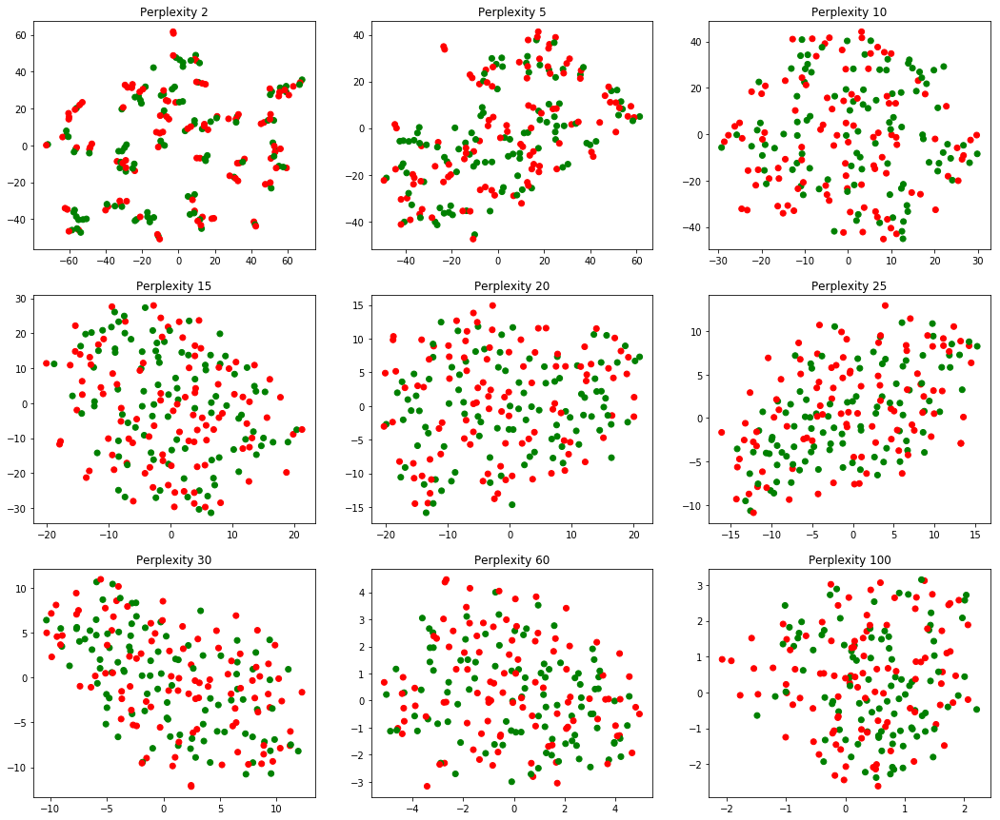

In [598]:
tsne_plots_multiple_perplexities(all_datasets[('s8', GAMEPRES_BUTTONPRESS, 'all', 2, True)], behavior_data['s8'], 
                 plot_gamble=True, n=None)  

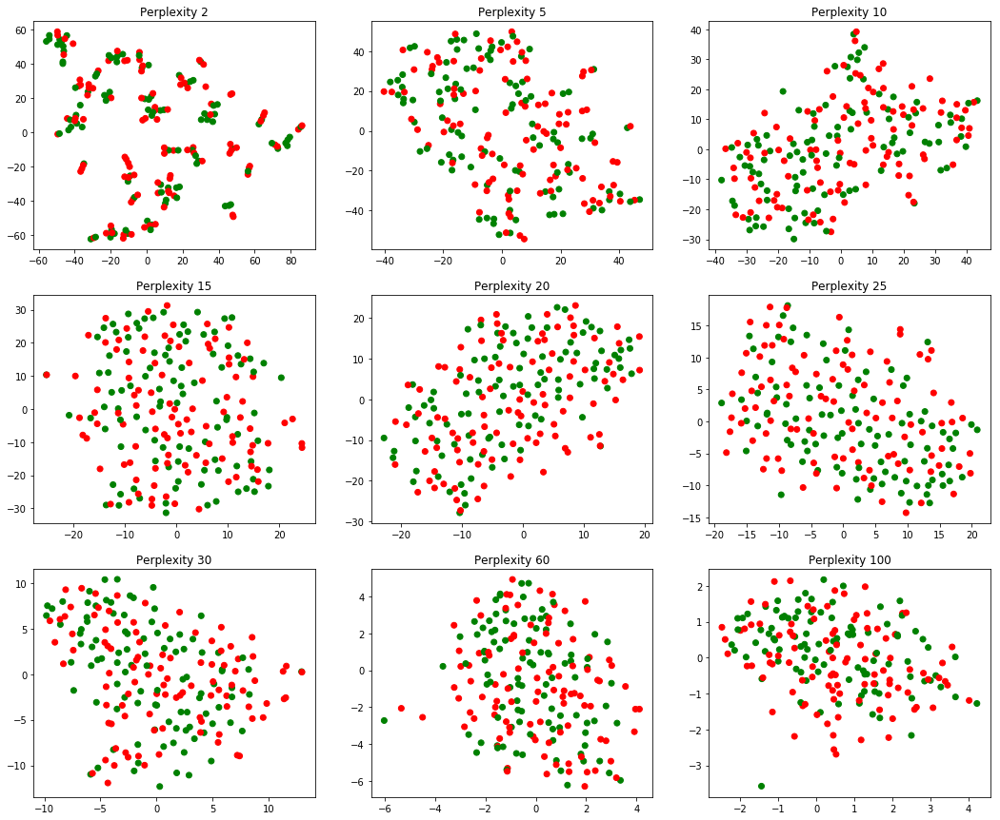

In [599]:
tsne_plots_multiple_perplexities(all_datasets[('s8', GAMEPRES_BUTTONPRESS, 'all', 3, True)], behavior_data['s8'], 
                 plot_gamble=True, n=None)  

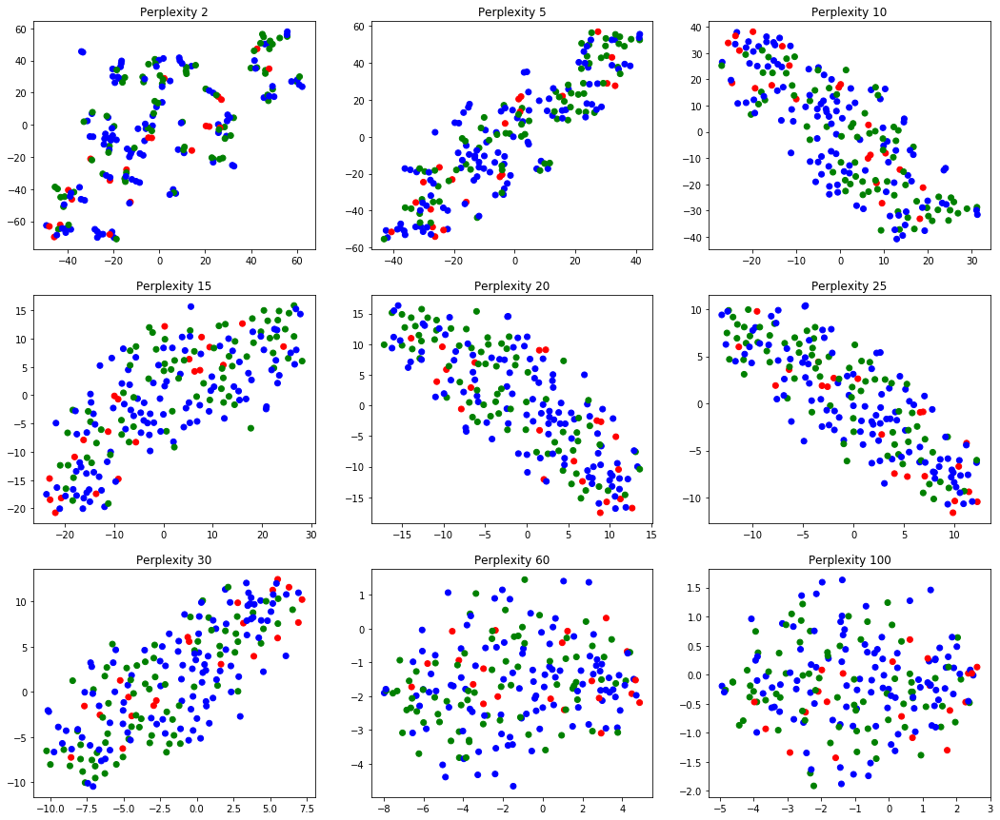

In [616]:
tsne_plots_multiple_perplexities(all_datasets[('s9', '1.5s after outcome reveal', 'all', 1, True)], behavior_data['s9'],
                                 plot_loss_win=True, plot_trials=True, n=None)  

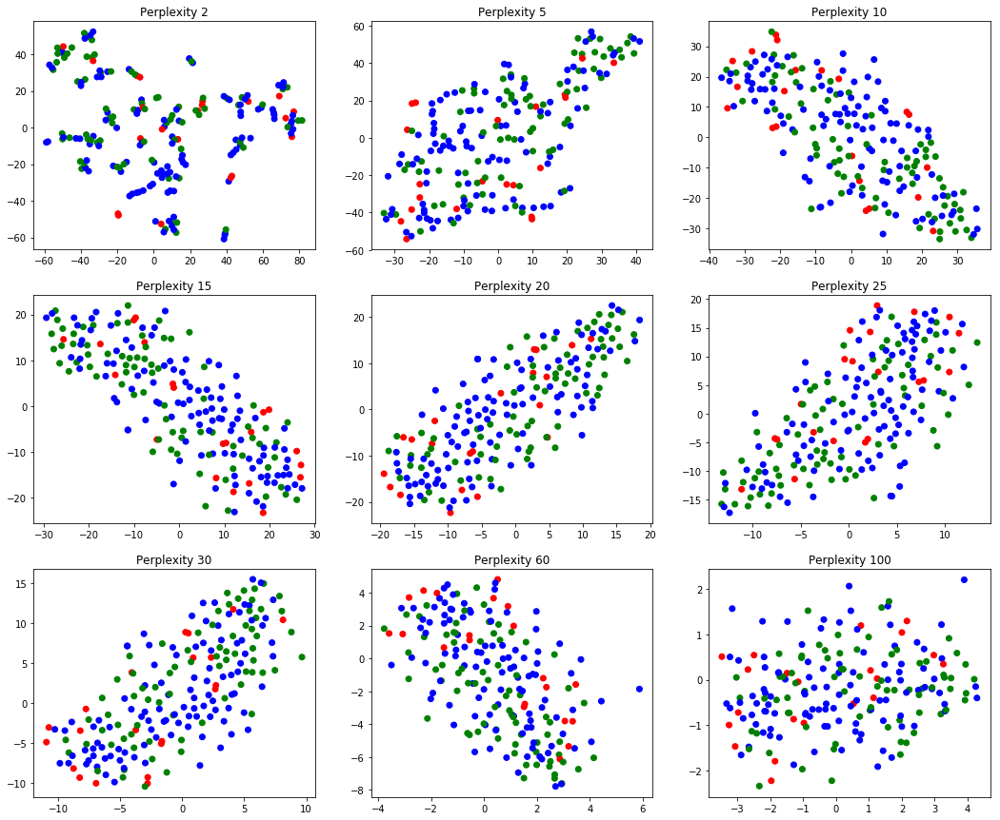

In [601]:
tsne_plots_multiple_perplexities(all_datasets[('s9', '1.5s after outcome reveal', 'all', 2, True)], behavior_data['s9'], plot_loss_win=True,
                 plot_trials=True, n=None)  

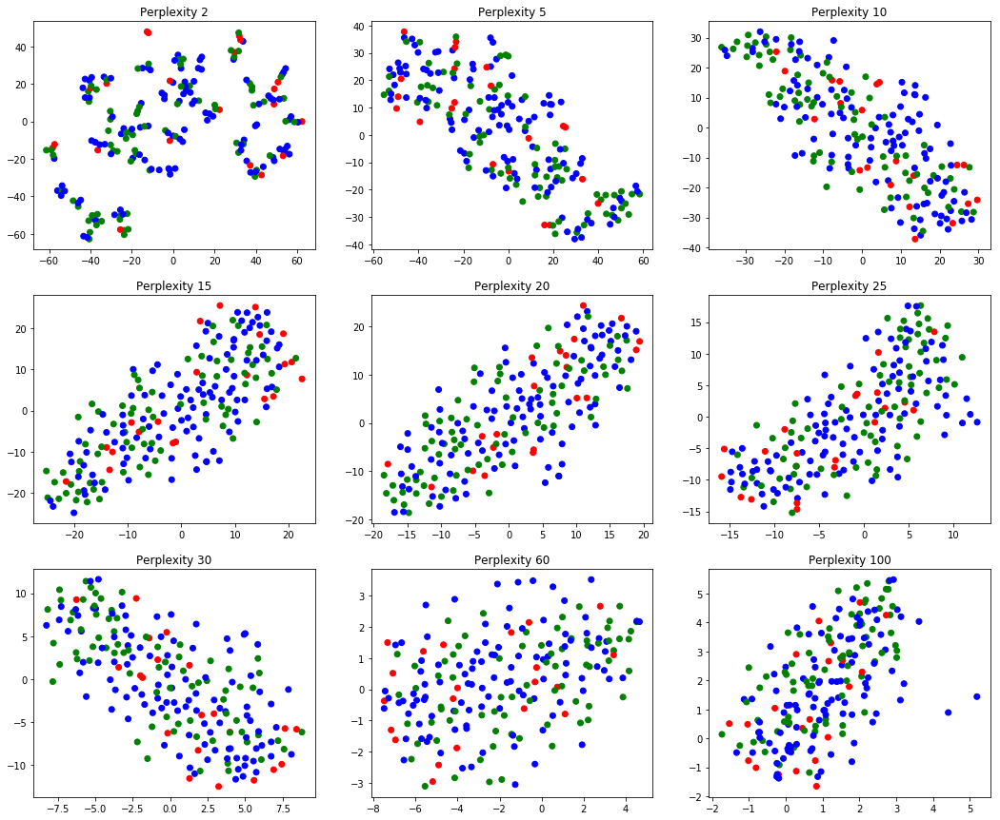

In [602]:
tsne_plots_multiple_perplexities(all_datasets[('s9', '1.5s after outcome reveal', 'all', 3, True)], behavior_data['s9'], plot_loss_win=True,
                 plot_trials=True, n=None)  

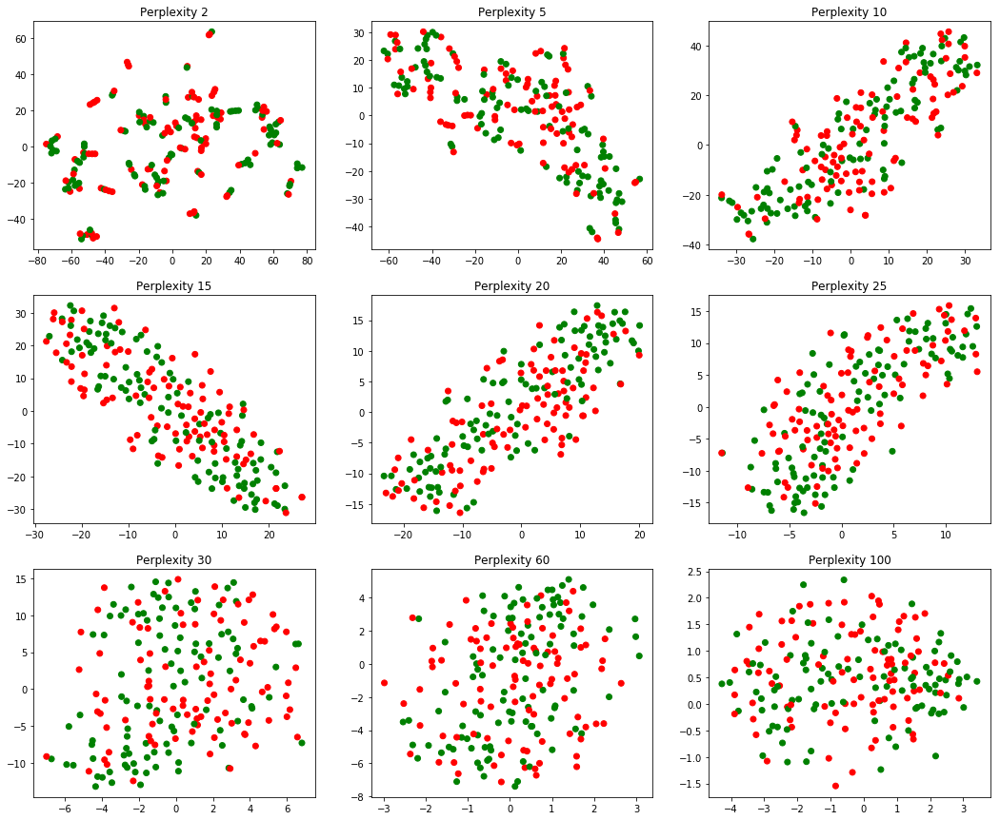

In [603]:
tsne_plots_multiple_perplexities(all_datasets[('s9', GAMEPRES_BUTTONPRESS, 'all', 1, True)], behavior_data['s9'], 
                 plot_gamble=True, n=None)  

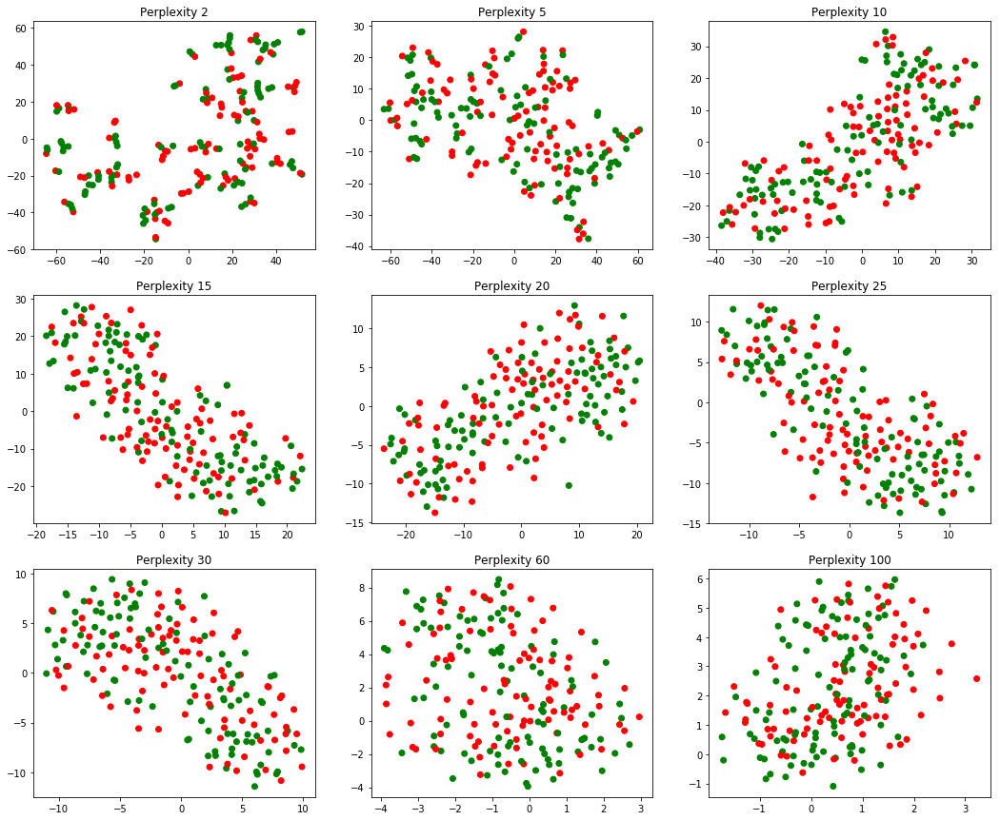

In [604]:
tsne_plots_multiple_perplexities(all_datasets[('s9', GAMEPRES_BUTTONPRESS, 'all', 2, True)], behavior_data['s9'], 
                 plot_gamble=True, n=None)  

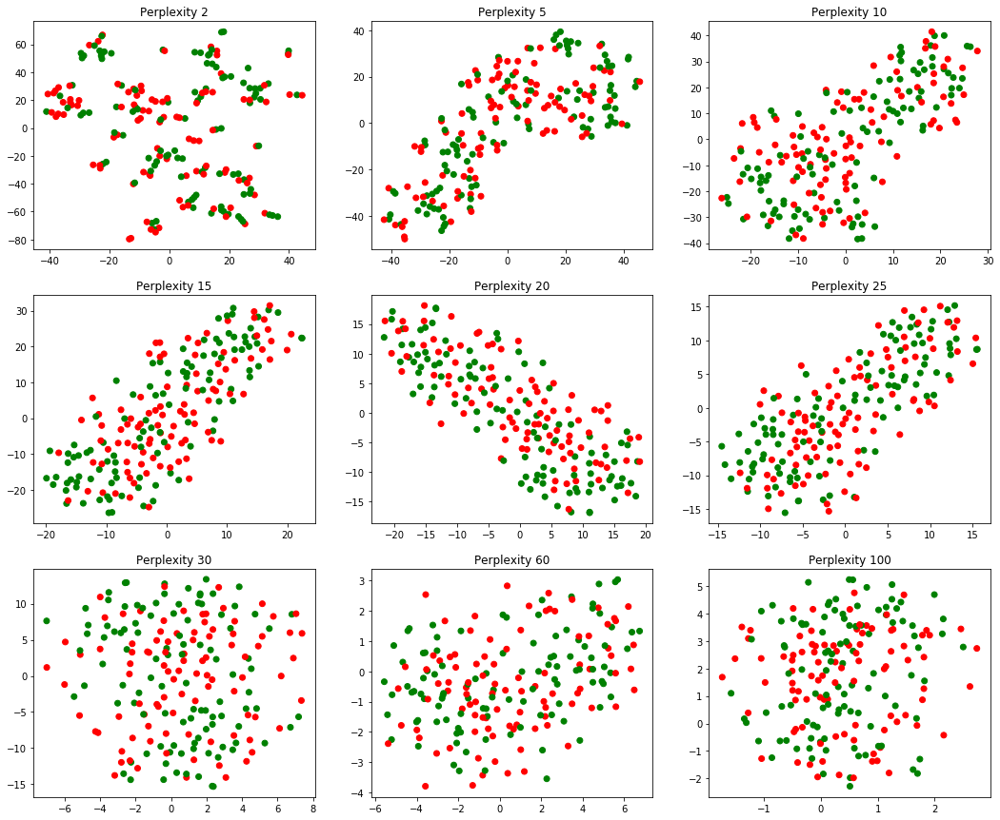

In [605]:
tsne_plots_multiple_perplexities(all_datasets[('s9', GAMEPRES_BUTTONPRESS, 'all', 3, True)], behavior_data['s9'], 
                 plot_gamble=True, n=None)  

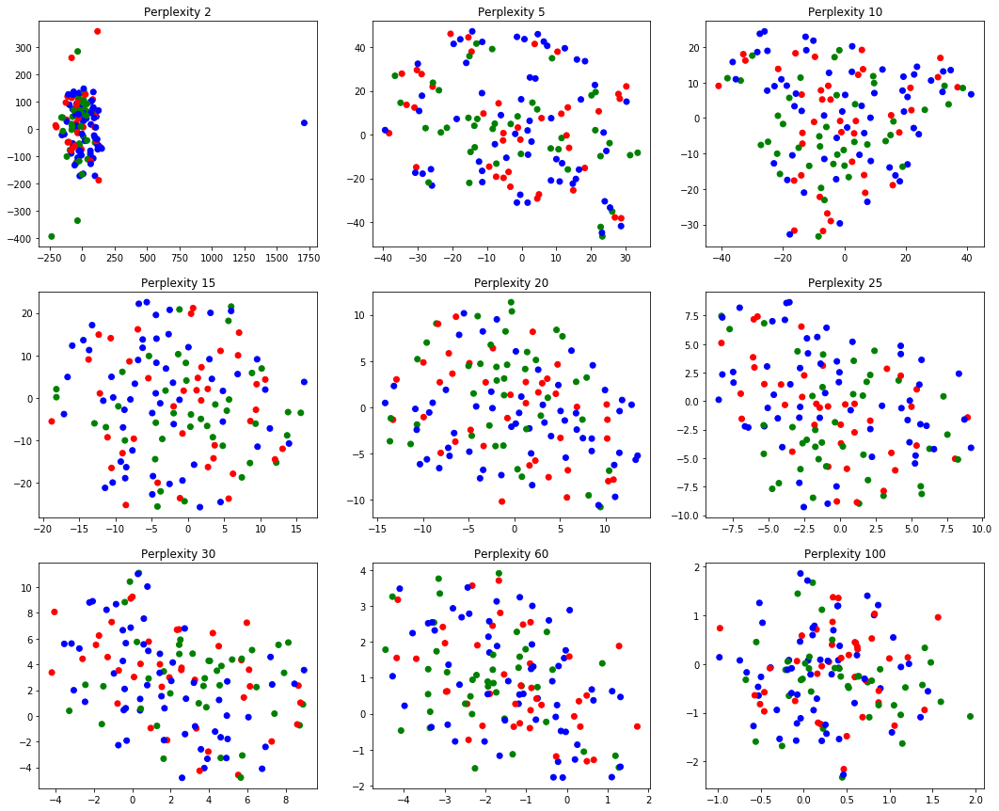

In [617]:
tsne_plots_multiple_perplexities(all_datasets[('s10', '1.5s after outcome reveal', 'all', 1, True)], behavior_data['s10'],
                 plot_loss_win=True, plot_trials=True, n=None)  

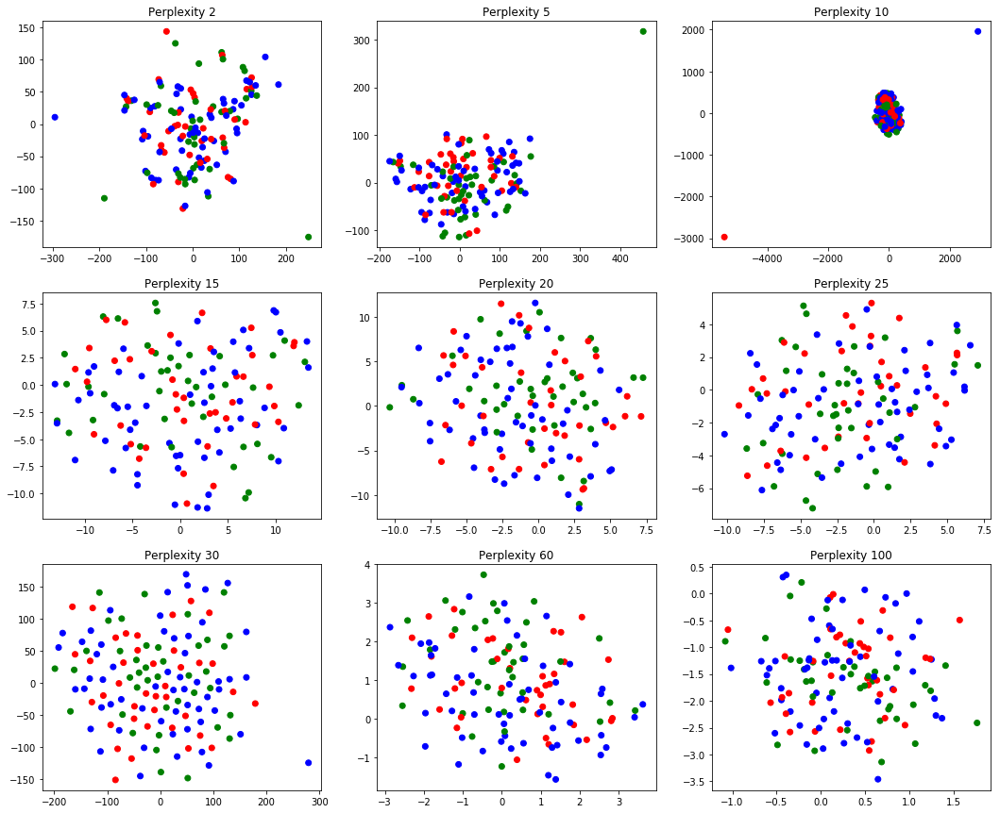

In [607]:
tsne_plots_multiple_perplexities(all_datasets[('s10', '1.5s after outcome reveal', 'all', 2, True)], behavior_data['s10'], plot_loss_win=True,
                 plot_trials=True, n=None)  

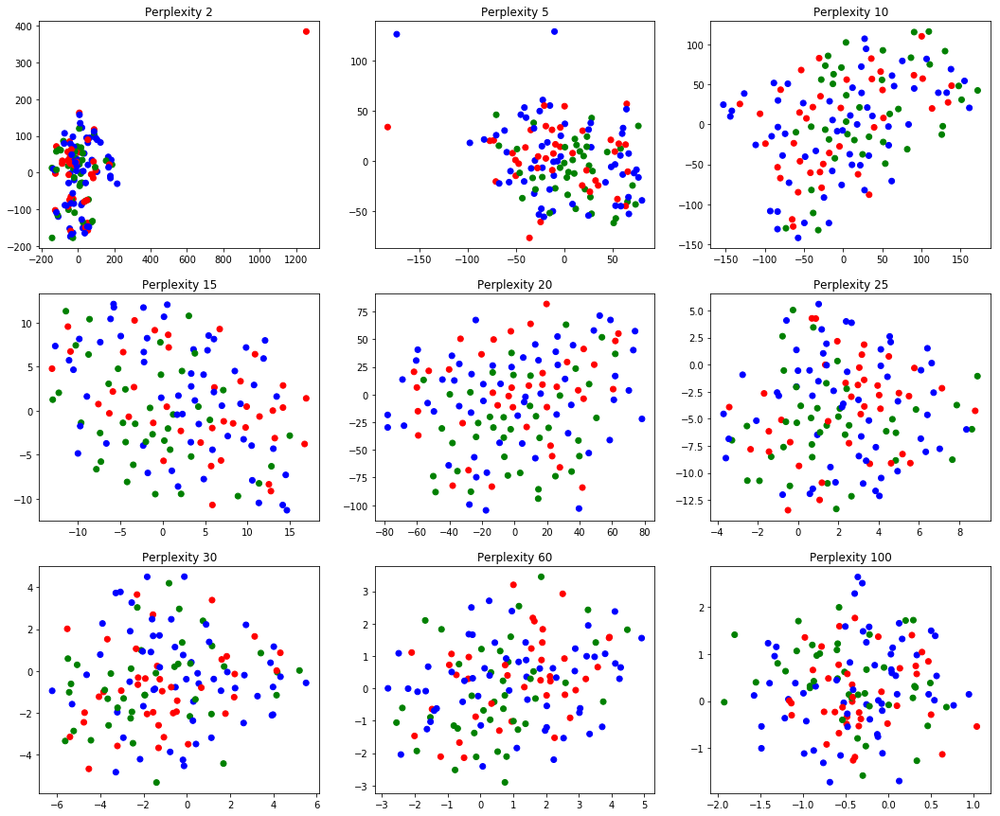

In [608]:
tsne_plots_multiple_perplexities(all_datasets[('s10', '1.5s after outcome reveal', 'all', 3, True)], behavior_data['s10'], plot_loss_win=True,
                 plot_trials=True, n=None)  

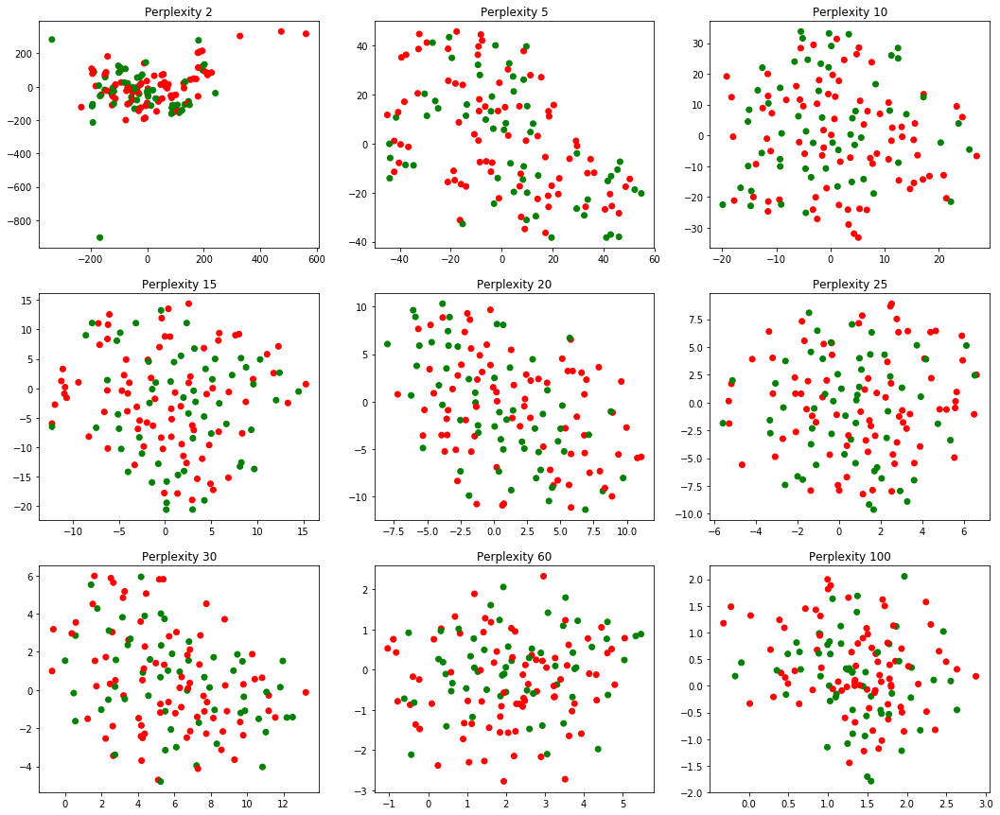

In [609]:
tsne_plots_multiple_perplexities(all_datasets[('s10', GAMEPRES_BUTTONPRESS, 'all', 1, True)], behavior_data['s10'], 
                 plot_gamble=True, n=None)  

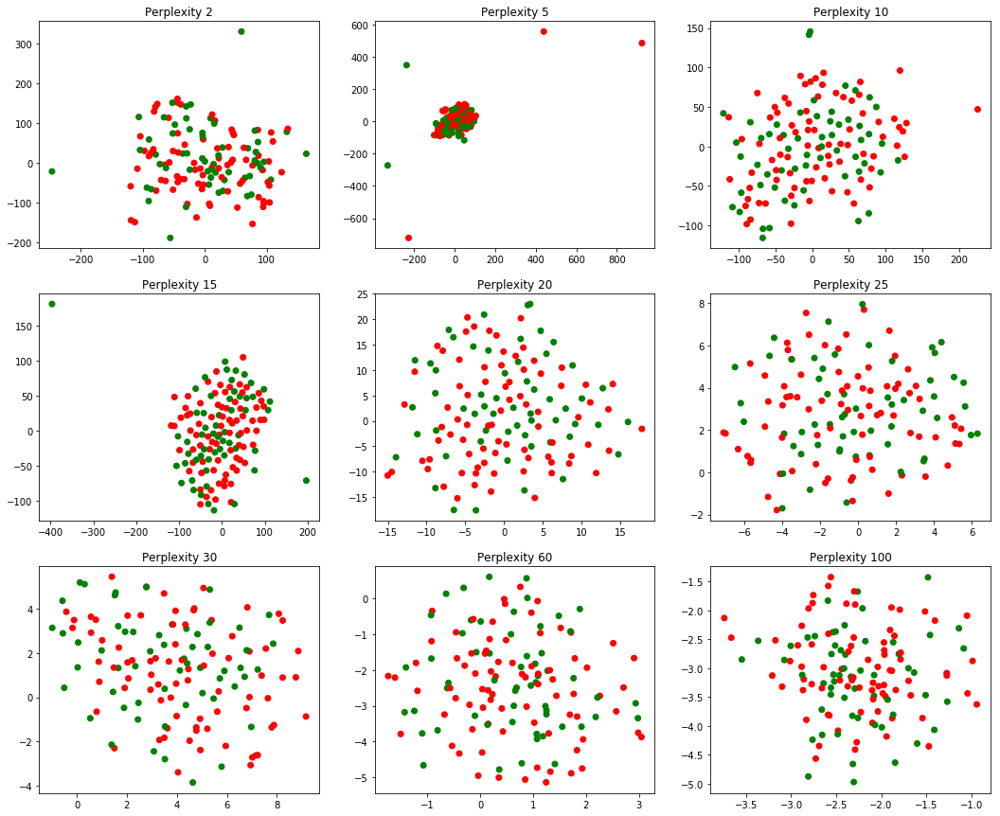

In [610]:
tsne_plots_multiple_perplexities(all_datasets[('s10', GAMEPRES_BUTTONPRESS, 'all', 2, True)], behavior_data['s10'], 
                 plot_gamble=True, n=None)  

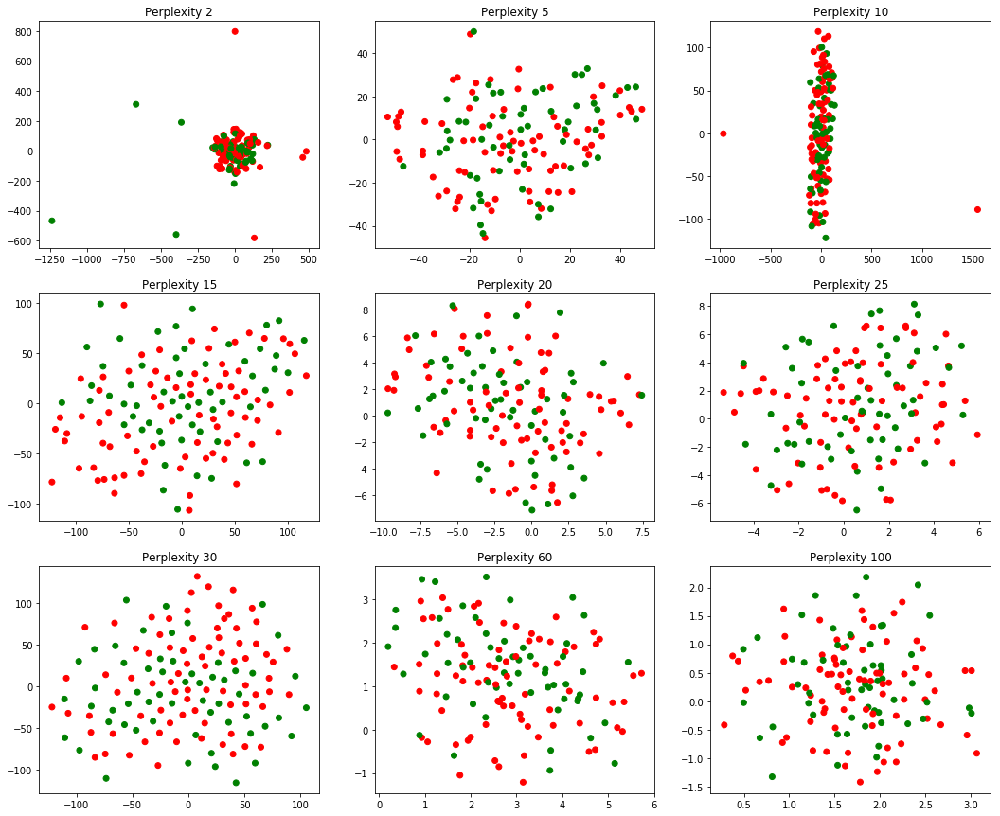

In [611]:
tsne_plots_multiple_perplexities(all_datasets[('s10', GAMEPRES_BUTTONPRESS, 'all', 3, True)], behavior_data['s10'], 
                 plot_gamble=True, n=None)  